<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Classification-of-Telescopic-data-using-Machine-learners" data-toc-modified-id="Classification-of-Telescopic-data-using-Machine-learners-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Classification of Telescopic data using Machine learners</a></span><ul class="toc-item"><li><span><a href="#Reading-data" data-toc-modified-id="Reading-data-1.1"><span class="toc-item-num">1.1&nbsp;&nbsp;</span>Reading data</a></span></li><li><span><a href="#Data-processing" data-toc-modified-id="Data-processing-1.2"><span class="toc-item-num">1.2&nbsp;&nbsp;</span>Data processing</a></span><ul class="toc-item"><li><span><a href="#DATA-distribution" data-toc-modified-id="DATA-distribution-1.2.1"><span class="toc-item-num">1.2.1&nbsp;&nbsp;</span>DATA distribution</a></span></li><li><span><a href="#Class-Distribution" data-toc-modified-id="Class-Distribution-1.2.2"><span class="toc-item-num">1.2.2&nbsp;&nbsp;</span>Class Distribution</a></span></li><li><span><a href="#Creating-timeseries" data-toc-modified-id="Creating-timeseries-1.2.3"><span class="toc-item-num">1.2.3&nbsp;&nbsp;</span>Creating timeseries</a></span></li></ul></li><li><span><a href="#Classifier-Tuning/-Evaluation-Metric" data-toc-modified-id="Classifier-Tuning/-Evaluation-Metric-1.3"><span class="toc-item-num">1.3&nbsp;&nbsp;</span>Classifier Tuning/ Evaluation Metric</a></span><ul class="toc-item"><li><span><a href="#Test(timeseries-full-featureset)" data-toc-modified-id="Test(timeseries-full-featureset)-1.3.1"><span class="toc-item-num">1.3.1&nbsp;&nbsp;</span>Test(timeseries full featureset)</a></span></li><li><span><a href="#Confusion-matrix-of-best-classifier-on-random-test-set" data-toc-modified-id="Confusion-matrix-of-best-classifier-on-random-test-set-1.3.2"><span class="toc-item-num">1.3.2&nbsp;&nbsp;</span>Confusion matrix of best classifier on random test set</a></span></li><li><span><a href="#Feature-selection-strategies" data-toc-modified-id="Feature-selection-strategies-1.3.3"><span class="toc-item-num">1.3.3&nbsp;&nbsp;</span>Feature selection strategies</a></span></li><li><span><a href="#PCA" data-toc-modified-id="PCA-1.3.4"><span class="toc-item-num">1.3.4&nbsp;&nbsp;</span>PCA</a></span></li><li><span><a href="#Train-again" data-toc-modified-id="Train-again-1.3.5"><span class="toc-item-num">1.3.5&nbsp;&nbsp;</span>Train again</a></span></li><li><span><a href="#Train-classifiers-on-PCA" data-toc-modified-id="Train-classifiers-on-PCA-1.3.6"><span class="toc-item-num">1.3.6&nbsp;&nbsp;</span>Train classifiers on PCA</a></span></li><li><span><a href="#Light-curve-visualisations" data-toc-modified-id="Light-curve-visualisations-1.3.7"><span class="toc-item-num">1.3.7&nbsp;&nbsp;</span>Light curve visualisations</a></span></li><li><span><a href="#Changing-to-binary-to-identify-SnType1a" data-toc-modified-id="Changing-to-binary-to-identify-SnType1a-1.3.8"><span class="toc-item-num">1.3.8&nbsp;&nbsp;</span>Changing to binary to identify SnType1a</a></span></li><li><span><a href="#MWUA" data-toc-modified-id="MWUA-1.3.9"><span class="toc-item-num">1.3.9&nbsp;&nbsp;</span>MWUA</a></span></li><li><span><a href="#Period-extraction-and-Colour-Index-+-Extra-features" data-toc-modified-id="Period-extraction-and-Colour-Index-+-Extra-features-1.3.10"><span class="toc-item-num">1.3.10&nbsp;&nbsp;</span>Period extraction and Colour Index + Extra features</a></span><ul class="toc-item"><li><span><a href="#period-analysis" data-toc-modified-id="period-analysis-1.3.10.1"><span class="toc-item-num">1.3.10.1&nbsp;&nbsp;</span>period analysis</a></span></li><li><span><a href="#Period,-col_ind,-feature-extraction" data-toc-modified-id="Period,-col_ind,-feature-extraction-1.3.10.2"><span class="toc-item-num">1.3.10.2&nbsp;&nbsp;</span>Period, col_ind, feature extraction</a></span></li></ul></li><li><span><a href="#Normalised-Compression-Distance" data-toc-modified-id="Normalised-Compression-Distance-1.3.11"><span class="toc-item-num">1.3.11&nbsp;&nbsp;</span>Normalised Compression Distance</a></span></li><li><span><a href="#Train-final" data-toc-modified-id="Train-final-1.3.12"><span class="toc-item-num">1.3.12&nbsp;&nbsp;</span>Train final</a></span></li><li><span><a href="#PCA-test-Final" data-toc-modified-id="PCA-test-Final-1.3.13"><span class="toc-item-num">1.3.13&nbsp;&nbsp;</span>PCA test Final</a></span></li><li><span><a href="#Combine-Three-Sne-object-class-classifiers" data-toc-modified-id="Combine-Three-Sne-object-class-classifiers-1.3.14"><span class="toc-item-num">1.3.14&nbsp;&nbsp;</span>Combine Three Sne object class classifiers</a></span></li><li><span><a href="#PCA-AND-DISTRIBUTION-OF-THE-CLASSES" data-toc-modified-id="PCA-AND-DISTRIBUTION-OF-THE-CLASSES-1.3.15"><span class="toc-item-num">1.3.15&nbsp;&nbsp;</span>PCA AND DISTRIBUTION OF THE CLASSES</a></span></li></ul></li></ul></li></ul></div>

# Classification of Telescopic data using Machine learners 


In [1]:

from IPython.core.display import display, HTML
display(HTML("<style>.rendered_html { font-size: 18px; }</style>"))

In this notebook, we go through the standard machine learning techniques combined with astronomical feature extraction methods in order to generate classifiers which are able to classify astronomical transients with high accuracy levels

The main approach to the task is based on the RAMP Supernova starter kit and any code that is directly used from the kit will have the title - "Starter Kit" to distinguish it from my code.

We'll begin by importing some packages that might be useful. 

In [841]:
%matplotlib notebook
%matplotlib inline


import os
from collections import Counter, OrderedDict
import numpy as np
import pandas as pd
import itertools
import lzma
import struct 
from itertools import cycle
from keras.models import Sequential 
from keras.layers import Dense
from gatspy import datasets, periodic
from gatspy.periodic import LombScargleMultiband
from sklearn import svm, datasets
from sklearn import metrics
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import train_test_split
from sklearn import preprocessing
from sklearn.preprocessing import label_binarize
from sklearn.preprocessing import StandardScaler
from sklearn.multiclass import OneVsRestClassifier
from sklearn.model_selection import cross_val_score
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif, RFE
from sklearn.neural_network import MLPClassifier
from scipy import interp
from operator import itemgetter
from mpl_toolkits.mplot3d import Axes3D
import matplotlib as mpl
import matplotlib.pyplot as plt
from astropy.table import Table
import schwimmbad
from cesium.time_series import TimeSeries
import cesium.featurize as featurize
from tqdm import tnrange, tqdm_notebook
import sklearn 
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.decomposition import PCA
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split, StratifiedKFold, GridSearchCV, RandomizedSearchCV, cross_val_score, KFold
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.feature_selection import SelectFromModel
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score, classification_report, roc_auc_score
from sklearn.metrics import classification_report
from sklearn.neighbors import KNeighborsClassifier, KNeighborsRegressor
from sklearn.naive_bayes import MultinomialNB
from sklearn.naive_bayes import GaussianNB
from sklearn import linear_model
import scikitplot as skplt
import seaborn as sns
import time 

## Reading data 

In [358]:
# mapping string names of each passband to an integer ID 
pbmap = OrderedDict([(0,'u'), (1,'g'), (2,'r'), (3,'i'), (4, 'z'), (5, 'y')])

# it also helps to have passbands associated with a color
pbcols = OrderedDict([(0,'blueviolet'), (1,'green'), (2,'red'),\
                      (3,'orange'), (4, 'black'), (5, 'brown')])

pbnames = list(pbmap.values())

Next, we'll read the light curve data. All the objects in the training set are in a single file:

In [1118]:
datadir = 'data'
lcfilename = f'{datadir}/training_set.csv'
lcdata = Table.read(lcfilename, format='csv')
lcdata2 = Table.read(lcfilename, format='csv')
lcdata

object_id,mjd,passband,flux,flux_err,detected
int64,float64,int64,float64,float64,int64
615,59750.4229,2,-544.810303,3.622952,1
615,59750.4306,1,-816.434326,5.55337,1
615,59750.4383,3,-471.385529,3.801213,1
615,59750.445,4,-388.984985,11.395031,1
615,59752.407,2,-681.858887,4.041204,1
615,59752.4147,1,-1061.457031,6.472994,1
615,59752.4224,3,-524.95459,3.552751,1
615,59752.4334,4,-393.480225,3.599346,1
615,59752.4435,5,-355.88678,10.421921,1


In [1074]:
lcdata_df = lcdata.copy().to_pandas()
pd.set_option('display.max_colwidth', 50)

In [371]:
lcdata_df

,object_id,mjd,passband,flux,flux_err,detected
0,615,59750.4229,2,-544.810303,3.622952,1
1,615,59750.4306,1,-816.434326,5.553370,1
2,615,59750.4383,3,-471.385529,3.801213,1
3,615,59750.4450,4,-388.984985,11.395031,1
4,615,59752.4070,2,-681.858887,4.041204,1
5,615,59752.4147,1,-1061.457031,6.472994,1
6,615,59752.4224,3,-524.954590,3.552751,1
7,615,59752.4334,4,-393.480225,3.599346,1
8,615,59752.4435,5,-355.886780,10.421921,1
9,615,59767.2968,2,-548.013550,3.462291,1


Next, we'll read the metadata table.

In [7]:
metafilename = f'{datadir}/training_set_metadata.csv'
metadata = Table.read(metafilename, format='csv')
nobjects = len(metadata)
metadata


object_id,ra,decl,gal_l,gal_b,ddf,hostgal_specz,hostgal_photoz,hostgal_photoz_err,distmod,mwebv,target
int64,float64,float64,float64,float64,int64,float64,float64,float64,float64,float64,int64
615,349.046051,-61.943836,320.79653,-51.753706,1,0.0,0.0,0.0,nan,0.017,92
713,53.085938,-27.784405,223.525509,-54.460748,1,1.8181,1.6267,0.2552,45.4063,0.007,88
730,33.574219,-6.579593,170.455585,-61.548219,1,0.232,0.2262,0.0157,40.2561,0.021,42
745,0.189873,-45.586655,328.254458,-68.969298,1,0.3037,0.2813,1.1523,40.7951,0.007,90
1124,352.711273,-63.823658,316.922299,-51.059403,1,0.1934,0.2415,0.0176,40.4166,0.024,90
1227,35.683594,-5.379379,171.992947,-59.253501,1,0.0,0.0,0.0,nan,0.02,65
1598,347.84671,-64.760857,318.929827,-49.143596,1,0.1352,0.182,0.0304,39.7279,0.019,90
1632,348.595886,-63.07262,320.023289,-50.71306,1,0.6857,0.7014,0.01,43.1524,0.021,42
1920,149.414062,3.433834,234.919132,42.24555,1,0.3088,0.3229,0.336,41.1401,0.027,90


In [8]:
meta_df  = metadata.copy().to_pandas()
meta_df2 = meta_df.copy()

In [9]:
# second dataframe to use the object id and target if needed
meta_df2.set_index('object_id')

,ra,decl,gal_l,gal_b,ddf,hostgal_specz,hostgal_photoz,hostgal_photoz_err,distmod,mwebv,target
object_id,,,,,,,,,,,
615,349.046051,-61.943836,320.796530,-51.753706,1,0.0000,0.0000,0.0000,NaN,0.017,92
713,53.085938,-27.784405,223.525509,-54.460748,1,1.8181,1.6267,0.2552,45.4063,0.007,88
730,33.574219,-6.579593,170.455585,-61.548219,1,0.2320,0.2262,0.0157,40.2561,0.021,42
745,0.189873,-45.586655,328.254458,-68.969298,1,0.3037,0.2813,1.1523,40.7951,0.007,90
1124,352.711273,-63.823658,316.922299,-51.059403,1,0.1934,0.2415,0.0176,40.4166,0.024,90
1227,35.683594,-5.379379,171.992947,-59.253501,1,0.0000,0.0000,0.0000,NaN,0.020,65
1598,347.846710,-64.760857,318.929827,-49.143596,1,0.1352,0.1820,0.0304,39.7279,0.019,90
1632,348.595886,-63.072620,320.023289,-50.713060,1,0.6857,0.7014,0.0100,43.1524,0.021,42
1920,149.414062,3.433834,234.919132,42.245550,1,0.3088,0.3229,0.3360,41.1401,0.027,90


## Data processing 

### DATA distribution 

'STARTER KIT'

Data after preprocessing steps 

Since we can split between extragalactic and galactic sources on the basis of redshift, you may choose to build separate classifiers for the two sets. 

Or you might split the deep-drilling fields (DDF i.e. `ddf_bool` = 1) up from the wide-fast-deep fields (WFD i.e. `ddf_bool` = 0). 

You could even try making classifiers for different redshift bins, if you believe some classes will not be present at some redshifts. 

Or you might use that some of the training _and test_ data includes spectroscopic and photometric redshift, and see if you can use that information to derive bias corrections and apply non-linear transformations to the data before processing it.

Because there are definitely biases... 

(Also, if you made this kind of redshift-redshift plot from the test data, you'd see how non-representative the training set was.)

/home/aditya/anaconda3/lib/python3.7/site-packages/scipy/stats/stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


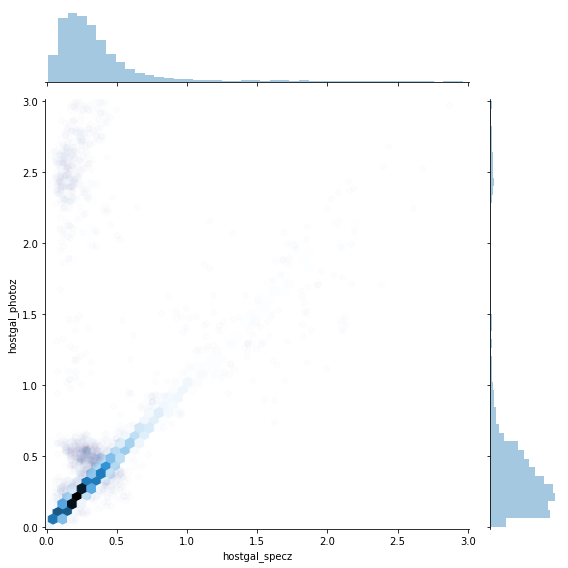

In [11]:
# 'STARTER KIT'

extragal = metadata['hostgal_specz'] != 0.
g = sns.jointplot(metadata['hostgal_specz'][extragal],\
              metadata['hostgal_photoz'][extragal], kind='hex',\
                  xlim=(-0.01, 3.01), ylim=(-0.01,3.01), height=8)

outliers = np.abs(metadata['hostgal_specz'] - metadata['hostgal_photoz']) > 0.1
fig = g.fig
fig.axes[0].scatter(metadata['hostgal_specz'][outliers],\
                    metadata['hostgal_photoz'][outliers], color='C4', alpha=0.01)
fig.tight_layout()

There's many potential choices. 

For now we'll leave everything together.

### Class Distribution

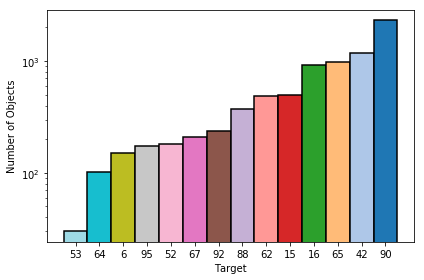

In [679]:
# starter kit'
counts = Counter(metadata['target'])
labels, values = zip(*sorted(counts.items(), key=itemgetter(1)))
fig, ax = plt.subplots()

cmap = plt.cm.tab20
nlines = len(labels)
classcolor =  list(cmap(np.linspace(0,1,nlines)))[::-1]

# we'll create a mapping between class and color
classcolmap = dict(zip(labels, classcolor))

indexes = np.arange(nlines)
width = 1
ax.bar(indexes, values, width, edgecolor='k',\
       linewidth=1.5, tick_label=labels, log=True, color=classcolor)
ax.set_xlabel('Target')
ax.set_ylabel('Number of Objects')
fig.tight_layout()

You can see the class distribution in the training set is imbalanced. This reflects reality. The Universe doesn't produce all kinds of events at equal rates, and even if it did, some events are fainter than others, so we'd naturally find fewer of them than bright events.

But we will use as much training data available as possible to train the model

In [14]:
# checking how many null values in data 
meta_df.isnull().sum()

object_id                0
ra                       0
decl                     0
gal_l                    0
gal_b                    0
ddf                      0
hostgal_specz            0
hostgal_photoz           0
hostgal_photoz_err       0
distmod               2325
mwebv                    0
target                   0
dtype: int64

distmod: related to the base 10 logarithm of the luminosity distance
For galactic objects with hostgal_photoz =0 , the distmod is reported as NaN (the distance would be 0, and taking the logarithm of 0 is a bad idea).
Thus we will replace the null values with 0.


In [930]:
meta_df = meta_df.fillna(0)
meta_df

,object_id,ra,decl,gal_l,gal_b,ddf,hostgal_specz,hostgal_photoz,hostgal_photoz_err,distmod,mwebv,target
0,615,349.046051,-61.943836,320.796530,-51.753706,1,0.0000,0.0000,0.0000,0.0000,0.017,92
1,713,53.085938,-27.784405,223.525509,-54.460748,1,1.8181,1.6267,0.2552,45.4063,0.007,88
2,730,33.574219,-6.579593,170.455585,-61.548219,1,0.2320,0.2262,0.0157,40.2561,0.021,42
3,745,0.189873,-45.586655,328.254458,-68.969298,1,0.3037,0.2813,1.1523,40.7951,0.007,90
4,1124,352.711273,-63.823658,316.922299,-51.059403,1,0.1934,0.2415,0.0176,40.4166,0.024,90
5,1227,35.683594,-5.379379,171.992947,-59.253501,1,0.0000,0.0000,0.0000,0.0000,0.020,65
6,1598,347.846710,-64.760857,318.929827,-49.143596,1,0.1352,0.1820,0.0304,39.7279,0.019,90
7,1632,348.595886,-63.072620,320.023289,-50.713060,1,0.6857,0.7014,0.0100,43.1524,0.021,42
8,1920,149.414062,3.433834,234.919132,42.245550,1,0.3088,0.3229,0.3360,41.1401,0.027,90
9,1926,149.414062,1.940072,236.565366,41.393323,1,0.0000,0.0000,0.0000,0.0000,0.018,65


Given galactic objects are assigned with the value of 0 for hostgal_photoz, the astronomical transients can therefore be separated into two distinct groups, ones that are in our Milky Way galaxy (galactic) and ones that are outside of our galaxy (extragalactic). Lets plot the distribution of galactic and extragalactic classes

In [396]:
targets = np.unique(meta_df2['target'])
# adding an iterable id for each target
target_map = {j:i for i, j in enumerate(targets)}
target_ids = [target_map[i] for i in meta_df2['target']]
meta_df2['target_id'] = target_ids

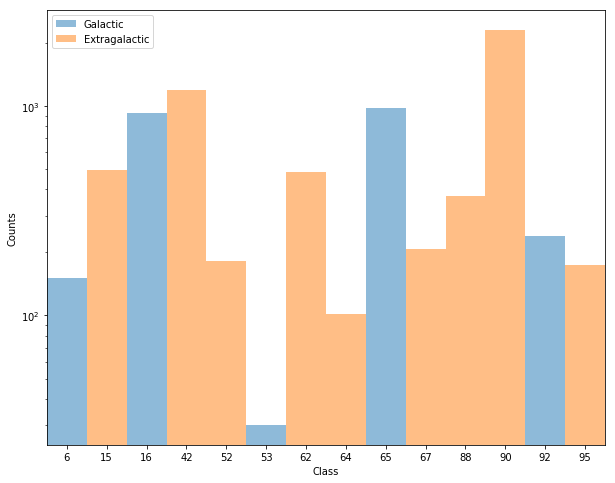

In [398]:
# array of rows which are galactic
galactic = meta_df2['hostgal_specz'] == 0
plt.figure(figsize=(10, 8))
plt.hist(meta_df2[galactic]['target_id'], 14, (0, 14), alpha=0.5, label='Galactic')
plt.hist(meta_df2[~galactic]['target_id'], 14, (0, 14), alpha=0.5, label='Extragalactic')
plt.xticks(np.arange(15)+0.5, targets)
plt.gca().set_yscale("log")
plt.xlabel('Class')
plt.ylabel('Counts')
plt.xlim(0, 14)
plt.legend();

From this plot we can see that there is no overlap at all between the galactic and extragalactic objects in the training set which is great!

Some astronomical transients especially supernovae observations are recorded outside +/- 5 degrees of the galactic latitude, plotting this might indicate supernovae objects from other transiets

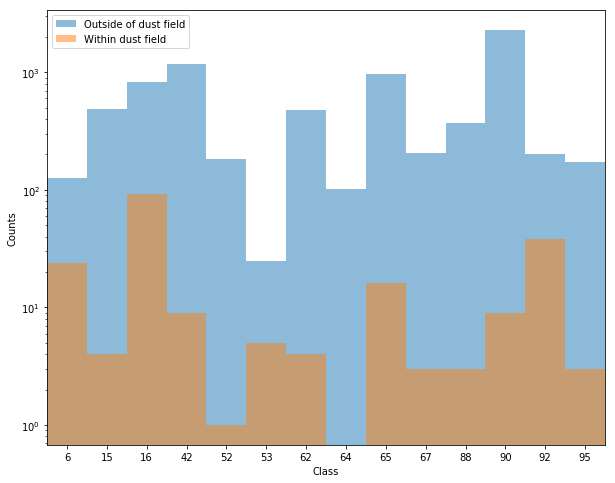

In [399]:
# List of boolean of rows where objects are not within 5degrees of galactic latitude
outside = np.logical_or(meta_df2['gal_b'] >= 5, meta_df2['gal_b'] <= -5)
plt.figure(figsize=(10, 8))
plt.hist(meta_df2[outside]['target_id'], 14, (0, 14), alpha=0.5, label='Outside of dust field')
plt.hist(meta_df2[~outside]['target_id'], 14, (0, 14), alpha=0.5, label='Within dust field')
plt.xticks(np.arange(14)+0.5, targets)
plt.gca().set_yscale("log")
plt.xlabel('Class')
plt.ylabel('Counts')
plt.xlim(0, 14)
plt.legend();

From looking at the two histograms we are able to see potential targets which could be supernovae

In [931]:
# removing object id and target as a feature 
meta_df = meta_df.drop(['object_id', 'target'], axis=1)

In [937]:
meta_df

,ra,decl,gal_l,gal_b,ddf,hostgal_specz,hostgal_photoz,hostgal_photoz_err,distmod,mwebv
0,349.046051,-61.943836,320.796530,-51.753706,1,0.0000,0.0000,0.0000,0.0000,0.017
1,53.085938,-27.784405,223.525509,-54.460748,1,1.8181,1.6267,0.2552,45.4063,0.007
2,33.574219,-6.579593,170.455585,-61.548219,1,0.2320,0.2262,0.0157,40.2561,0.021
3,0.189873,-45.586655,328.254458,-68.969298,1,0.3037,0.2813,1.1523,40.7951,0.007
4,352.711273,-63.823658,316.922299,-51.059403,1,0.1934,0.2415,0.0176,40.4166,0.024
5,35.683594,-5.379379,171.992947,-59.253501,1,0.0000,0.0000,0.0000,0.0000,0.020
6,347.846710,-64.760857,318.929827,-49.143596,1,0.1352,0.1820,0.0304,39.7279,0.019
7,348.595886,-63.072620,320.023289,-50.713060,1,0.6857,0.7014,0.0100,43.1524,0.021
8,149.414062,3.433834,234.919132,42.245550,1,0.3088,0.3229,0.3360,41.1401,0.027
9,149.414062,1.940072,236.565366,41.393323,1,0.0000,0.0000,0.0000,0.0000,0.018


Based on the metadata file, we shall now train a Random forest classifier in order to retrieve a base score

We'll split the training set into two - one for training and the other for testing.

In [938]:
#CROSS VALIDATION 1 TIME 
splitter = StratifiedShuffleSplit(n_splits=1, test_size=0.3, random_state=42)
splits = list(splitter.split(meta_df, metadata['target']))[0]
train_ind, test_ind = splits
train_ind

array([ 719, 6535, 5190, ..., 3909,  847,  456])

In [939]:
train_ind = train_ind.tolist()

In [940]:
train_ind.sort()

In [941]:
Xtrain = np.array(meta_df.loc[train_ind, :].values.tolist())
Ytrain = np.array(meta_df2['target'][train_ind].values.tolist())

Xtest  = np.array(meta_df.loc[test_ind, :].values.tolist())
Ytest  = np.array(meta_df2['target'][test_ind].values.tolist())

In [942]:
# TEST
test_clf = RandomForestClassifier(n_estimators=200, criterion='gini',\
                       oob_score=True, n_jobs=-1, random_state=42,\
                      verbose=1, class_weight='balanced', max_features='sqrt')

In [943]:
# train classifiers
def train(clf, X_train, X_test, y_train):
  clf.fit(X_train, y_train)
  y_pred = clf.predict(X_test)
  return y_pred

In [944]:
t_pred = train(test_clf, Xtrain, Xtest, Ytrain)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:    0.3s
[Parallel(n_jobs=-1)]: Done 192 tasks      | elapsed:    1.3s
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed:    1.4s finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done 200 out of 200 | elapsed:    0.1s finished


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.0s
[Parallel(n_jobs=4)]: Done 192 tasks      | elapsed:    0.1s
[Parallel(n_jobs=4)]: Done 200 out of 200 | elapsed:    0.1s finished


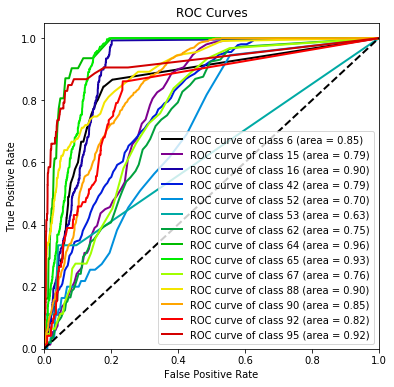

In [945]:
# Roc curve values 
Ypred_p = test_clf.predict_proba(Xtest)
skplt.metrics.plot_roc(Ytest, Ypred_p,plot_micro=False,plot_macro=False,figsize=(6,6))
plt.show()

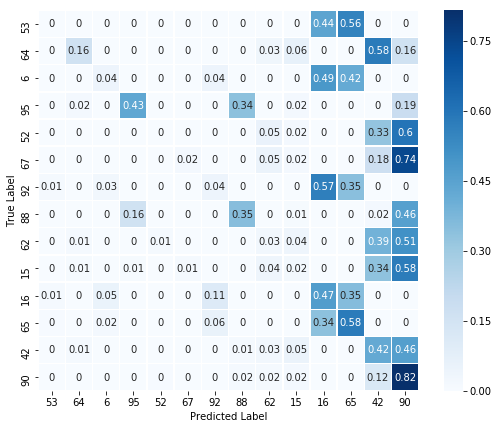

In [947]:
# confusion matrix of the first classifier
cm = confusion_matrix(Ytest, t_pred, labels=labels)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
annot = np.around(cm, 2)

fig, ax = plt.subplots(figsize=(9,7))
sns.heatmap(cm, xticklabels=labels, yticklabels=labels, cmap='Blues', annot=annot, lw=0.5)
ax.set_xlabel('Predicted Label')
ax.set_ylabel('True Label')
ax.set_aspect('equal')

In [948]:
# classifier report
print(classification_report(Ytest, t_pred))

              precision    recall  f1-score   support

           6       0.08      0.04      0.06        45
          15       0.07      0.02      0.03       149
          16       0.44      0.47      0.45       277
          42       0.39      0.42      0.40       358
          52       0.00      0.00      0.00        55
          53       0.00      0.00      0.00         9
          62       0.11      0.03      0.04       145
          64       0.33      0.16      0.22        31
          65       0.54      0.58      0.56       294
          67       0.20      0.02      0.03        62
          88       0.53      0.35      0.42       111
          90       0.55      0.82      0.65       694
          92       0.06      0.04      0.05        72
          95       0.52      0.43      0.47        53

   micro avg       0.47      0.47      0.47      2355
   macro avg       0.27      0.24      0.24      2355
weighted avg       0.40      0.47      0.42      2355



In [ ]:
# score(test_clf, Xtrain, Xtest, Ytrain, Ytest, classifier_df)

### Creating timeseries

Since the score is very low we shall build the timeseries object using the cesium python package to use the lcdata

In [10]:
# 'STARTER kit'
tsdict = OrderedDict()
for i in tnrange(nobjects, desc='Building Timeseries'):
    row = metadata[i]
    thisid = row['object_id']
    target = row['target']
    
    meta = {'z':row['hostgal_photoz'],\
            'zerr':row['hostgal_photoz_err'],\
            'mwebv':row['mwebv']}
    
    ind = (lcdata['object_id'] == thisid)
    thislc = lcdata[ind]

    pbind = [(thislc['passband'] == pb) for pb in pbmap]
    t = [thislc['mjd'][mask].data for mask in pbind ]
    m = [thislc['flux'][mask].data for mask in pbind ]
    e = [thislc['flux_err'][mask].data for mask in pbind ]

    tsdict[thisid] = TimeSeries(t=t, m=m, e=e,\
                        label=target, name=thisid, meta_features=meta,\
                        channel_names=pbnames )
    
del lcdata

The list of features available in `cesium` is huge, I have chosen the ones i feel would be most useful

In [11]:
features_to_use = ["amplitude",
                   "percent_beyond_1_std",
                   "maximum",
                   "max_slope",
                   "mean",
                   "total_time",
                   "median",
                   "median_absolute_deviation",
                   "percent_close_to_median",
                   "minimum",
                   "skew",
                   "std",
                   "weighted_average"]

In [12]:
# we'll turn off warnings for a bit, numpy can raise unnecessary warnings
import warnings
warnings.simplefilter('ignore')

We'll start computing the features. This takes a while, so it's good to do this only the once, and save state. 

In [13]:
def worker(tsobj):
    global features_to_use
    thisfeats = featurize.featurize_single_ts(tsobj,\
    features_to_use=features_to_use,
    raise_exceptions=False)
    return thisfeats

In [14]:
featurefile = f'{datadir}/plasticc_featuretable.npz'
# to prevent computing features everytime
if os.path.exists(featurefile):
    featuretable, _ = featurize.load_featureset(featurefile)
else:
    features_list = []
    with tqdm_notebook(total=nobjects, desc="Computing Features") as pbar:
        with schwimmbad.MultiPool() as pool:  
            results = pool.imap(worker, list(tsdict.values()))
            for res in results:
                features_list.append(res)
                pbar.update()
            
#             assemble all the features into a table
    featuretable = featurize.assemble_featureset(features_list=features_list,\
                              time_series=tsdict.values())
    featurize.save_featureset(fset=featuretable, path=featurefile)

A feature table with a low-dimensional encoding of the information in the light curves.

In [15]:
old_names = featuretable.columns.values

# changing the naming conventions for feature columns
new_names = ['{}_{}'.format(x, pbmap.get(y,'meta')) for x,y in old_names]

# getting the column values from original table 
cols = [featuretable[col] for col in old_names]

allfeats = Table(cols, names=new_names)
del featuretable


In [16]:
allfeats_df = allfeats.copy().to_pandas()

In [17]:
allfeats_df2 = allfeats_df.copy()

In [18]:
allfeats_df['obj_id'] = metadata['object_id'].copy()
allfeats_df['target'] = metadata['target'].copy()

allfeats_df

,amplitude_u,amplitude_g,amplitude_r,amplitude_i,amplitude_z,amplitude_y,percent_beyond_1_std_u,percent_beyond_1_std_g,percent_beyond_1_std_r,percent_beyond_1_std_i,...,weighted_average_g,weighted_average_r,weighted_average_i,weighted_average_z,weighted_average_y,mwebv_meta,z_meta,zerr_meta,obj_id,target
0,121.048015,880.533203,646.921722,488.190826,402.069122,400.501617,0.476190,0.586207,0.568966,0.551724,...,-212.397193,-102.220639,-101.206639,-54.744845,-59.688379,0.017,0.0000,0.0000,615,92
1,14.622504,10.422385,10.298480,11.862455,11.057368,14.491025,0.385714,0.392857,0.410714,0.410714,...,-1.322397,-1.030469,-1.382941,-1.407879,-1.876399,0.007,1.6267,0.2552,713,88
2,4.701063,4.543094,11.921774,19.503951,23.498145,33.234935,0.333333,0.442308,0.134615,0.115385,...,-0.034170,2.059833,2.988513,4.486335,5.057690,0.021,0.2262,0.0157,730,42
3,10.944189,97.931352,111.477482,104.097369,99.563790,75.881339,0.180556,0.035714,0.071429,0.089286,...,3.652226,6.716857,12.514694,12.247387,8.760515,0.007,0.2813,1.1523,745,90
4,6.067815,19.896143,54.378113,71.309338,80.071971,60.009062,0.333333,0.172414,0.137931,0.103448,...,3.617169,7.842645,8.830427,8.463856,5.602845,0.024,0.2415,0.0176,1124,90
5,37.748134,5.337230,2.909254,3.841772,10.914535,15.231738,0.027778,0.307692,0.326923,0.423077,...,0.356610,-0.044129,0.264363,0.688027,-0.878473,0.020,0.0000,0.0000,1227,65
6,141.604316,726.110041,646.552764,502.997459,371.318081,333.449232,0.095238,0.034483,0.034483,0.034483,...,2.024489,2.944821,5.016078,8.315349,13.931464,0.019,0.1820,0.0304,1598,90
7,4.496465,5.091600,3.522365,6.789302,11.435840,24.542787,0.349206,0.431034,0.344828,0.362069,...,0.151905,0.245103,0.948476,2.863544,6.151543,0.021,0.7014,0.0100,1632,42
8,12.964480,101.806106,117.792956,114.820791,98.717083,81.736255,0.100000,0.111111,0.111111,0.133333,...,10.822605,17.392002,25.847643,23.608398,19.736565,0.027,0.3229,0.3360,1920,90
9,7.112926,3.576050,16.487488,5.270288,8.585225,34.185699,0.333333,0.266667,0.044444,0.400000,...,-0.016015,1.571192,0.325647,-0.404186,-0.388246,0.018,0.0000,0.0000,1926,65


In [991]:
allfeats_df2

,amplitude_u,amplitude_g,amplitude_r,amplitude_i,amplitude_z,amplitude_y,percent_beyond_1_std_u,percent_beyond_1_std_g,percent_beyond_1_std_r,percent_beyond_1_std_i,percent_beyond_1_std_z,percent_beyond_1_std_y,maximum_u,maximum_g,maximum_r,maximum_i,maximum_z,maximum_y,max_slope_u,max_slope_g,max_slope_r,max_slope_i,max_slope_z,max_slope_y,mean_u,mean_g,mean_r,mean_i,mean_z,mean_y,total_time_u,total_time_g,total_time_r,total_time_i,total_time_z,total_time_y,median_u,median_g,median_r,median_i,median_z,median_y,median_absolute_deviation_u,median_absolute_deviation_g,median_absolute_deviation_r,median_absolute_deviation_i,median_absolute_deviation_z,median_absolute_deviation_y,percent_close_to_median_u,percent_close_to_median_g,percent_close_to_median_r,percent_close_to_median_i,percent_close_to_median_z,percent_close_to_median_y,minimum_u,minimum_g,minimum_r,minimum_i,minimum_z,minimum_y,skew_u,skew_g,skew_r,skew_i,skew_z,skew_y,std_u,std_g,std_r,std_i,std_z,std_y,weighted_average_u,weighted_average_g,weighted_average_r,weighted_average_i,weighted_average_z,weighted_average_y,mwebv_meta,z_meta,zerr_meta
0,121.048015,880.533203,646.921722,488.190826,402.069122,400.501617,0.476190,0.586207,0.568966,0.551724,0.517241,0.596491,125.182808,660.626343,611.984558,445.737061,381.953735,378.188141,184.863919,594.695677,423.361104,280.055192,205.475911,226.111645,-3.254554,-385.699911,-134.146566,-121.103501,-55.954592,-47.449847,797.8763,873.7530,873.7531,873.7530,873.7572,871.7697,-10.015225,-488.057969,-265.686004,-162.170944,-103.541366,-85.524307,79.958667,509.248755,368.128510,314.089447,276.594314,291.949630,0.158730,0.172414,0.172414,0.120690,0.155172,0.087719,-116.913223,-1100.440063,-681.858887,-530.644592,-422.184509,-422.815094,0.125827,0.404755,0.331063,0.285492,0.194883,0.121948,83.275842,596.576924,451.180827,332.520885,289.276965,292.182295,-17.061118,-212.397193,-102.220639,-101.206639,-54.744845,-59.688379,0.017,0.0000,0.0000
1,14.622504,10.422385,10.298480,11.862455,11.057368,14.491025,0.385714,0.392857,0.410714,0.410714,0.375000,0.392857,14.509829,9.129021,10.529041,11.330316,9.827934,14.770886,11.418733,1.738723,1.798635,2.730983,3.607656,6.128550,-2.720398,-1.019804,-0.794238,-0.986966,-0.900262,-1.794175,822.8792,842.8047,842.8047,842.8141,842.8193,842.8194,-3.096805,-0.561736,-0.117977,-0.073897,-0.792176,-2.463012,6.054598,4.696852,5.100354,5.484658,5.396183,5.702667,0.200000,0.214286,0.178571,0.214286,0.160714,0.232143,-14.735178,-11.715749,-10.067919,-12.394593,-12.286801,-14.211164,0.254446,-0.085494,-0.022066,-0.162664,-0.062403,0.212294,7.062516,5.661101,5.718981,6.392561,6.349526,7.030448,-3.500958,-1.322397,-1.030469,-1.382941,-1.407879,-1.876399,0.007,1.6267,0.2552
2,4.701063,4.543094,11.921774,19.503951,23.498145,33.234935,0.333333,0.442308,0.134615,0.115385,0.098039,0.215686,5.942166,5.693109,20.994711,33.572102,41.159981,47.310059,5.987811,2.436376,2.128031,3.727682,3.045581,5.935501,-0.048080,0.141057,2.400870,3.236164,4.308728,4.539396,829.7902,853.8084,853.8084,853.8084,853.8084,853.8084,0.024093,0.171336,0.491791,0.660403,1.004354,2.542647,1.205846,0.995237,1.042533,2.018922,2.596185,5.693106,0.347222,0.500000,0.769231,0.750000,0.745098,0.568627,-3.459960,-3.393080,-2.848838,-5.435799,-5.836310,-19.159811,0.349431,0.457635,2.315707,2.584661,2.462542,1.630520,1.816127,1.789767,5.505767,8.112835,10.604821,13.201397,-0.016423,-0.034170,2.059833,2.988513,4.486335,5.057690,0.021,0.2262,0.0157
3,10.944189,97.931352,111.477482,104.097369,99.563790,75.881339,0.180556,0.035714,0.071429,0.089286,0.107143,0.090909,18.014029,192.244293,220.795212,203.250702,183.633118,141.513290,13.567209,5.682263,4.867642,3.393333,3.227811,5.749368,1.797523,5.717394,9.711532,14.412924,13.134436,10.746138,801.9038,853.6685,853.6686,853.6685,853.6684,853.6683,1.056714,0.888115,0.424360,1.361369,1.270150,2.749555,1.720855,1.471191,1.416451,2.483005,2.385917,6.977604,0.583333,0.964286,0.892857,0.803571,0.857143,0.818182,-3.874349

In [19]:
allfeats_df = allfeats_df.set_index('obj_id')

In [20]:
pd.set_option('display.max_rows', 20)
pd.set_option('display.max_columns', 89)

In [21]:
allfeats_df2.isna().any()

amplitude_u               False
amplitude_g               False
amplitude_r               False
amplitude_i               False
amplitude_z               False
amplitude_y               False
percent_beyond_1_std_u    False
percent_beyond_1_std_g    False
percent_beyond_1_std_r    False
percent_beyond_1_std_i    False
                          ...  
std_y                     False
weighted_average_u        False
weighted_average_g        False
weighted_average_r        False
weighted_average_i        False
weighted_average_z        False
weighted_average_y        False
mwebv_meta                False
z_meta                    False
zerr_meta                 False
Length: 81, dtype: bool

## Classifier Tuning/ Evaluation Metric

In [26]:
classifier_df = pd.DataFrame(columns=['model_name','accuracy','avg_precision','avg_recall','avg_f1-score','time_fit','time_predict','classifier_parameters'])
classifier_df

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters


In [1078]:
# small helper function for formatting time
def f_time(time):
  return '(' + str(np.round(time, 2))+ 's)'


# def train(clf, X_train, X_test, y_train):
#   clf.fit(Xtrain_pca, Ytrain)
#   Ypred = clf.predict(Xtest_pca)
#   return Ypred

def score(clf, X_train, X_test, y_train, y_test):
  # train clssifier
  print('Training...',end='')
  time_start = time.time()
  clf.fit(X_train, y_train)
  time_fit = time.time() - time_start
  print('done.', f_time(time_fit))
  
  # predict test data & evaluate
  print('Predicting...',end='')
  time_start = time.time()
  Ypred = clf.predict(X_test)
  Ypred_p = clf.predict_proba(X_test)
  time_predict = time.time() - time_start
  print('done.', f_time(time_predict))
  
  # get information
  model_name = type(clf).__name__

    
  #Cross validation recommended for large datasets 3
  score = 0.0
  splitter = StratifiedShuffleSplit(n_splits=3, test_size=0.3, random_state=42)
  splits = list(splitter.split(ex_df2, new_target))
  for train, test in splits:
#     when score function is run for a particular strategy, the following code in the for loop,
#     the Training and test set extraction is changed manually based on the strategy being tested
    score = score/2
#     REPLACE SECTION 1:
# BELOW BASED ON THE FEATURESET THE CLASSIFIER IS BEING SCORED ON
    Xtrain = np.array(ex_df2.loc[train, :].values.tolist())
    Ytrain = np.array(new_target[train].tolist())

    Xtest  = np.array(ex_df2.loc[test, :].values.tolist())
    Ytest  = np.array(new_target[test].tolist())
#   REPLACE ABOVE     
    clf.fit(Xtrain, Ytrain)
    scores_temp = cross_val_score(clf, Xtrain, Ytrain, cv=3)
    print('Temporary score =', scores_temp.mean())
    score = score+(scores_temp.mean())
    print('Ovr_Score =', score)
     
    
  #   print("Accuracy: " score.mean())
  accuracy = accuracy_score(y_test, Ypred)
  #   accuracy = score/2
  avg_precision = precision_score(y_test, Ypred, average='weighted')
  avg_recall = recall_score(y_test, Ypred, average='weighted')
  avg_f1_score = f1_score(y_test, Ypred, average='weighted')
  row = {'model_name':model_name,'accuracy':accuracy,'avg_precision':avg_precision,'avg_recall':avg_recall,'avg_f1-score':avg_f1_score,'time_fit':time_fit,'time_predict':time_predict,'classifier_parameters':clf}
  
  # update report df
# based on the strategy being tested the name of the dataframe to which the results are added is manually changed
  global classifier_df
  classifier_df = classifier_df[classifier_df['model_name'] != model_name]
  classifier_df = classifier_df.append(row, ignore_index=True)

  # statistic report
  print('Statistic Report:')
  print(classification_report(y_test, Ypred))
  
  # ROC plot for each target
  skplt.metrics.plot_roc(y_test, Ypred_p,plot_micro=False,plot_macro=False,figsize=(6,6))
  plt.show()

In [533]:
# Hyperparameter tuning based on training data with crossvalidation
def hyper_clf(model, X, y, parameter_space=dict(), n_folds=3):  
# set params & do parameter search with CV
  n_samples = 1
  for key, value in parameter_space.items():
    n_samples *= len(value)
  
  print('Hyperparameter space search')
  time_start = time.time()
    
# Exhaustive search, Cv default to 3
  clf_grid = GridSearchCV(model, parameter_space, cv=n_folds, n_jobs=1)
# how to reduce smaple space to reduce time taken to train?
    
  clf_grid.fit(X, y)
# time taken 
  time_grid_search = time.time()-time_start
  print('Done.', f_time(time_grid_search))
  print('Avg per sample:', f_time(time_grid_search/n_samples))
  
  print('Score:', clf_grid.best_score_)
  print('Parameters:', clf_grid.best_params_)
  best_clf = clf_grid.best_estimator_

  return best_clf
   

In [1113]:
def plot_roc(clfs, Ytest, Xtest):
    for clf in clfs:
        if type(clf).__name__ == 'Sequential':
            scaler = StandardScaler().fit(Xtrain)
            X_test_b = scaler.transform(Xtest)
            pred_p = clf.predict(X_test_b)
            pred_p = pred_p.tolist()
            pred = []
        # to get prob values of each target
            targets = [0,1]

            for i in range(len(pred_p)):
                cell = pred_p[i]
                max_value = max(cell)
                max_index = cell.index(max_value)
                pred.append(max_index)
#                 pred_p[i] =[ cell[j] for j in targets]
            
            pred_p = np.asarray(pred_p)
# Compute False postive rate, and True positive rate
            fpr, tpr, thresholds = metrics.roc_curve(Ytest,pred_p[:,1])
# Calculate Area under the curve to display on the plot
            auc = metrics.roc_auc_score(Ytest,pred)

        else:
            y_pred=clf.predict(Xtest) # predict the test data
            y_pred_p = clf.predict_proba(Xtest)[:,1]
        
# Compute False postive rate, and True positive rate
            fpr, tpr, thresholds = metrics.roc_curve(Ytest, clf.predict_proba(Xtest)[:,1])
# Calculate Area under the curve to display on the plot
            auc = metrics.roc_auc_score(Ytest,y_pred)
# Now, we can plot the computed values
        plt.plot(fpr, tpr, label='%s ROC (area = %0.2f)' % (type(clf).__name__, auc))
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic')
    plt.legend(loc="lower right")
    plt.show()   # Display

### Test(timeseries full featureset)

In the follwing section we shall test several representative classifiers on the 'full-featurest'

In [55]:
# I define a dataframe to store the classifier values for comparison 
classifier_df = pd.DataFrame(columns=['model_name','accuracy','avg_precision','avg_recall','avg_f1-score','time_fit','time_predict','classifier_parameters'])
classifier_df

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters


In [1018]:
# to choose best classifier
splitter = StratifiedShuffleSplit(n_splits=1, test_size=0.3, random_state=42)
splits = list(splitter.split(allfeats_df2, meta_df2['target']))[0]
train_ind, test_ind = splits
train_ind = train_ind.tolist()
train_ind.sort()

In [1026]:
# COPY PASTE THIS SECTION INTO SECTION 1, MENTIONED IN Score method
Xtrain = np.array(allfeats_df2.loc[train_ind, :].values.tolist())
Ytrain = np.array(meta_df2['target'][train_ind].values.tolist())

Xtest  = np.array(allfeats_df2.loc[test_ind, :].values.tolist())
Ytest  = np.array(meta_df2['target'][test_ind].values.tolist())

In [59]:
clf0 = DecisionTreeClassifier()

parameter_space = {'max_depth':[10],
                   'min_samples_leaf':[3],
                   'splitter':['random'],
                   'criterion':['entropy'] 
                  }
best_clf0 = hyper_clf(clf0, Xtrain, Ytrain, parameter_space, n_folds=3)

Hyperparameter space search
Done. (0.14s)
Avg per sample: (0.14s)
Score: 0.5845621700345894
Parameters: {'criterion': 'entropy', 'max_depth': 10, 'min_samples_leaf': 3, 'splitter': 'random'}


Training...done. (0.05s)
Predicting...done. (0.0s)
Temporary score = 0.62426115985673
Ovr_Score = 0.62426115985673
Temporary score = 0.6182329162977934
Ovr_Score = 0.9303634962261584
Statistic Report:
              precision    recall  f1-score   support

           6       0.59      0.44      0.51        45
          15       0.52      0.47      0.49       149
          16       0.92      0.93      0.93       277
          42       0.42      0.43      0.43       358
          52       0.00      0.00      0.00        55
          53       0.70      0.78      0.74         9
          62       0.33      0.14      0.20       145
          64       0.50      0.16      0.24        31
          65       0.85      0.95      0.90       294
          67       0.07      0.02      0.03        62
          88       0.89      0.90      0.90       111
          90       0.63      0.79      0.70       694
          92       0.85      0.81      0.83        72
          95       0.60      0.62      0.6

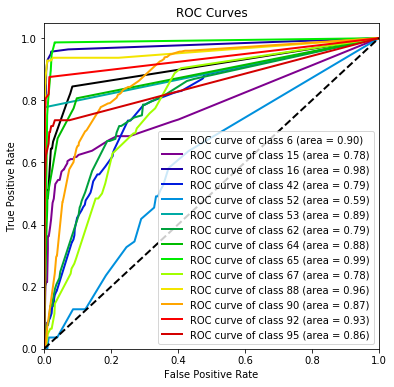

In [60]:
score(best_clf0, Xtrain, Xtest, Ytrain, Ytest)

In [1027]:
clf = RandomForestClassifier(n_estimators=400, criterion='entropy',\
                       oob_score=True, n_jobs=-1, random_state=42
                             , class_weight='balanced', max_features='sqrt')
# Defining the Parameter space
parameter_space = {'min_samples_leaf':[3], 
                   'n_estimators':[400]}
best_clf = hyper_clf(clf, Xtrain, Ytrain, parameter_space, n_folds=3)

Hyperparameter space search
Done. (99.37s)
Avg per sample: (99.37s)
Score: 0.7118150373202258
Parameters: {'min_samples_leaf': 3, 'n_estimators': 400}


Training...done. (25.64s)
Predicting...done. (0.41s)
Temporary score = 0.9994537507655842
Ovr_Score = 0.9994537507655842
Temporary score = 0.9994539496186
Ovr_Score = 1.499180825001392
Temporary score = 0.999635999608871
Ovr_Score = 1.749226412109567
Statistic Report:
              precision    recall  f1-score   support

           6       0.91      0.64      0.75        45
          15       0.64      0.72      0.68       149
          16       0.97      0.97      0.97       277
          42       0.58      0.44      0.50       358
          52       0.00      0.00      0.00        55
          53       1.00      0.89      0.94         9
          62       0.43      0.29      0.35       145
          64       0.66      0.61      0.63        31
          65       0.95      0.99      0.97       294
          67       0.67      0.13      0.22        62
          88       0.94      0.98      0.96       111
          90       0.67      0.88      0.76       694
          92       0.93     

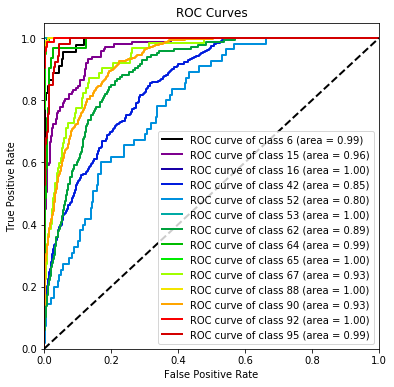

In [984]:
score(best_clf, Xtrain, Xtest, Ytrain, Ytest)

In [1030]:
#Classifiers 
clf1 = GradientBoostingClassifier(n_estimators=300, learning_rate=1.0, max_depth=1, random_state=42)
# Defining the Parameter space
parameter_space = {'learning_rate':[0.1], 
                   'n_estimators':[300],
                  'max_depth':[1],
                  'min_samples_leaf':[2]}
best_clf1 = hyper_clf(clf1, Xtrain, Ytrain, parameter_space, n_folds=3)

Hyperparameter space search
Done. (257.05s)
Avg per sample: (257.05s)
Score: 0.713817586018569
Parameters: {'learning_rate': 0.1, 'max_depth': 1, 'min_samples_leaf': 2, 'n_estimators': 300}


Training...done. (83.2s)
Predicting...done. (0.13s)
Temporary score = 1.0
Ovr_Score = 1.0
Temporary score = 1.0
Ovr_Score = 1.5
Temporary score = 1.0
Ovr_Score = 1.75
Statistic Report:
              precision    recall  f1-score   support

           6       0.89      0.69      0.78        45
          15       0.66      0.58      0.61       149
          16       0.96      0.97      0.97       277
          42       0.54      0.49      0.51       358
          52       0.00      0.00      0.00        55
          53       0.86      0.67      0.75         9
          62       0.34      0.17      0.23       145
          64       0.65      0.48      0.56        31
          65       0.95      0.99      0.97       294
          67       0.25      0.03      0.06        62
          88       0.94      0.93      0.94       111
          90       0.67      0.90      0.77       694
          92       0.90      0.89      0.90        72
          95       0.80      0.83      0.81        53

   

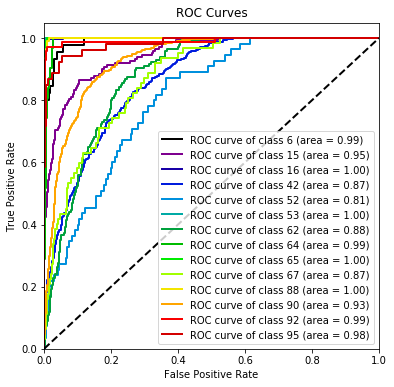

In [985]:
score(best_clf1, Xtrain, Xtest, Ytrain, Ytest)

In [ ]:
# train classifiers
# features selection strats 
# train classifiers 
# change to binary 
### plotting the light curves (to identify supernovae) + with phase analysis

In [ ]:
# SVM
# clf2 = svm.SVC(kernel='rbf', gamma='scale', decision_function_shape='ovo', cache_size=7000)
# # Defining the Parameter space
# # , 'sigmoid', 'precomputed'
# # class weight = balanced
# parameter_space = {'kernel':['linear', 'poly'], 
#                    'gamma':['auto','auto_deprecated']}
# best_clf = hyper_clf(clf2, Xtrain, Ytrain, parameter_space, n_folds=3)

Hyperparameter space search


In [ ]:
# Nu-Support Vector Classification: Similar to SVC but uses a parameter to control the number of support vectors.
# clf3 = svm.NuSVC(kernel='rbf', gamma='scale', decision_function_shape='ovo')
# # Defining the Parameter space
# # , 'sigmoid', 'precomputed'
# # class weight = balanced
# parameter_space = {'kernal':['linear', 'poly'], 
#                    'gamma':['auto','auto_deprecated']}

In [1031]:
# KNN
# metrics for real values
clf4 =  KNeighborsClassifier(algorithm='auto')
parameter_space = {'n_neighbors':[8],
                   'weights':['distance'],
                   'p':[1], 
                   'metric':['manhattan']}
best_clf4 = hyper_clf(clf4, Xtrain, Ytrain, parameter_space, n_folds=3)

Hyperparameter space search
Done. (10.99s)
Avg per sample: (10.99s)
Score: 0.543054797014382
Parameters: {'metric': 'manhattan', 'n_neighbors': 8, 'p': 1, 'weights': 'distance'}


Training...done. (0.02s)
Predicting...done. (5.97s)
Temporary score = 0.7769894468802256
Ovr_Score = 0.7769894468802256
Temporary score = 0.7784456470805504
Ovr_Score = 1.1669403705206634
Temporary score = 0.77717269118323
Ovr_Score = 1.3606428764435616
Statistic Report:
              precision    recall  f1-score   support

           6       0.63      0.38      0.47        45
          15       0.66      0.54      0.59       149
          16       0.95      0.90      0.92       277
          42       0.37      0.31      0.33       358
          52       0.00      0.00      0.00        55
          53       0.88      0.78      0.82         9
          62       0.36      0.30      0.33       145
          64       0.00      0.00      0.00        31
          65       0.81      0.54      0.65       294
          67       0.50      0.15      0.23        62
          88       0.88      0.82      0.85       111
          90       0.55      0.87      0.67       694
          92       0.97  

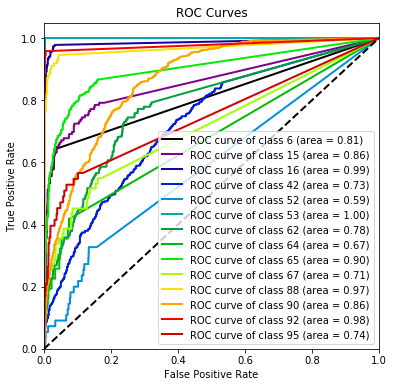

In [1009]:
score(best_clf4, Xtrain, Xtest, Ytrain, Ytest)

In [81]:
# metrics for real values
clf5 =  KNeighborsRegressor(algorithm='auto')
parameter_space = {'n_neighbors':[12],
                   'weights':['distance'],
                   'p':[1], 
                   'metric':['manhattan']}
best_clf5 = hyper_clf(clf5, Xtrain, Ytrain, parameter_space, n_folds=3)

Hyperparameter space search
Done. (58.97s)
Avg per sample: (14.74s)
Score: 0.3831065195149569
Parameters: {'metric': 'manhattan', 'n_neighbors': 12, 'p': 1, 'weights': 'distance'}


Training...done. (0.02s)
Predicting...done. (0.05s)
Temporary score = 0.19191032184835116
Ovr_Score = 0.19191032184835116
Temporary score = 0.214296850081172
Ovr_Score = 0.3102520110053476
Statistic Report:
              precision    recall  f1-score   support

           6       0.52      0.24      0.33        45
          15       0.58      0.36      0.44       149
          16       0.79      0.32      0.46       277
          42       0.27      0.02      0.04       358
          52       0.03      0.05      0.04        55
          53       0.70      0.78      0.74         9
          62       0.18      0.07      0.10       145
          64       0.00      0.00      0.00        31
          65       0.22      0.12      0.16       294
          67       0.04      0.95      0.08        62
          88       0.33      0.42      0.37       111
          90       0.20      0.00      0.01       694
          92       0.78      0.69      0.74        72
          95       0.18      0.25   

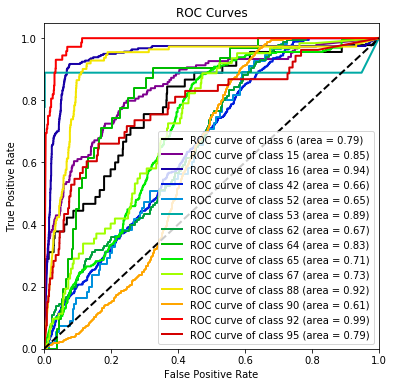

In [77]:
# Naive-bayes
clf6 = GaussianNB()
score(clf6, Xtrain, Xtest, Ytrain, Ytest)

In [79]:
# Naive-bayes
# data must be non negative, not implemented
# clf7 = MultinomialNB()
# score(clf7, Xtrain, Xtest, Ytrain, Ytest)

Hyperparameter space search
Done. (10.43s)
Avg per sample: (10.43s)
Score: 0.5037320225741854
Parameters: {}
Training...done. (3.78s)
Predicting...done. (0.01s)
Temporary score = 0.522645549438517
Ovr_Score = 0.522645549438517
Temporary score = 0.565550321471422
Ovr_Score = 0.8268730961906805
Temporary score = 0.5515997545799486
Ovr_Score = 0.9650363026752888
Statistic Report:
              precision    recall  f1-score   support

           6       0.62      0.29      0.39        45
          15       0.59      0.50      0.54       149
          16       0.97      0.92      0.95       277
          42       0.31      0.28      0.30       358
          52       0.00      0.00      0.00        55
          53       1.00      0.89      0.94         9
          62       0.29      0.29      0.29       145
          64       0.00      0.00      0.00        31
          65       0.80      0.60      0.68       294
          67       0.16      0.11      0.13        62
          88       0.79  

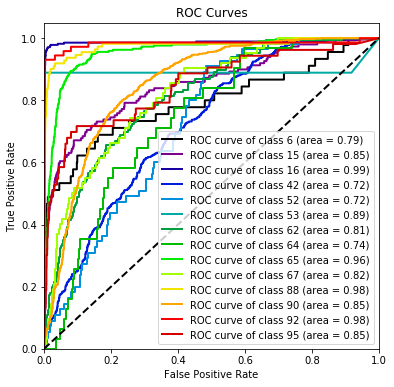

In [334]:
clf8 =  MLPClassifier()
parameter_space = {}
best_clf8 = hyper_clf(clf8, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf8, Xtrain, Xtest, Ytrain, Ytest)

In [992]:
# Define the scaler 
scaler = StandardScaler().fit(Xtrain)

# Scale the train set
X_train = scaler.transform(Xtrain)

# Scale the test set
X_test = scaler.transform(Xtest)

In [993]:
# Initialize the constructor
clf7 = Sequential()

# Add an input layer 
clf7.add(Dense(30, activation='sigmoid', input_shape=(81,)))
clf7.add(Dense(24, activation='sigmoid'))
# Add an output layer 
clf7.add(Dense(96, activation='sigmoid'))


# build a fairly simple stack of fully-connected layers
#  activation function that you will use, it’s best to use one of the most common 
#  you have an input layer, some hidden layers and an output layer
# irst layer needs to make the input shape clear
# Dense layer, which is a fully connected layer. 

#  two key architecture decisions that you need to make to make your model: how many layers you’re going to use and how many “hidden units” you will chose for each layer.

In [994]:
clf7.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])
time_start = time.time()
clf7.fit(X_train, Ytrain,epochs=20, batch_size=1, verbose=1)
time_fit = time.time() - time_start

Epoch 1/20
5493/5493 [==============================] - 26s 5ms/step - loss: 1.9996 - acc: 0.3479
Epoch 2/20
5493/5493 [==============================] - 25s 5ms/step - loss: 1.4962 - acc: 0.5181
Epoch 3/20
5493/5493 [==============================] - 24s 4ms/step - loss: 1.2366 - acc: 0.5975
Epoch 4/20
5493/5493 [==============================] - 26s 5ms/step - loss: 1.1069 - acc: 0.6266
Epoch 5/20
5493/5493 [==============================] - 25s 5ms/step - loss: 1.0482 - acc: 0.6375
Epoch 6/20
5493/5493 [==============================] - 25s 5ms/step - loss: 1.0096 - acc: 0.6517
Epoch 7/20
5493/5493 [==============================] - 25s 5ms/step - loss: 0.9766 - acc: 0.6590
Epoch 8/20
5493/5493 [==============================] - 25s 5ms/step - loss: 0.9585 - acc: 0.6676
Epoch 9/20
5493/5493 [==============================] - 26s 5ms/step - loss: 0.9345 - acc: 0.6754
Epoch 10/20
5493/5493 [==============================] - 28s 5ms/step - loss: 0.9183 - acc: 0.6790
Epoch 11/20
5493/54

In [1104]:
def score_nn(clf, y_test, y_pred, y_pred_p):
  model_name = type(clf).__name__
#    Cross validation recommended for large datasets 
#    If no scoring is specified, the estimator passed should have a 'score' method. 
#     keras estimator does not have score method
     
    
  #   print("Accuracy: " score.mean())
  accuracy = accuracy_score(y_test, y_pred)
  #   accuracy = score/2
  avg_precision = precision_score(y_test, y_pred, average='weighted')
  avg_recall = recall_score(y_test, y_pred, average='weighted')
  avg_f1_score = f1_score(y_test, y_pred, average='weighted')
  row = {'model_name':model_name,'accuracy':accuracy,'avg_precision':avg_precision,'avg_recall':avg_recall,'avg_f1-score':avg_f1_score,'time_fit':time_fit,'time_predict':time_predict,'classifier_parameters':clf}
  
  # update report df, the name of the dataframe is changed manually depending on where we want to update it
  global classifier_df
  classifier_df = classifier_df[classifier_df['model_name'] != model_name]
  classifier_df = classifier_df.append(row, ignore_index=True)

  # statistic report
  print('Statistic Report:')
  print(classification_report(y_test, y_pred))
  
  # ROC plot for each target
  skplt.metrics.plot_roc(y_test, y_pred_p,plot_micro=False,plot_macro=False,figsize=(6,6))
  plt.show()

In [995]:
time_start = time.time()
ca_y_pred = clf7.predict(X_test)
time_predict = time.time() - time_start
ca_y_pred = ca_y_pred.tolist()

In [996]:
pred = []
# to get prob values of each target
targets = [6,15,16,42,52,53,62,64,65,67,88,90,92,95]

for i in range(len(ca_y_pred)):
    cell = ca_y_pred[i]
    max_value = max(cell)
    max_index = cell.index(max_value)
    pred.append(max_index)
    ca_y_pred[i] =[ cell[j] for j in targets]
   


Statistic Report:
              precision    recall  f1-score   support

           6       0.75      0.60      0.67        45
          15       0.56      0.47      0.51       149
          16       0.94      1.00      0.97       277
          42       0.47      0.48      0.47       358
          52       0.00      0.00      0.00        55
          53       1.00      0.89      0.94         9
          62       0.28      0.11      0.16       145
          64       0.40      0.19      0.26        31
          65       0.94      0.95      0.94       294
          67       0.00      0.00      0.00        62
          88       0.88      0.95      0.92       111
          90       0.66      0.86      0.75       694
          92       0.98      0.88      0.93        72
          95       0.69      0.89      0.78        53

   micro avg       0.71      0.71      0.71      2355
   macro avg       0.61      0.59      0.59      2355
weighted avg       0.66      0.71      0.67      2355



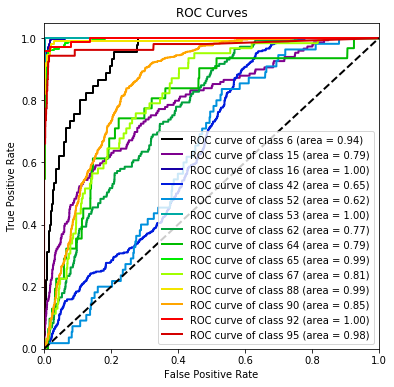

In [999]:
score_nn(clf7, Ytest, pred, ca_y_pred)


In [1000]:
classifier_df

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
0,DecisionTreeClassifier,0.658599,0.622403,0.658599,0.633317,0.046179,0.003548,"DecisionTreeClassifier(class_weight=None, crit..."
1,GradientBoostingClassifier,0.735881,0.698141,0.735881,0.707270,85.723194,0.128653,([DecisionTreeRegressor(criterion='friedman_ms...
2,GaussianNB,0.164331,0.326756,0.164331,0.171694,0.017304,0.051504,"GaussianNB(priors=None, var_smoothing=1e-09)"
3,KNeighborsClassifier,0.611890,0.603583,0.611890,0.587607,0.013529,6.465613,"KNeighborsClassifier(algorithm='auto', leaf_si..."
4,MLPClassifier,0.594904,0.582914,0.594904,0.581136,3.780805,0.007996,"MLPClassifier(activation='relu', alpha=0.0001,..."
5,RandomForestClassifier,0.746921,0.723843,0.746921,0.723008,26.264105,0.660320,"(DecisionTreeClassifier(class_weight=None, cri..."
6,Sequential,0.707856,0.657111,0.707856,0.674804,526.447944,1.457942,<keras.engine.sequential.Sequential object at ...


In [1001]:
classifier_df.sort_values(by=['avg_f1-score'], ascending=False)

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
5,RandomForestClassifier,0.746921,0.723843,0.746921,0.723008,26.264105,0.660320,"(DecisionTreeClassifier(class_weight=None, cri..."
1,GradientBoostingClassifier,0.735881,0.698141,0.735881,0.707270,85.723194,0.128653,([DecisionTreeRegressor(criterion='friedman_ms...
6,Sequential,0.707856,0.657111,0.707856,0.674804,526.447944,1.457942,<keras.engine.sequential.Sequential object at ...
0,DecisionTreeClassifier,0.658599,0.622403,0.658599,0.633317,0.046179,0.003548,"DecisionTreeClassifier(class_weight=None, crit..."
3,KNeighborsClassifier,0.611890,0.603583,0.611890,0.587607,0.013529,6.465613,"KNeighborsClassifier(algorithm='auto', leaf_si..."
4,MLPClassifier,0.594904,0.582914,0.594904,0.581136,3.780805,0.007996,"MLPClassifier(activation='relu', alpha=0.0001,..."
2,GaussianNB,0.164331,0.326756,0.164331,0.171694,0.017304,0.051504,"GaussianNB(priors=None, var_smoothing=1e-09)"


### Confusion matrix of best classifier on random test set

In [690]:
best_clf

RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='entropy', max_depth=None, max_features='sqrt',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=3,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators=400, n_jobs=-1, oob_score=True, random_state=42,
            verbose=0, warm_start=False)

In [691]:
pred_best = best_clf.predict(Xtest)

In [692]:
print(classification_report(Ytest, pred_best))

              precision    recall  f1-score   support

           6       0.91      0.64      0.75        45
          15       0.64      0.72      0.68       149
          16       0.97      0.97      0.97       277
          42       0.58      0.44      0.50       358
          52       0.00      0.00      0.00        55
          53       1.00      0.89      0.94         9
          62       0.43      0.29      0.35       145
          64       0.66      0.61      0.63        31
          65       0.95      0.99      0.97       294
          67       0.67      0.13      0.22        62
          88       0.94      0.98      0.96       111
          90       0.67      0.88      0.76       694
          92       0.93      0.93      0.93        72
          95       0.88      0.66      0.75        53

   micro avg       0.75      0.75      0.75      2355
   macro avg       0.73      0.65      0.67      2355
weighted avg       0.72      0.75      0.72      2355



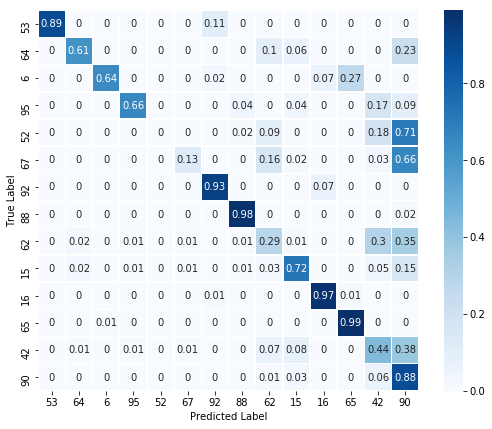

In [693]:
cm = confusion_matrix(Ytest, pred_best, labels=labels)
cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
annot = np.around(cm, 2)

fig, ax = plt.subplots(figsize=(9,7))
sns.heatmap(cm, xticklabels=labels, yticklabels=labels, cmap='Blues', annot=annot, lw=0.5)
ax.set_xlabel('Predicted Label')
ax.set_ylabel('True Label')
ax.set_aspect('equal')

Some classes are better identified than others which are being confused very badly. This reflects what happens in reality to astronomers. Some classes are easier to distinguish than others. 

### Feature selection strategies

### PCA

In [956]:
pca = PCA(n_components=5, whiten=True, svd_solver="full", random_state=42)
Xtrain_pca = pca.fit_transform(Xtrain)
Xtest_pca = pca.transform(Xtest)

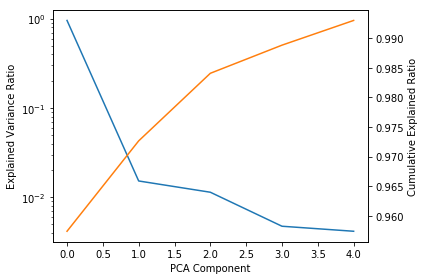

In [957]:
# see where most of the information is being held
fig, ax = plt.subplots()
ax.plot(np.arange(5), pca.explained_variance_ratio_, color='C0')
ax2 = ax.twinx()
ax2.plot(np.arange(5), np.cumsum(pca.explained_variance_ratio_), color='C1')
ax.set_yscale('log')
ax.set_xlabel('PCA Component')
ax.set_ylabel('Explained Variance Ratio')
ax2.set_ylabel('Cumulative Explained Ratio')
fig.tight_layout()

Looks like a few features seem to hold all the weight

In [87]:
# initial classifiers table
allfeats_df.to_csv(path_or_buf='data/weka_set1.csv', index=False)

We tried Forward Feature selection method via weka(Correlation rank then classify with random forest) in order to identify a subset of features to train the Random forest on

features to use:
    ppercent_beyond_1_std_u
              median_absolute_deviation_g
              minimum_r
              skew_g
              skew_r
              skew_i
              skew_z
              skew_y
              z_meta
              zerr_meta
              target

In [ ]:
# the column id of the features
[7,8,57,62,63,64,65,66,80,81]

In [110]:
newdf = allfeats_df2[allfeats_df2.columns[[6,7,56,61,62,63,64,65,79,80]]].copy()

In [111]:
newdf

,percent_beyond_1_std_u,percent_beyond_1_std_g,minimum_r,skew_g,skew_r,skew_i,skew_z,skew_y,z_meta,zerr_meta
0,0.476190,0.586207,-681.858887,0.404755,0.331063,0.285492,0.194883,0.121948,0.0000,0.0000
1,0.385714,0.392857,-10.067919,-0.085494,-0.022066,-0.162664,-0.062403,0.212294,1.6267,0.2552
2,0.333333,0.442308,-2.848838,0.457635,2.315707,2.584661,2.462542,1.630520,0.2262,0.0157
3,0.180556,0.035714,-2.159753,6.817994,5.534683,3.650356,3.382600,3.083716,0.2813,1.1523
4,0.333333,0.172414,-2.084535,2.315295,2.995322,3.509344,3.802308,3.560347,0.2415,0.0176
5,0.027778,0.307692,-2.793446,1.980310,0.017738,-0.042035,0.240085,0.519950,0.0000,0.0000
6,0.095238,0.034483,-3.254089,5.159199,5.179738,5.121903,5.113631,5.029880,0.1820,0.0304
7,0.349206,0.431034,-2.935360,0.030418,0.074535,-0.171484,0.409355,0.729698,0.7014,0.0100
8,0.100000,0.111111,-3.757573,3.211007,2.735925,2.307780,2.201159,1.987884,0.3229,0.3360
9,0.333333,0.266667,-2.316400,-0.042038,4.202053,-0.457403,-0.147721,-1.439236,0.0000,0.0000


In [ ]:
# Weka columns to be dropped after backwards elim for randomForest

['percent_close_to_median_u', 'total_time_i', 'total_time_z', 'total_time_y', 'mwebv_meta']

In [117]:
newdf_v2 = allfeats_df2.copy()
newdf_v2.drop(['percent_close_to_median_u', 'total_time_i', 'total_time_z', 'total_time_y', 'mwebv_meta'], axis=1)

,amplitude_u,amplitude_g,amplitude_r,amplitude_i,amplitude_z,amplitude_y,percent_beyond_1_std_u,percent_beyond_1_std_g,percent_beyond_1_std_r,percent_beyond_1_std_i,percent_beyond_1_std_z,percent_beyond_1_std_y,maximum_u,maximum_g,maximum_r,maximum_i,maximum_z,maximum_y,max_slope_u,max_slope_g,max_slope_r,max_slope_i,max_slope_z,max_slope_y,mean_u,mean_g,mean_r,mean_i,mean_z,mean_y,total_time_u,total_time_g,total_time_r,median_u,median_g,median_r,median_i,median_z,median_y,median_absolute_deviation_u,median_absolute_deviation_g,median_absolute_deviation_r,median_absolute_deviation_i,median_absolute_deviation_z,median_absolute_deviation_y,percent_close_to_median_g,percent_close_to_median_r,percent_close_to_median_i,percent_close_to_median_z,percent_close_to_median_y,minimum_u,minimum_g,minimum_r,minimum_i,minimum_z,minimum_y,skew_u,skew_g,skew_r,skew_i,skew_z,skew_y,std_u,std_g,std_r,std_i,std_z,std_y,weighted_average_u,weighted_average_g,weighted_average_r,weighted_average_i,weighted_average_z,weighted_average_y,z_meta,zerr_meta
0,121.048015,880.533203,646.921722,488.190826,402.069122,400.501617,0.476190,0.586207,0.568966,0.551724,0.517241,0.596491,125.182808,660.626343,611.984558,445.737061,381.953735,378.188141,184.863919,594.695677,423.361104,280.055192,205.475911,226.111645,-3.254554,-385.699911,-134.146566,-121.103501,-55.954592,-47.449847,797.8763,873.7530,873.7531,-10.015225,-488.057969,-265.686004,-162.170944,-103.541366,-85.524307,79.958667,509.248755,368.128510,314.089447,276.594314,291.949630,0.172414,0.172414,0.120690,0.155172,0.087719,-116.913223,-1100.440063,-681.858887,-530.644592,-422.184509,-422.815094,0.125827,0.404755,0.331063,0.285492,0.194883,0.121948,83.275842,596.576924,451.180827,332.520885,289.276965,292.182295,-17.061118,-212.397193,-102.220639,-101.206639,-54.744845,-59.688379,0.0000,0.0000
1,14.622504,10.422385,10.298480,11.862455,11.057368,14.491025,0.385714,0.392857,0.410714,0.410714,0.375000,0.392857,14.509829,9.129021,10.529041,11.330316,9.827934,14.770886,11.418733,1.738723,1.798635,2.730983,3.607656,6.128550,-2.720398,-1.019804,-0.794238,-0.986966,-0.900262,-1.794175,822.8792,842.8047,842.8047,-3.096805,-0.561736,-0.117977,-0.073897,-0.792176,-2.463012,6.054598,4.696852,5.100354,5.484658,5.396183,5.702667,0.214286,0.178571,0.214286,0.160714,0.232143,-14.735178,-11.715749,-10.067919,-12.394593,-12.286801,-14.211164,0.254446,-0.085494,-0.022066,-0.162664,-0.062403,0.212294,7.062516,5.661101,5.718981,6.392561,6.349526,7.030448,-3.500958,-1.322397,-1.030469,-1.382941,-1.407879,-1.876399,1.6267,0.2552
2,4.701063,4.543094,11.921774,19.503951,23.498145,33.234935,0.333333,0.442308,0.134615,0.115385,0.098039,0.215686,5.942166,5.693109,20.994711,33.572102,41.159981,47.310059,5.987811,2.436376,2.128031,3.727682,3.045581,5.935501,-0.048080,0.141057,2.400870,3.236164,4.308728,4.539396,829.7902,853.8084,853.8084,0.024093,0.171336,0.491791,0.660403,1.004354,2.542647,1.205846,0.995237,1.042533,2.018922,2.596185,5.693106,0.500000,0.769231,0.750000,0.745098,0.568627,-3.459960,-3.393080,-2.848838,-5.435799,-5.836310,-19.159811,0.349431,0.457635,2.315707,2.584661,2.462542,1.630520,1.816127,1.789767,5.505767,8.112835,10.604821,13.201397,-0.016423,-0.034170,2.059833,2.988513,4.486335,5.057690,0.2262,0.0157
3,10.944189,97.931352,111.477482,104.097369,99.563790,75.881339,0.180556,0.035714,0.071429,0.089286,0.107143,0.090909,18.014029,192.244293,220.795212,203.250702,183.633118,141.513290,13.567209,5.682263,4.867642,3.393333,3.227811,5.749368,1.797523,5.717394,9.711532,14.412924,13.134436,10.746138,801.9038,853.6685,853.6686,1.056714,0.888115,0.424360,1.361369,1.270150,2.749555,1.720855,1.471191,1.416451,2.483005,2.385917,6.977604,0.964286,0.892857,0.803571,0.857143,0.818182,-3.874349,-3.618410,-2.159753,-4.944036,-15.494463,-10.249387,1.980815,6.817994,5.534683,3.650356,3.382600,3.083716,4.343961,25.731788,31.671373,34.654080,32.772464,25.822133,1.176322,3.652226,6.716857,12.514694,12.247387,8.760515,0.2813,1.1523
4,

In [ ]:
# Correlation plot 

Since there's multiple passbands in the data, and the passbands are all sampling the same underlying astrophysical event, it's reasonable to expect that the features we've computed to be correlated. 

To prevent overfitting, it's a probably a good idea to reduce the dimensionality of the dataset. We'll look at this correlation structure.

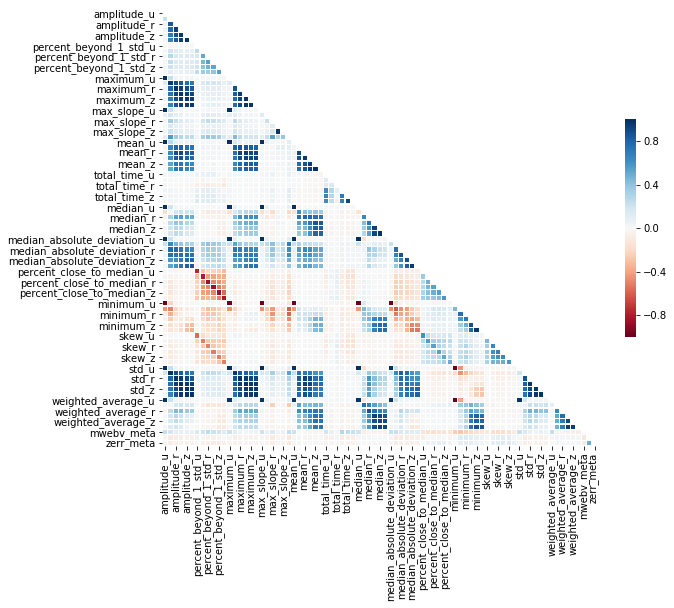

In [46]:
# STARTER KIT
corr = allfeats_df2.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
fig, ax = plt.subplots(figsize=(10, 8))

# Draw the heatmap with the mask and correct aspect ratio
corr_plot = sns.heatmap(corr, mask=mask, cmap='RdBu', center=0,
                square=True, linewidths=.2, cbar_kws={"shrink": .5})

In [ ]:
# Univariate selection 

In [99]:
#apply SelectKBest class to extract best features above the score of 100
bestfeatures = SelectKBest(score_func=f_classif, k=27)
fit = bestfeatures.fit(allfeats_df2, meta_df2['target'])
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(allfeats_df2.columns)

# to show the columns together
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Features','Score']  #naming the dataframe columns
print(featureScores.nlargest(27,'Score'))  #print 27 best features

                       Features       Score
23                  max_slope_y  606.010465
62                       skew_r  535.243563
43  median_absolute_deviation_g  494.631776
63                       skew_i  465.534181
64                       skew_z  408.515620
46  median_absolute_deviation_z  367.152223
47  median_absolute_deviation_y  356.733322
56                    minimum_r  340.459738
55                    minimum_g  327.558549
44  median_absolute_deviation_r  302.360209
45  median_absolute_deviation_i  297.543761
59                    minimum_y  283.728353
8        percent_beyond_1_std_r  283.417128
61                       skew_g  265.574385
58                    minimum_z  254.823493
57                    minimum_i  241.842337
10       percent_beyond_1_std_z  235.586079
9        percent_beyond_1_std_i  233.791394
79                       z_meta  212.508168
52    percent_close_to_median_z  185.792534
51    percent_close_to_median_i  185.351027
50    percent_close_to_median_r 

In [101]:
featureScores

,Features,Score
0,amplitude_u,2.817176
1,amplitude_g,173.299049
2,amplitude_r,60.556245
3,amplitude_i,57.452678
4,amplitude_z,89.560417
5,amplitude_y,103.964171
6,percent_beyond_1_std_u,39.184728
7,percent_beyond_1_std_g,150.473784
8,percent_beyond_1_std_r,283.417128
9,percent_beyond_1_std_i,233.791394


In [90]:
# Random forest feature selection 
f_model = RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='entropy', max_depth=None, max_features='sqrt',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators=400, n_jobs=-1, oob_score=True, random_state=42,
            verbose=0, warm_start=False)
# Feature selection on the training set
f_sel = SelectFromModel(f_model, max_features=10)
f_sel.fit(Xtrain, Ytrain)

SelectFromModel(estimator=RandomForestClassifier(bootstrap=True, class_weight='balanced',
            criterion='entropy', max_depth=None, max_features='sqrt',
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=1,
            min_samples_split=2, min_weight_fraction_leaf=0.0,
            n_estimators=400, n_jobs=-1, oob_score=True, random_state=42,
            verbose=0, warm_start=False),
        max_features=10, norm_order=1, prefit=False, threshold=None)

In [49]:
selected_feat = allfeats_df2.columns[(f_sel.get_support())]
selected_feat

Index(['median_absolute_deviation_g', 'median_absolute_deviation_r',
       'median_absolute_deviation_i', 'median_absolute_deviation_z',
       'median_absolute_deviation_y', 'minimum_g', 'minimum_r', 'minimum_i',
       'z_meta', 'zerr_meta'],
      dtype='object')

In [93]:
newdf = allfeats_df2[allfeats_df2.columns[(f_sel.get_support())]].copy()

In [92]:
newdf

,median_absolute_deviation_g,median_absolute_deviation_r,median_absolute_deviation_i,median_absolute_deviation_z,median_absolute_deviation_y,minimum_g,minimum_r,minimum_i,z_meta,zerr_meta
0,509.248755,368.128510,314.089447,276.594314,291.949630,-1100.440063,-681.858887,-530.644592,0.0000,0.0000
1,4.696852,5.100354,5.484658,5.396183,5.702667,-11.715749,-10.067919,-12.394593,1.6267,0.2552
2,0.995237,1.042533,2.018922,2.596185,5.693106,-3.393080,-2.848838,-5.435799,0.2262,0.0157
3,1.471191,1.416451,2.483005,2.385917,6.977604,-3.618410,-2.159753,-4.944036,0.2813,1.1523
4,1.693956,1.337791,2.086561,2.798773,5.058444,-2.622109,-2.084535,-2.800270,0.2415,0.0176
5,0.750592,0.869686,1.349019,1.560026,4.003411,-2.582174,-2.793446,-3.693207,0.0000,0.0000
6,1.270282,0.930919,1.557122,1.781643,4.137377,-3.504384,-3.254089,-3.270371,0.1820,0.0304
7,0.987020,0.793026,1.565004,3.009263,5.059893,-5.074782,-2.935360,-5.678552,0.7014,0.0100
8,1.265564,2.037065,2.204815,3.045200,6.096489,-8.547652,-3.757573,-4.013668,0.3229,0.3360
9,0.737195,0.889133,1.950880,3.473586,7.699129,-3.843095,-2.316400,-6.478241,0.0000,0.0000


In [952]:
# Recursive feature selection 

In [253]:
rec_sel = RFE(f_model, 10, step=1)
rec_sel = rec_sel.fit(Xtrain, Ytrain)
selected_feat_rec = allfeats_df2.columns[(rec_sel.get_support())]
selected_feat_rec

Index(['median_absolute_deviation_g', 'median_absolute_deviation_r',
       'median_absolute_deviation_y', 'minimum_i', 'skew_i', 'skew_z', 'std_u',
       'std_y', 'z_meta', 'zerr_meta'],
      dtype='object')

### Train again

In [118]:
# to choose best classifier
splitter = StratifiedShuffleSplit(n_splits=1, test_size=0.3, random_state=42)
splits = list(splitter.split(newdf_v2, meta_df2['target']))[0]
train_ind, test_ind = splits
train_ind = train_ind.tolist()
train_ind.sort()

Xtrain_t = np.array(newdf_v2.loc[train_ind, :].values.tolist())
Ytrain_t = np.array(meta_df2['target'][train_ind].values.tolist())

Xtest_t  = np.array(newdf_v2.loc[test_ind, :].values.tolist())
Ytest_t  = np.array(meta_df2['target'][test_ind].values.tolist())

In [119]:
clf_t = RandomForestClassifier(n_estimators=400, criterion='entropy',\
                       oob_score=True, n_jobs=-1, random_state=42
                             , class_weight='balanced', max_features='sqrt')
# Defining the Parameter space
parameter_space = {}
best_clf_t = hyper_clf(clf_t, Xtrain_t, Ytrain_t, parameter_space, n_folds=3)

Hyperparameter space search
Done. (112.1s)
Avg per sample: (112.1s)
Score: 0.708720189331877
Parameters: {}


In [114]:
# Weka forward sel
Ypred = best_clf_t.predict(Xtest_t)
print(classification_report(Ytest_t, Ypred))

              precision    recall  f1-score   support

           6       0.74      0.44      0.56        45
          15       0.53      0.24      0.33       149
          16       0.94      0.98      0.96       277
          42       0.52      0.41      0.46       358
          52       0.00      0.00      0.00        55
          53       0.86      0.67      0.75         9
          62       0.16      0.03      0.06       145
          64       0.68      0.48      0.57        31
          65       0.91      0.96      0.93       294
          67       0.40      0.03      0.06        62
          88       0.89      0.95      0.92       111
          90       0.58      0.91      0.71       694
          92       0.98      0.88      0.93        72
          95       0.88      0.68      0.77        53

   micro avg       0.69      0.69      0.69      2355
   macro avg       0.65      0.55      0.57      2355
weighted avg       0.65      0.69      0.64      2355



In [120]:
# Weka backwards elim
Ypred = best_clf_t.predict(Xtest_t)
print(classification_report(Ytest_t, Ypred))

              precision    recall  f1-score   support

           6       0.91      0.64      0.75        45
          15       0.73      0.64      0.68       149
          16       0.97      0.98      0.97       277
          42       0.62      0.38      0.47       358
          52       0.00      0.00      0.00        55
          53       1.00      0.89      0.94         9
          62       0.54      0.14      0.23       145
          64       0.62      0.32      0.43        31
          65       0.95      0.99      0.97       294
          67       1.00      0.13      0.23        62
          88       0.96      0.98      0.97       111
          90       0.60      0.95      0.74       694
          92       0.96      0.92      0.94        72
          95       0.94      0.55      0.69        53

   micro avg       0.74      0.74      0.74      2355
   macro avg       0.77      0.61      0.64      2355
weighted avg       0.73      0.74      0.70      2355



Weka columns to be dropped after backwards elim for MLP not returning good values, the error values kept rising despite removing features

### Train classifiers on PCA 

We will fit the classifiers on a PCA fit featureset to see if the reduced dimentionality returns close toresults obtained from training classifiers in the full featureset

In [695]:
def score_pca(clf, X_train, X_test, y_train, y_test):
  # train clssifier
  print('Training...',end='')
  time_start = time.time()
  clf.fit(X_train, y_train)
  time_fit = time.time() - time_start
  print('done.', f_time(time_fit))
  
  # predict test data & evaluate
  print('Predicting...',end='')
  time_start = time.time()
  Ypred = clf.predict(X_test)
  Ypred_p = clf.predict_proba(X_test)
  time_predict = time.time() - time_start
  print('done.', f_time(time_predict))
  
  # get information
  model_name = type(clf).__name__

    
  #Cross validation
  score = 0.0
  splitter = StratifiedShuffleSplit(n_splits=4, test_size=0.3, random_state=42)
  splits = list(splitter.split(allfeats, metadata['target']))

  for train, test in splits:
    score = score/2
#     REPLACE THIS SECTION 1:  DEPENDING ON FEATURESET BEING TRAINED ON
    Xtrain = np.array(allfeats_df2.loc[train, :].values.tolist())
    Ytrain = np.array(meta_df2['target'][train].values.tolist())

    Xtest  = np.array(allfeats_df2.loc[train, :].values.tolist())
    Ytest  = np.array(meta_df2['target'][test].values.tolist())
    
    Xtrain_pca = pca.fit_transform(Xtrain)
    Xtest_pca = pca.transform(Xtest)
    
    scores_temp = cross_val_score(clf, Xtrain_pca, Ytrain, cv=2)
    print('Temporary score =', scores_temp.mean())
    score = score+(scores_temp.mean())
    print('Ovr_Score =', score)
    
  #   print("Accuracy: " score.mean())
  accuracy = accuracy_score(y_test, Ypred)
  #   accuracy = score/2
  avg_precision = precision_score(y_test, Ypred, average='weighted')
  avg_recall = recall_score(y_test, Ypred, average='weighted')
  avg_f1_score = f1_score(y_test, Ypred, average='weighted')
  row = {'model_name':model_name,'accuracy':accuracy,'avg_precision':avg_precision,'avg_recall':avg_recall,'avg_f1-score':avg_f1_score,'time_fit':time_fit,'time_predict':time_predict,'classifier_parameters':clf}
  
  # update report df
  global classifier_df_pca
  classifier_df_pca = classifier_df_pca[classifier_df_pca['model_name'] != model_name]
  classifier_df_pca = classifier_df_pca.append(row, ignore_index=True)

  # statistic report
  print('Statistic Report:')
  print(classification_report(y_test, Ypred))
  
  # ROC plot for each target
  skplt.metrics.plot_roc(y_test, Ypred_p,plot_micro=False,plot_macro=False,figsize=(6,6))
  plt.show()

In [237]:
classifier_df_pca = pd.DataFrame(columns=['model_name','accuracy','avg_precision','avg_recall','avg_f1-score','time_fit','time_predict','classifier_parameters'])
classifier_df_pca

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters


In [214]:
classifier_df_pca

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
0,DecisionTreeClassifier,0.375796,0.35456,0.375796,0.263566,0.004713,0.001818,"DecisionTreeClassifier(class_weight=None, crit..."


Training...done. (0.0s)
Predicting...done. (0.0s)
Temporary score = 0.3625729494029225
Ovr_Score = 0.3625729494029225
Temporary score = 0.3460070616851481
Ovr_Score = 0.5272935363866094
Statistic Report:
              precision    recall  f1-score   support

           6       0.36      0.22      0.27        45
          15       0.00      0.00      0.00       149
          16       0.34      0.25      0.29       277
          42       0.00      0.00      0.00       358
          52       0.00      0.00      0.00        55
          53       0.62      0.56      0.59         9
          62       0.00      0.00      0.00       145
          64       0.00      0.00      0.00        31
          65       0.35      0.07      0.12       294
          67       0.00      0.00      0.00        62
          88       0.85      0.15      0.26       111
          90       0.33      0.95      0.49       694
          92       0.84      0.67      0.74        72
          95       0.00      0.00      

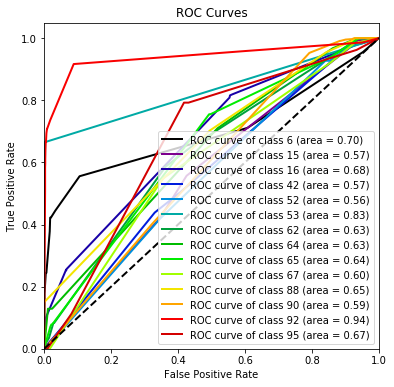

In [238]:
clf_pca0 = DecisionTreeClassifier(max_depth=10,
                   min_samples_leaf=3,
                   splitter='random',
                   criterion='entropy' )

score_pca(clf_pca0, Xtrain_pca, Xtest_pca, Ytrain, Ytest)

Training...done. (9.4s)
Predicting...done. (0.64s)
Temporary score = 0.5193983568338388
Ovr_Score = 0.5193983568338388
Temporary score = 0.5432359189854972
Ovr_Score = 0.8029350974024165
Temporary score = 0.5297713503026948
Ovr_Score = 0.9312388990039031
Temporary score = 0.5248437608126586
Ovr_Score = 0.9904632103146102
Statistic Report:
              precision    recall  f1-score   support

           6       0.40      0.42      0.41        45
          15       0.43      0.56      0.49       149
          16       0.80      0.85      0.82       277
          42       0.32      0.21      0.25       358
          52       0.11      0.04      0.05        55
          53       0.80      0.89      0.84         9
          62       0.21      0.28      0.24       145
          64       0.15      0.16      0.15        31
          65       0.57      0.54      0.56       294
          67       0.16      0.21      0.18        62
          88       0.64      0.68      0.66       111
          

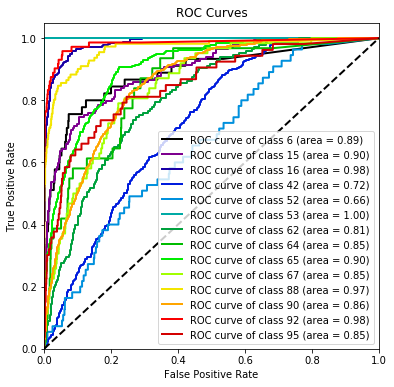

In [701]:
clf_pca1 = RandomForestClassifier(n_estimators=400, min_samples_leaf=3, criterion='entropy',\
                       oob_score=True, n_jobs=-1, random_state=42
                             , class_weight='balanced', max_features='sqrt')
score_pca(clf_pca1, Xtrain_pca, Xtest_pca, Ytrain, Ytest)

Training...done. (108.8s)
Predicting...done. (0.29s)
Temporary score = 0.06321890508086576
Ovr_Score = 0.06321890508086576
Temporary score = 0.1649483736568441
Ovr_Score = 0.19655782619727696
Statistic Report:
              precision    recall  f1-score   support

           6       0.00      0.00      0.00        45
          15       0.08      0.83      0.15       149
          16       0.08      0.09      0.09       277
          42       0.01      0.02      0.02       358
          52       0.00      0.00      0.00        55
          53       0.00      0.00      0.00         9
          62       0.00      0.00      0.00       145
          64       0.00      0.00      0.00        31
          65       0.00      0.00      0.00       294
          67       0.00      0.00      0.00        62
          88       0.00      0.00      0.00       111
          90       0.00      0.00      0.00       694
          92       0.00      0.00      0.00        72
          95       0.14      0.26

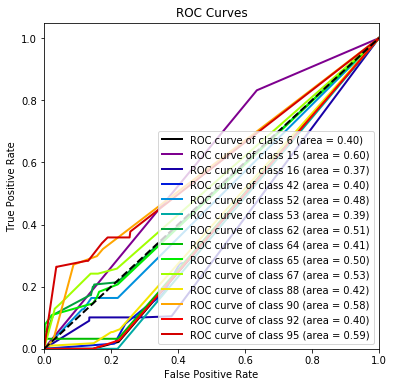

In [242]:
clf_pca2 = GradientBoostingClassifier(n_estimators=300, min_samples_leaf=2, learning_rate=1.0, max_depth=3, random_state=42)

score_pca(clf_pca2, Xtrain_pca, Xtest_pca, Ytrain, Ytest)

Training...done. (0.01s)
Predicting...done. (0.25s)
Temporary score = 0.4953533904917806
Ovr_Score = 0.4953533904917806
Temporary score = 0.5359497282468202
Ovr_Score = 0.7836264234927105
Temporary score = 0.5084723518084133
Ovr_Score = 0.9002855635547686
Temporary score = 0.4995491991374531
Ovr_Score = 0.9496919809148374
Statistic Report:
              precision    recall  f1-score   support

           6       0.48      0.31      0.38        45
          15       0.52      0.23      0.32       149
          16       0.83      0.84      0.84       277
          42       0.27      0.25      0.26       358
          52       0.00      0.00      0.00        55
          53       0.80      0.89      0.84         9
          62       0.20      0.19      0.19       145
          64       0.50      0.06      0.11        31
          65       0.57      0.43      0.49       294
          67       0.00      0.00      0.00        62
          88       0.70      0.57      0.63       111
         

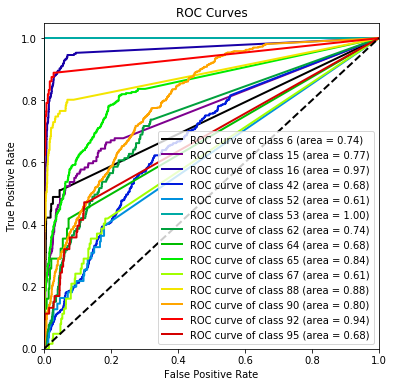

In [251]:
clf_pca3 =  KNeighborsClassifier(n_neighbors=8, weights='distance', p=1, metric='manhattan', algorithm='auto')
score_pca(clf_pca3, Xtrain_pca, Xtest_pca, Ytrain, Ytest)

In [290]:
# Define the scaler 
scaler = StandardScaler().fit(Xtrain_pca)

# Scale the train set
X_train = scaler.transform(Xtrain_pca)

# Scale the test set
X_test = scaler.transform(Xtest_pca)
# Initialize the constructor
clf_pca4 = Sequential()

# Add an input layer 
clf_pca4.add(Dense(12, activation='sigmoid', input_shape=(6,)))
clf_pca4.add(Dense(8, activation='sigmoid'))
# Add an output layer 
clf_pca4.add(Dense(96, activation='sigmoid'))


# build a fairly simple stack of fully-connected layers
#  activation function that you will use, it’s best to use one of the most common 
#  you have an input layer, some hidden layers and an output layer
# irst layer needs to make the input shape clear
# Dense layer, which is a fully connected layer. 

#  two key architecture decisions that you need to make to make your model: how many layers you’re going to use and how many “hidden units” you will chose for each layer.

clf_pca4.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',

             metrics=['accuracy'])
time_start = time.time()
clf_pca4.fit(X_train, Ytrain,epochs=20, batch_size=1, verbose=1)
time_fit = time.time() - time_start

Epoch 1/20
5493/5493 [==============================] - 23s 4ms/step - loss: 2.3308 - acc: 0.2855
Epoch 2/20
5493/5493 [==============================] - 20s 4ms/step - loss: 2.1438 - acc: 0.2947
Epoch 3/20
5493/5493 [==============================] - 20s 4ms/step - loss: 2.1035 - acc: 0.3113
Epoch 4/20
5493/5493 [==============================] - 19s 4ms/step - loss: 2.0748 - acc: 0.3270
Epoch 5/20
5493/5493 [==============================] - 18s 3ms/step - loss: 2.0475 - acc: 0.3393
Epoch 6/20
5493/5493 [==============================] - 19s 3ms/step - loss: 2.0168 - acc: 0.3459
Epoch 7/20
5493/5493 [==============================] - 19s 4ms/step - loss: 1.9842 - acc: 0.3423
Epoch 8/20
5493/5493 [==============================] - 18s 3ms/step - loss: 1.9537 - acc: 0.3443
Epoch 9/20
5493/5493 [==============================] - 19s 3ms/step - loss: 1.9252 - acc: 0.3526
Epoch 10/20
5493/5493 [==============================] - 18s 3ms/step - loss: 1.8990 - acc: 0.3617
Epoch 11/20
5493/54

Statistic Report:
              precision    recall  f1-score   support

           6       0.41      0.24      0.31        45
          15       0.00      0.00      0.00       149
          16       0.53      0.85      0.65       277
          42       0.17      0.02      0.04       358
          52       0.00      0.00      0.00        55
          53       0.00      0.00      0.00         9
          62       0.00      0.00      0.00       145
          64       0.00      0.00      0.00        31
          65       0.00      0.00      0.00       294
          67       0.00      0.00      0.00        62
          88       0.00      0.00      0.00       111
          90       0.37      0.97      0.53       694
          92       0.33      0.01      0.03        72
          95       0.00      0.00      0.00        53

   micro avg       0.39      0.39      0.39      2355
   macro avg       0.13      0.15      0.11      2355
weighted avg       0.21      0.39      0.25      2355



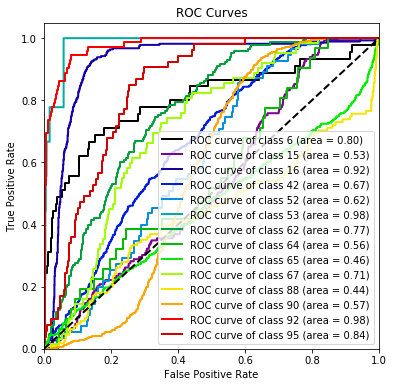

In [296]:
time_start = time.time()
pca_y_pred = clf_pca4.predict(X_test)
time_predict = time.time() - time_start
pca_y_pred = pca_y_pred.tolist()

pred_pca = []
# to get prob values of each target
targets = [6,15,16,42,52,53,62,64,65,67,88,90,92,95]

for i in range(len(pca_y_pred)):
    cell = pca_y_pred[i]
    max_value = max(cell)
    max_index = cell.index(max_value)
    pred_pca.append(max_index)
    pca_y_pred[i] =[ cell[j] for j in targets]
   


score_nn(clf_pca4, Ytest, pred_pca, pca_y_pred)


In [289]:
classifier_df

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
0,DecisionTreeClassifier,0.658599,0.622403,0.658599,0.633317,0.046179,0.003548,"DecisionTreeClassifier(class_weight=None, crit..."
1,GradientBoostingClassifier,0.735881,0.698141,0.735881,0.707270,85.723194,0.128653,([DecisionTreeRegressor(criterion='friedman_ms...
2,GaussianNB,0.164331,0.326756,0.164331,0.171694,0.017304,0.051504,"GaussianNB(priors=None, var_smoothing=1e-09)"
3,KNeighborsClassifier,0.611890,0.603583,0.611890,0.587607,0.013529,6.465613,"KNeighborsClassifier(algorithm='auto', leaf_si..."
4,RandomForestClassifier,0.746921,0.723843,0.746921,0.723008,34.975216,1.028935,"(DecisionTreeClassifier(class_weight=None, cri..."
5,Sequential,0.693843,0.644660,0.693843,0.656660,453.361966,0.086887,<keras.engine.sequential.Sequential object at ...


In [725]:
classifier_df_pca.sort_values(by='accuracy', ascending=False)

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
4,RandomForestClassifier,0.531635,0.521479,0.531635,0.522907,9.399947,0.643043,"(DecisionTreeClassifier(class_weight=None, cri..."
2,KNeighborsClassifier,0.502760,0.489042,0.502760,0.476569,0.006493,0.253171,"KNeighborsClassifier(algorithm='auto', leaf_si..."
3,Sequential,0.393206,0.214523,0.393206,0.245867,378.041669,0.084621,<keras.engine.sequential.Sequential object at ...
0,DecisionTreeClassifier,0.353291,0.257409,0.353291,0.237301,0.002841,0.001483,"DecisionTreeClassifier(class_weight=None, crit..."
1,GradientBoostingClassifier,0.071762,0.020138,0.071762,0.025973,108.802437,0.288875,([DecisionTreeRegressor(criterion='friedman_ms...


### Light curve visualisations 

In [1129]:
# STARTING KIT , The plot_multicolor_lc method was improvised to include line of best fit
class LightCurve(object):
    '''Light curve object for PLAsTiCC formatted data'''
    
    _passbands = OrderedDict([(0,'C4'),\
                              (1,'C2'),\
                              (2,'C3'),\
                              (3,'C1'),\
                              (4,'k'),\
                              (5,'C5')])
    
    _pbnames = ['u','g','r','i','z','y']
    
    #def __init__(self, filename):
    def __init__(self, fluxDF):
        '''Read in light curve data'''

        #self.DFlc     = Table.read(filename, format='ascii.csv')
        self.DFlc     = fluxDF
        #self.filename = filename.replace('.csv','')
        self._finalize()
     
    # this is some simple code to demonstrate how to calculate features on these multiband light curves
    # we're not suggesting using these features specifically
    # there also might be additional pre-processing you do before computing anything
    # it's purely for illustration
    def _finalize(self):
        '''Store individual passband fluxes as object attributes'''
        # in this example, we'll use the weighted mean to normalize the features
        weighted_mean = lambda flux, dflux: np.sum(flux*(flux/dflux)**2)/np.sum((flux/dflux)**2)
        
        # define some functions to compute simple descriptive statistics
        normalized_flux_std = lambda flux, wMeanFlux: np.std(flux/wMeanFlux, ddof = 1)
        normalized_amplitude = lambda flux, wMeanFlux: (np.max(flux) - np.min(flux))/wMeanFlux
        normalized_MAD = lambda flux, wMeanFlux: np.median(np.abs((flux - np.median(flux))/wMeanFlux))
        beyond_1std = lambda flux, wMeanFlux: sum(np.abs(flux - wMeanFlux) > np.std(flux, ddof = 1))/len(flux)
        
        for pb in self._passbands:
            ind = self.DFlc['passband'] == pb
            pbname = self._pbnames[pb]
            
            if len(self.DFlc[ind]) == 0:
                setattr(self, f'{pbname}Std', np.nan)
                setattr(self, f'{pbname}Amp', np.nan)
                setattr(self, f'{pbname}MAD', np.nan)
                setattr(self, f'{pbname}Beyond', np.nan)
                setattr(self, f'{pbname}Skew', np.nan)
                continue
            
            f  = self.DFlc['flux'][ind]
            df = self.DFlc['flux_err'][ind]
            m  = weighted_mean(f, df)
            
            # we'll save the measurements in each passband to simplify access.
            setattr(self, f'{pbname}Flux', f)
            setattr(self, f'{pbname}FluxUnc', df)
            setattr(self, f'{pbname}Mean', m)
            
            # compute the features
            std = normalized_flux_std(f, df)
            amp = normalized_amplitude(f, m)
            mad = normalized_MAD(f, m)
            beyond = beyond_1std(f, m)
            skew = spstat.skew(f) 
            
            # and save the features
            setattr(self, f'{pbname}Std', std)
            setattr(self, f'{pbname}Amp', amp)
            setattr(self, f'{pbname}MAD', mad)
            setattr(self, f'{pbname}Beyond', beyond)
            setattr(self, f'{pbname}Skew', skew)
        
        # we can also construct features between passbands
        pbs = list(self._passbands.keys())
        for i, lpb in enumerate(pbs[0:-1]):
            rpb = pbs[i+1]
            
            lpbname = self._pbnames[lpb]
            rpbname = self._pbnames[rpb]
            
            colname = '{}Minus{}'.format(lpbname, rpbname.upper())
            lMean = getattr(self, f'{lpbname}Mean', np.nan)
            rMean = getattr(self, f'{rpbname}Mean', np.nan)
            col = -2.5*np.log10(lMean/rMean) if lMean> 0 and rMean > 0 else -999
            setattr(self, colname, col)
#    this method was improvised to include the line of best fit
    def plot_multicolor_lc(self, target_id=None):
        '''Plot the multiband light curve'''
        
        # Lomb-Scargle
        model = LombScargleMultiband(fit_period=True)
        # we'll window the search range by setting minimums and maximums here
        # but in general, the search range you want to evaluate will depend on the data
        # and you will not be able to window like this unless you know something about
        # the class of the object a priori
        t_min = max(np.median(np.diff(sorted(self.DFlc['mjd']))), 0.1)
        t_max = min(10., (self.DFlc['mjd'].max() - self.DFlc['mjd'].min())/2.)
        
        model.optimizer.set(period_range=(t_min, t_max), first_pass_coverage=5)
        model.fit(self.DFlc['mjd'], self.DFlc['flux'], dy=self.DFlc['flux_err'], filts=self.DFlc['passband'])
        period = model.best_period
        obj_id = self.DFlc['object_id'][0] # object ID
        print(f'object ID: {obj_id} has a period of {period} days')
        
        phase = (self.DFlc['mjd'] /period) % 1
        
#         fig, axes = plt.subplots(3, 2, figsize=(16,12))
        
        fig, ax = plt.subplots(figsize=(16,12))
#         fig, (ax, ax2) = plt.subplots(ncols=2, figsize=(16,6))

        #if phase is None:
        #    phase = []
        #if len(phase) != len(self.DFlc):
        #    phase = self.DFlc['mjd']
        #    xlabel = 'MJD'
        #else:
        #    xlabel = 'Phase'
          
        for i, pb in enumerate(self._passbands):
#             ax = axes[i // 2, i % 2]
            pbname = self._pbnames[pb]
            print(pbname)
            ind = self.DFlc['passband'] == pb
            if len(self.DFlc[ind]) == 0:
                continue
            # errorbar: plot y versus x as lines and/or markers with attached errorbars
            #ax.errorbar(phase[ind], 
            #         self.DFlc['flux'][ind],
            #         self.DFlc['flux_err'][ind],
            #         fmt = 'o', color = self._passbands[pb], label = f'{pbname}')
            time = self.DFlc['mjd'][ind]
            flux = self.DFlc['flux'][ind]
            ax.errorbar(time, 
                     flux,
                     self.DFlc['flux_err'][ind],
                     fmt = 'o', color = self._passbands[pb], label = f'{pbname}')
            
#             the reason for fit line 
            fit = lightcurve_fit(time, flux)
            stime = np.arange(time.min(), time.max())
            ax.plot(stime, bazin(stime - stime.min(), *fit))
           
            ax.set_xlabel('MJD')
            ax.set_ylabel('flux')
            ax.set_title(pbname+'-band')
#             ax2.errorbar(phase[ind], 
#                      self.DFlc['flux'][ind],
#                      self.DFlc['flux_err'][ind],
#                      fmt = 'o', color = self._passbands[pb], label = f'{pbname}')
        ax.legend(ncol = 4, frameon = True)
        #ax.set_xlabel(f'{xlabel}', fontsize='large')
        ax.set_xlabel('MJD', fontsize='large')
        ax.set_ylabel('Flux', fontsize='large')
#         ax2.legend(ncol = 4, frameon = True)
#         ax2.set_xlabel('Phase', fontsize='large')
#         ax2.set_ylabel('Flux', fontsize='large')
        #fig.suptitle(self.filename, fontsize='x-large')
        fig.suptitle('object ID: ' + str(self.DFlc['object_id'][0]), fontsize='x-large') # graph title = object ID
        fig.tight_layout(rect=[0, 0, 1, 0.97])
    
    def get_features(self):
        '''Return all the features for this object'''
        variables = ['Std', 'Amp', 'MAD', 'Beyond', 'Skew']
        feats = []
        for i, pb in enumerate(self._passbands):
            pbname = self._pbnames[pb]
            feats += [getattr(self, f'{pbname}{x}', np.nan) for x in variables]
        return feats

In [1130]:
# STARTER KIT
def bazin(time, A, B, t0, tfall, trise):
    X = np.exp(-(time - t0) / tfall) / (1 + np.exp((time - t0) / trise))
    return A * X + B


In [1131]:
# STARTER KIT
from scipy.optimize import least_squares

def lightcurve_fit(time, flux):
    scaled_time = time - time.min()
    t0 = scaled_time[flux.argmax()]
    guess = (0, 0, t0, 40, -5)

    errfunc = lambda params: abs(flux - bazin(scaled_time, *params))

    result = least_squares(errfunc, guess, method='lm')

    return result.x


In [1132]:
# metadata
targets = np.asarray(metadata["target"])
classes = np.unique(targets)
classes

array([ 6, 15, 16, 42, 52, 53, 62, 64, 65, 67, 88, 90, 92, 95])

Finding optimal frequency:
 - Estimated peak width = 0.0074
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 10
 - Computing periods at 42018 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
object ID: 18556 has a period of 0.9986256511533524 days
u
g
r
i
z
y
Finding optimal frequency:
 - Estimated peak width = 0.00735
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 10
 - Computing periods at 42307 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
object ID: 4173 has a period of 0.9959704867973175 days
u
g
r
i
z
y
Finding optimal frequency:
 - Estimated peak width = 0.0074
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 10
 - Computing periods at 42018 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
object ID: 2677 has a period of 0.8311056311987652 days
u
g
r
i
z
y
Finding optimal frequency:
 - 

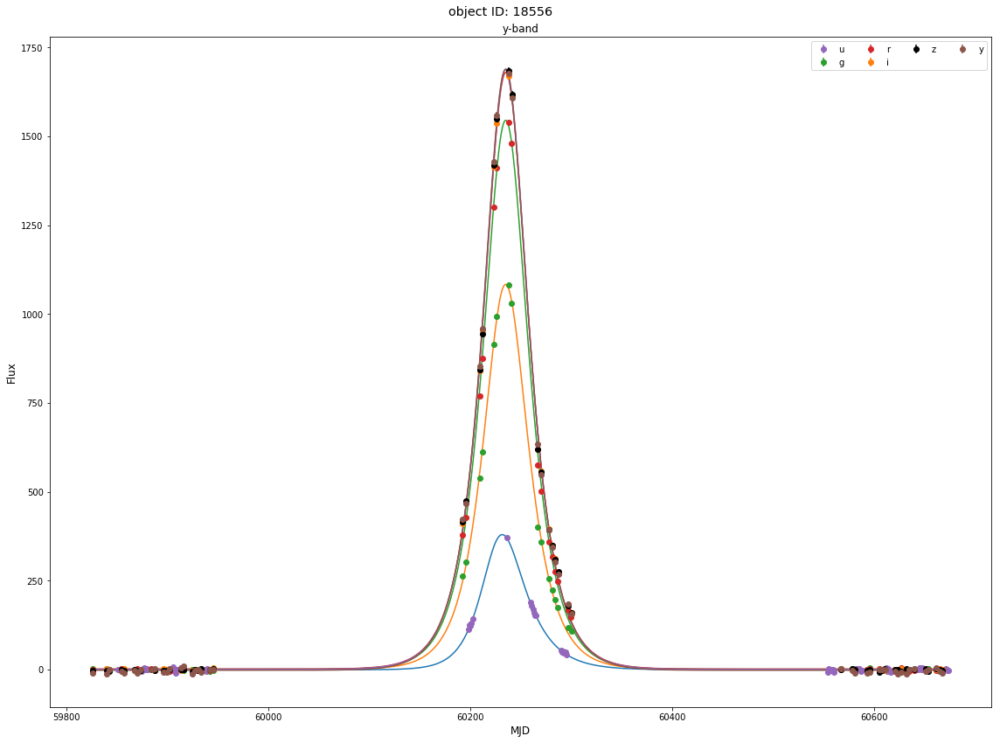

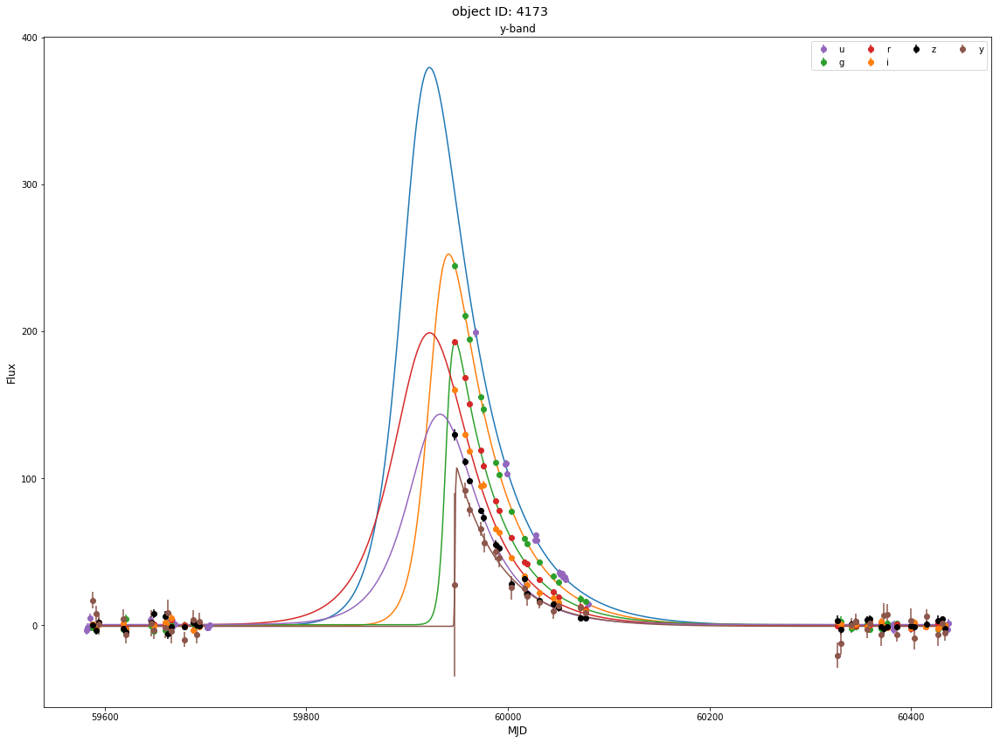

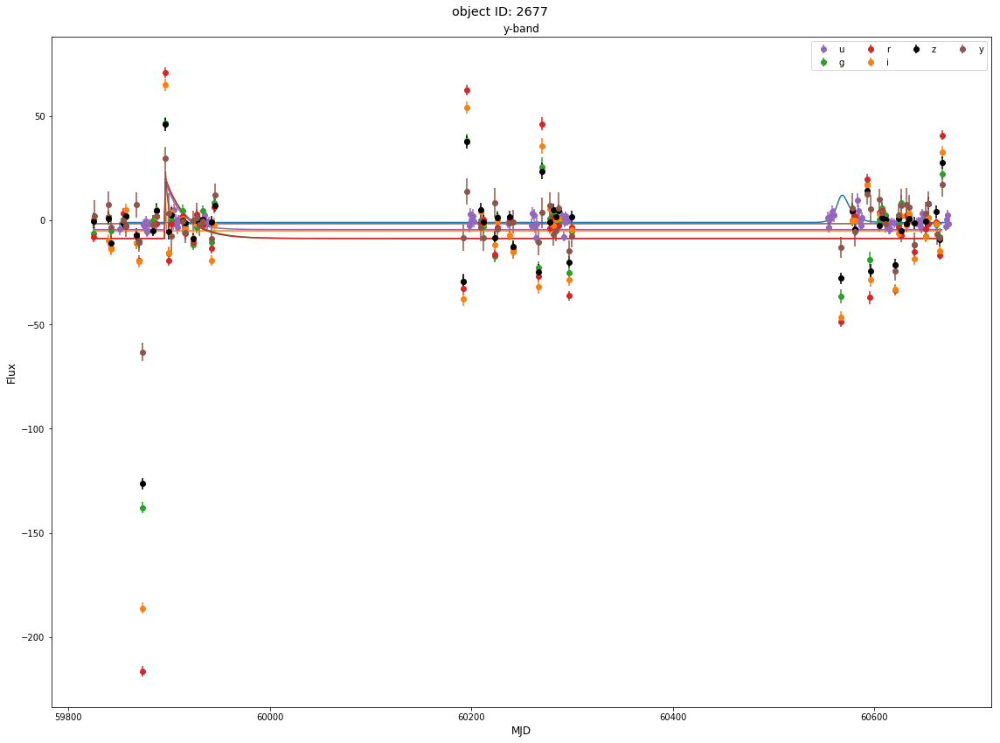

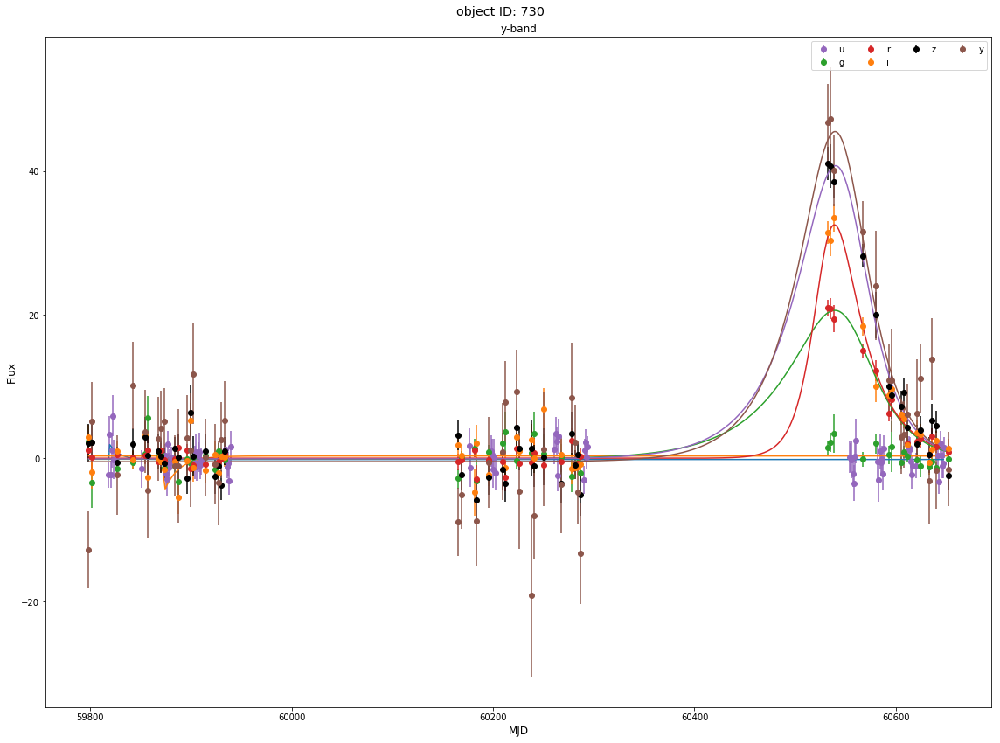

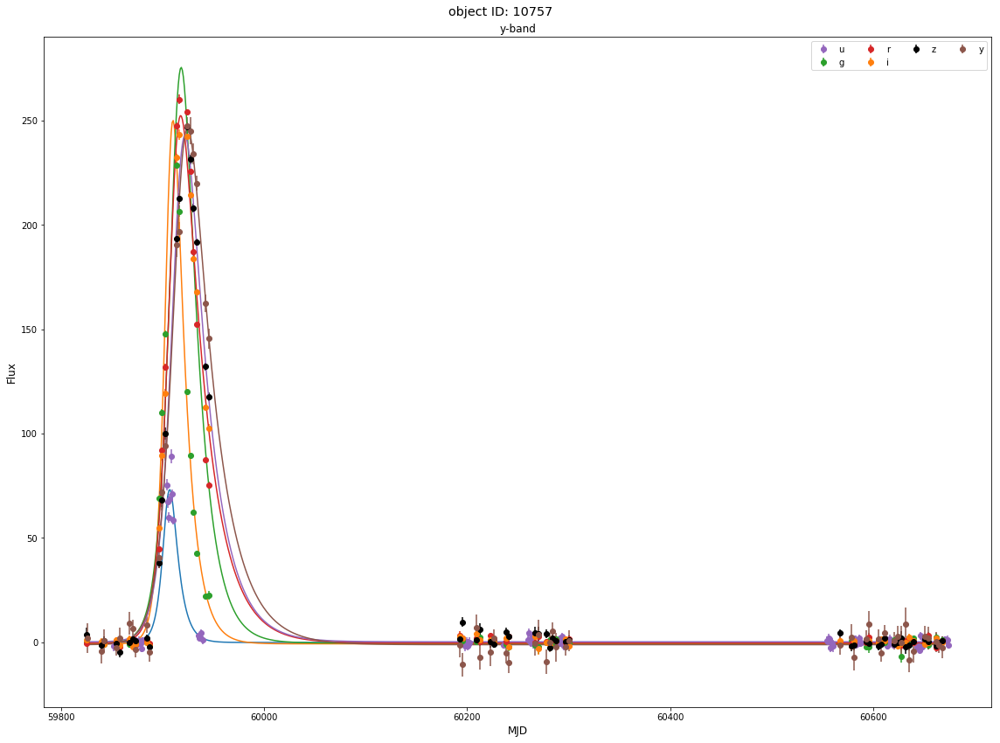

...

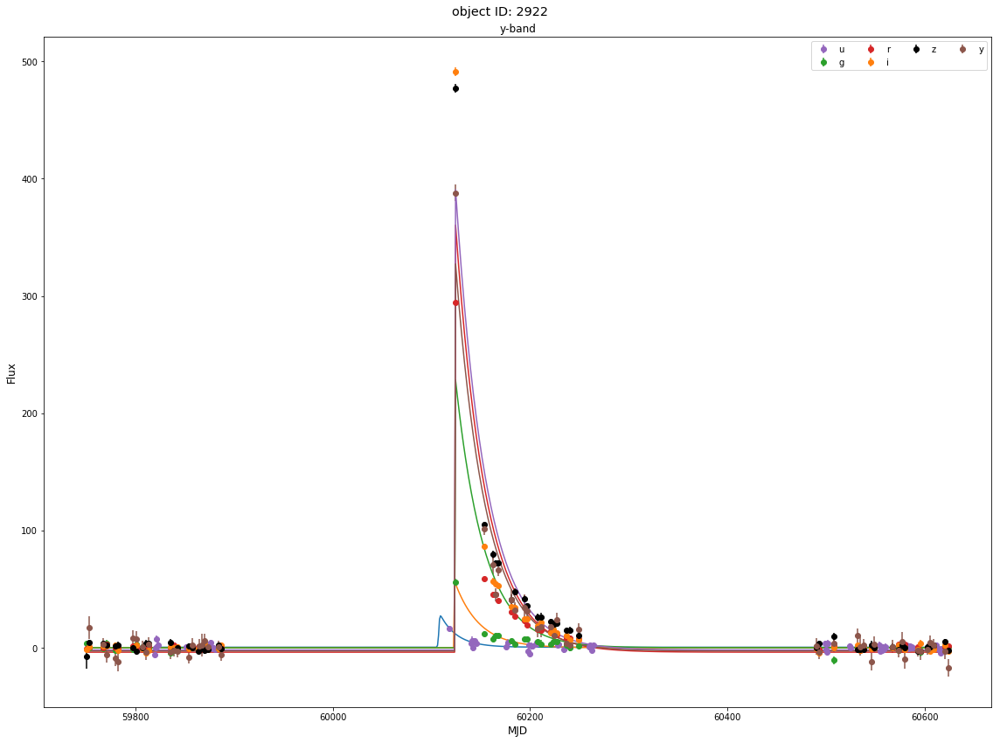

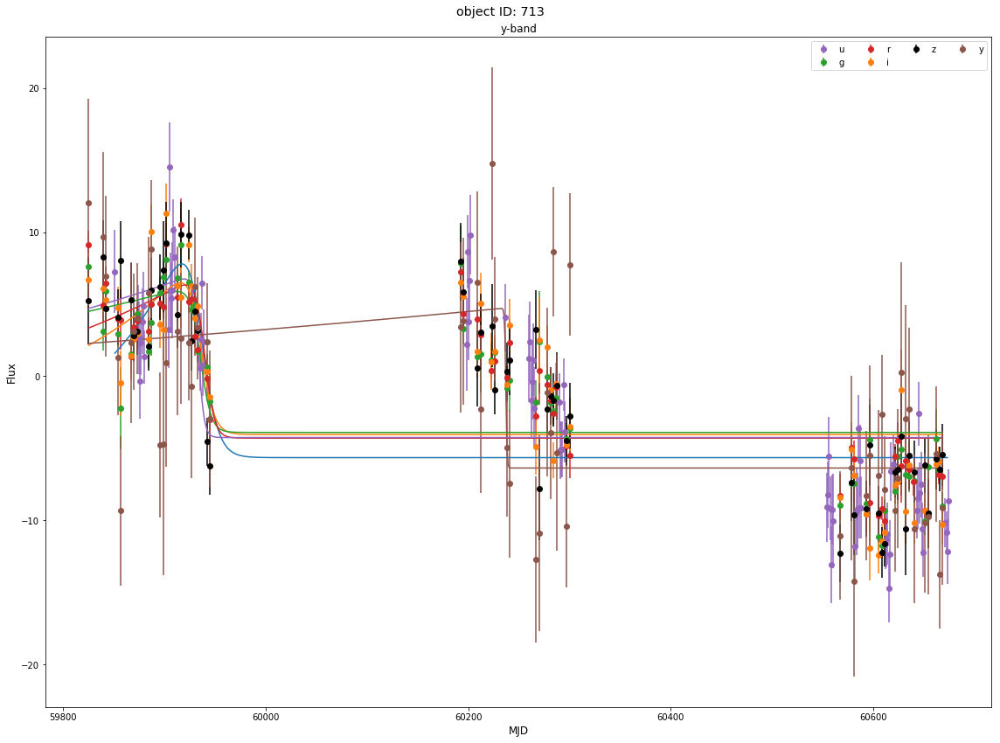

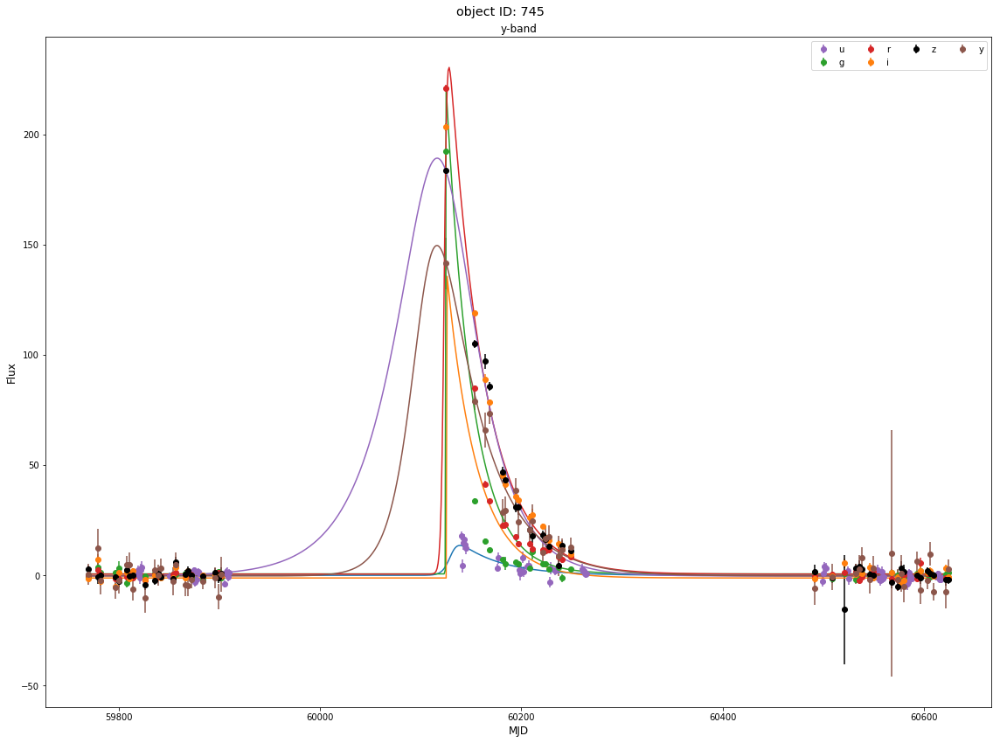

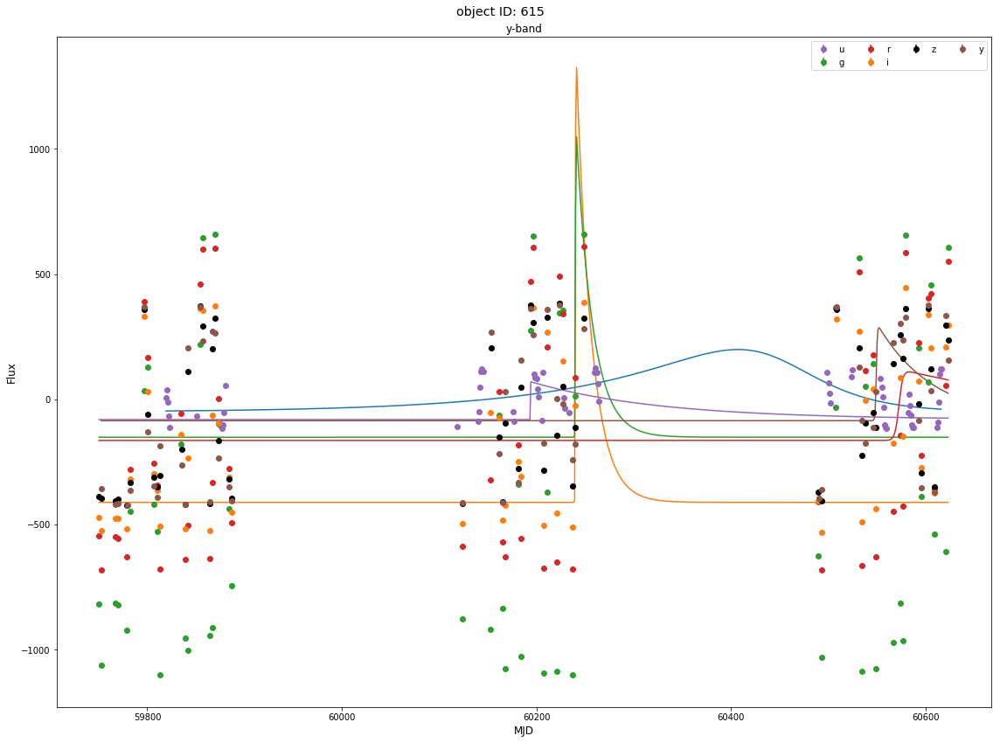

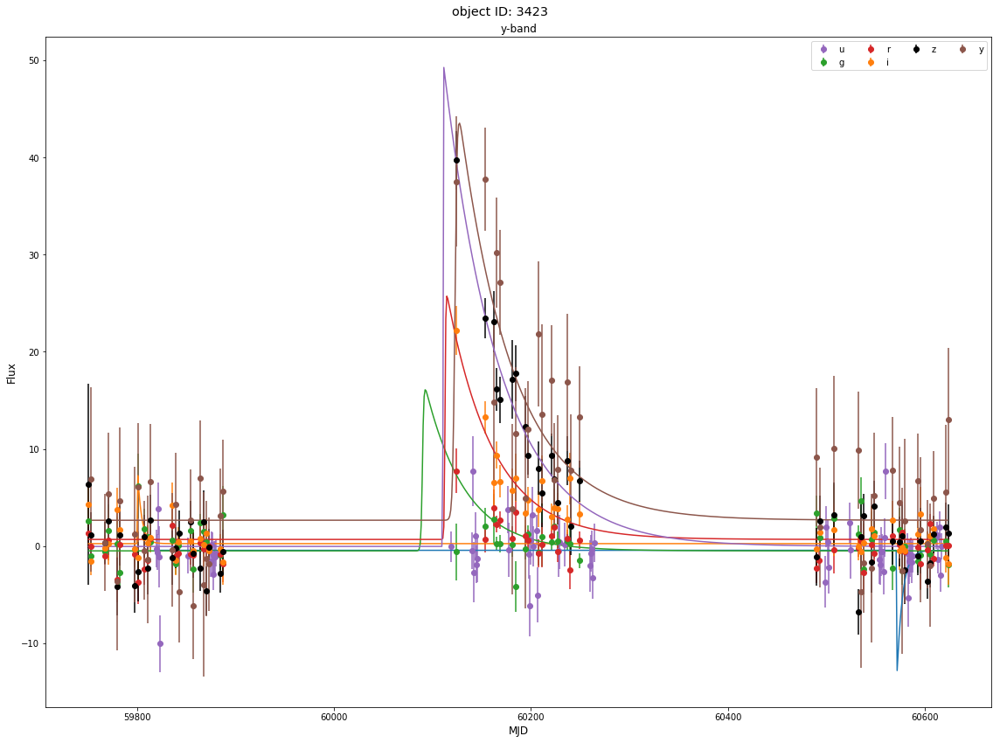

In [1133]:
# Running this method will return the light curve distribution of the first object in each class
count = []
for i in classes:
#     how to find object which is most representative of that target
        currdata = metadata[metadata["target"] == i]
        curr_lcdata = lcdata2[lcdata2['object_id'] == currdata['object_id'][0]]
        curr_lc = LightCurve(curr_lcdata)
        curr_lc.plot_multicolor_lc()

### Changing to binary to identify SnType1a

In [314]:
# Change the name of dataframe in the score method to the one below
classifier_df_b = pd.DataFrame(columns=['model_name','accuracy','avg_precision','avg_recall','avg_f1-score','time_fit','time_predict','classifier_parameters'])
classifier_df_b

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters


In [846]:
# changing to binary classification 
# changing the target into binary identification between Sne and 'other'
new_target = metadata['target'].copy()

for i in range(len(new_met)):
    if metadata['target'][i] == 90:
        new_target[i] = 1
    else:
        new_target[i] = 0


In [769]:
# For future work to identify Sn type 2 only
new_target2 = metadata['target'].copy()

for i in range(len(new_met)):
    if metadata['target'][i] == 42:
        new_target2[i] = 1
    else:
        new_target2[i] = 0

In [820]:
# For future work to identify Sn type ibc only
new_target3 = metadata['target'].copy()

for i in range(len(new_met)):
    if metadata['target'][i] == 62:
        new_target3[i] = 1
    else:
        new_target3[i] = 0

In [819]:
# Combined target
new_target_final = metadata['target'].copy()

for i in range(len(new_met)):
    if metadata['target'][i] == 90:
        new_target_final[i] = 1
    elif metadata['target'][i] == 42:
        new_target_final[i] = 2
    elif metadata['target'][i] == 62:
        new_target_final[i] = 3
    else:
        new_target_final[i] = 0


Before adding sn1a identifying features into the Full featureset we shall first run train the best classifiers on the binary class labels to see how the performance changes 

In [1107]:
# to choose best classifier
splitter = StratifiedShuffleSplit(n_splits=1, test_size=0.3, random_state=42)
splits = list(splitter.split(allfeats_df2, new_target))[0]
train_ind, test_ind = splits
train_ind = train_ind.tolist()
train_ind.sort()

# COPY PASTE THE BOTTOM SECTION INTO SECTION 1, MENTIONED IN Score method
Xtrain = np.array(allfeats_df2.loc[train_ind, :].values.tolist())
Ytrain = np.array(new_target[train_ind].tolist())

Xtest  = np.array(allfeats_df2.loc[test_ind, :].values.tolist())
Ytest  = np.array(new_target[test_ind].tolist())

Hyperparameter space search
Done. (43.77s)
Avg per sample: (43.77s)
Score: 0.8312397596941562
Parameters: {'min_samples_leaf': 3, 'n_estimators': 400}
Training...done. (9.52s)
Predicting...done. (0.42s)
Temporary score = 0.8661910231766784
Ovr_Score = 0.8661910231766784
Temporary score = 0.8638300419716486
Ovr_Score = 1.2969255535599877
Temporary score = 0.8649174695256722
Ovr_Score = 1.513380246305666
Statistic Report:
              precision    recall  f1-score   support

           0       0.92      0.90      0.91      1661
           1       0.77      0.81      0.79       694

   micro avg       0.87      0.87      0.87      2355
   macro avg       0.84      0.85      0.85      2355
weighted avg       0.87      0.87      0.87      2355



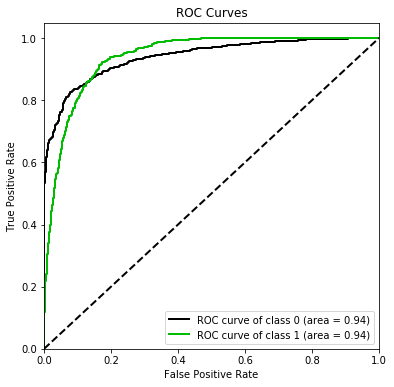

In [902]:
clf_b = RandomForestClassifier(n_estimators=400, criterion='entropy',\
                       oob_score=True, n_jobs=-1, random_state=42
                             , class_weight='balanced', max_features='sqrt')
# Defining the Parameter space
parameter_space = {'min_samples_leaf':[3], 
                   'n_estimators':[400]}
best_clf_b = hyper_clf(clf_b, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf_b, Xtrain, Xtest, Ytrain, Ytest)

Hyperparameter space search
Done. (18.04s)
Avg per sample: (18.04s)
Score: 0.8121245221190606
Parameters: {'learning_rate': 0.1, 'max_depth': 1, 'min_samples_leaf': 2, 'n_estimators': 300}
Training...done. (5.75s)
Predicting...done. (0.01s)
Temporary score = 0.842892013828736
Ovr_Score = 0.842892013828736
Temporary score = 0.8425278139329703
Ovr_Score = 1.2639738208473383
Temporary score = 0.8468961186979999
Ovr_Score = 1.478883029121669
Statistic Report:
              precision    recall  f1-score   support

           0       0.89      0.89      0.89      1661
           1       0.74      0.73      0.74       694

   micro avg       0.85      0.85      0.85      2355
   macro avg       0.81      0.81      0.81      2355
weighted avg       0.84      0.85      0.84      2355



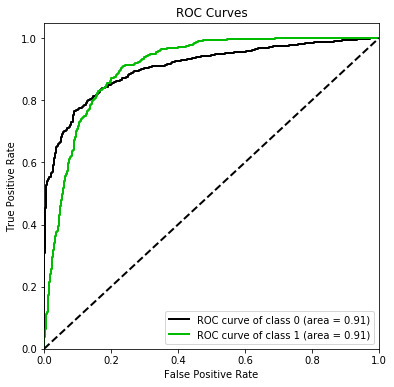

In [1066]:
clf_b1 = GradientBoostingClassifier(n_estimators=300, learning_rate=1.0, max_depth=1, random_state=42)
# Defining the Parameter space
parameter_space = {'learning_rate':[0.1], 
                   'n_estimators':[300],
                  'max_depth':[1],
                  'min_samples_leaf':[2]}
best_clf_b1 = hyper_clf(clf_b1, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf_b1, Xtrain, Xtest, Ytrain, Ytest)

Hyperparameter space search
Done. (10.62s)
Avg per sample: (10.62s)
Score: 0.7263790278536318
Parameters: {'metric': 'manhattan', 'n_neighbors': 8, 'p': 1, 'weights': 'distance'}
Training...done. (0.01s)
Predicting...done. (5.11s)
Temporary score = 0.7769894468802256
Ovr_Score = 0.7769894468802256
Temporary score = 0.7784456470805504
Ovr_Score = 1.1669403705206634
Temporary score = 0.77717269118323
Ovr_Score = 1.3606428764435616
Statistic Report:
              precision    recall  f1-score   support

           0       0.85      0.82      0.84      1661
           1       0.60      0.67      0.63       694

   micro avg       0.77      0.77      0.77      2355
   macro avg       0.73      0.74      0.73      2355
weighted avg       0.78      0.77      0.78      2355



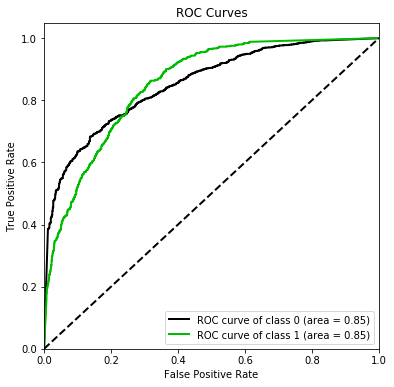

In [1109]:
# kNN
clf_b2 =  KNeighborsClassifier(algorithm='auto')
parameter_space = {'n_neighbors':[8],
                   'weights':['distance'],
                   'p':[1], 
                   'metric':['manhattan']}
best_clf_b2 = hyper_clf(clf_b2, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf_b2, Xtrain, Xtest, Ytrain, Ytest)

In [910]:
# Define the scaler 
scaler = StandardScaler().fit(Xtrain)

# Scale the train set
X_train_b = scaler.transform(Xtrain)

# Scale the test set
X_test_b = scaler.transform(Xtest)
# Initialize the constructor
clf_b3 = Sequential()

# Add an input layer 
clf_b3.add(Dense(30, activation='sigmoid', input_shape=(81,)))
clf_b3.add(Dense(24, activation='sigmoid'))
# Add an output layer 
clf_b3.add(Dense(2, activation='sigmoid'))
#  two key architecture decisions that you need to make to make your model: how many layers you’re going to use and how many “hidden units” you will chose for each layer.

clf_b3.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
             metrics=['accuracy'])
time_start = time.time()
clf_b3.fit(X_train_b, Ytrain,epochs=20, batch_size=1, verbose=1)
time_fit = time.time() - time_start

Epoch 1/20
5493/5493 [==============================] - 29s 5ms/step - loss: 0.5248 - acc: 0.7160
Epoch 2/20
5493/5493 [==============================] - 26s 5ms/step - loss: 0.4754 - acc: 0.7471
Epoch 3/20
5493/5493 [==============================] - 34s 6ms/step - loss: 0.4215 - acc: 0.7863
Epoch 4/20
5493/5493 [==============================] - 37s 7ms/step - loss: 0.3970 - acc: 0.8072
Epoch 5/20
5493/5493 [==============================] - 21s 4ms/step - loss: 0.3834 - acc: 0.8150
Epoch 6/20
5493/5493 [==============================] - 19s 3ms/step - loss: 0.3750 - acc: 0.8232
Epoch 7/20
5493/5493 [==============================] - 20s 4ms/step - loss: 0.3686 - acc: 0.8214
Epoch 8/20
5493/5493 [==============================] - 19s 4ms/step - loss: 0.3628 - acc: 0.8249
Epoch 9/20
5493/5493 [==============================] - 20s 4ms/step - loss: 0.3589 - acc: 0.8291
Epoch 10/20
5493/5493 [==============================] - 20s 4ms/step - loss: 0.3561 - acc: 0.8289
Epoch 11/20
5493/54

Statistic Report:
              precision    recall  f1-score   support

           0       0.91      0.83      0.87      1661
           1       0.67      0.80      0.73       694

   micro avg       0.82      0.82      0.82      2355
   macro avg       0.79      0.82      0.80      2355
weighted avg       0.84      0.82      0.83      2355



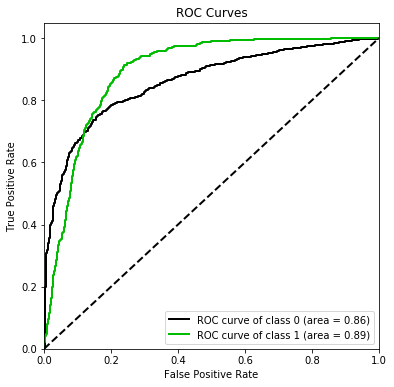

In [1068]:
time_start = time.time()
pred_p = clf_b3.predict(X_test_b)
time_predict = time.time() - time_start
# get array of class label where true = Sne
# pred = pred_p >=0.13 
# pred = pred.astype(int)
pred_p = pred_p.tolist()
pred = []
# to get prob values of each target
targets = [0,1]

for i in range(len(pred_p)):
    cell = pred_p[i]
    max_value = max(cell)
    max_index = cell.index(max_value)
    pred.append(max_index)
    pred_p[i] =[ cell[j] for j in targets]

score_nn(clf_b3, Ytest, pred, pred_p)

In [1076]:
classifier_df_b.sort_values(by=['avg_f1-score'], ascending=False)

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
0,RandomForestClassifier,0.940127,0.921589,0.940127,0.920653,6.825131,0.408086,"(DecisionTreeClassifier(class_weight=None, cri..."
2,GradientBoostingClassifier,0.845435,0.844576,0.845435,0.844972,5.754926,0.012177,([DecisionTreeRegressor(criterion='friedman_ms...
3,Sequential,0.824628,0.839133,0.824628,0.828828,526.447944,0.144173,<keras.engine.sequential.Sequential object at ...
4,Sequential,0.824628,0.839133,0.824628,0.828828,526.447944,0.139568,<keras.engine.sequential.Sequential object at ...
1,KNeighborsClassifier,0.772824,0.780837,0.772824,0.776023,0.013180,6.599684,"KNeighborsClassifier(algorithm='auto', leaf_si..."


In [ ]:
ca_y_pred = clf7.predict(Xtest)
pca_y_pred = pca_y_pred >=0.13 
pca_y_pred = pca_y_pred.astype(int)

### MWUA 

In [618]:
pred = [1]
pred.append(0)
max_index = pred.index(max(pred))
max_index

0

In [1040]:
import random

def choose_index(weights):
#     Generate a number between 0 and total pdf.
    total_weight = sum(weights)
    value = random.uniform(0, sum(weights))
    index = 0
# Walk the list substracting the probability of each item from your number.
    for weight in weights:
        value -= weight
# Pick the item that, after substraction, took your number down to 0 or below.
        if value > 0:
            index += 1
        else:
            break
    
    return index

# return 1 or -1 
# def compare(clf,Xtest,target):
#     pred = clf.predict(Xtest.reshape(1, -1))
#     if pred[0] == target:
#         return 1
#     else:
#         return -1
    
# return 1 or -1 
def compare(pred,target):
#     expected penalty, we can let the penalty for wrong answer be really high like 2
        if pred[0] != target:
#        high penalty
            return 1
        else:
#         low penalty, we can let the penalty for right answer be low but not to the same degree 
            return -1
            
    

# Multiplicative weights
def MWUA(clfs, Xtest, Ytest):
#     once the experts have been trained cumulate them into an array 
    n_clf = len(clfs)
    learning_rate = 1/2
#     assign weight of 1 to all classifiers 
    weights = [1] * n_clf
    preds = []
    preds_p = []
    
    for i in range(len(Xtest)):
        index = choose_index(weights)            
        expt = clfs[index]
#             make prediction 
        prediction = expt.predict(Xtest[i].reshape(1, -1))
        pred_p = expt.predict_proba(Xtest[i].reshape(1, -1))
        penalty = compare(prediction,Ytest[i])
        preds.extend(prediction)
        preds_p.extend(pred_p)
        weights[index] *= (1 + (learning_rate * penalty))

# update the weights, for all or just the chosen expert 
# just expert (option 1) 
#         if penalty < 0:
#             before = weights[index]
#             weights[index] *=  (1+learning_rate)**(-penalty/(weights[index]/sum(weights)))
#             print('correct:', before, ', : after: ,', weights[index])
#         else:
#             before = weights[index]
#             weights[index] *=  (1-learning_rate)**(penalty/(weights[index]/sum(weights)))
#             print('wrong before:', before, ', : after: ,', weights[index])
#         for j in range(len(weights)):
        
          
# set of weights for each classifier(option 2) 
# learning rate parameter max is upto 1/2 in (1-1/2)
#         for j in range(len(weights)):
#                     weights[j] *= (1 + (learning_rate * compare(clfs[j].predict(Xtest[i].reshape(1,-1)), Ytest[i])))
# do you do the weight update first then choose the classifier for the round?
 
 
    return preds, preds_p
 

In [1035]:
best_clf.predict(Xtest[1].reshape(1, -1))

array([15])

In [1036]:
clfs1 = [best_clf, best_clf1, best_clf4]

              precision    recall  f1-score   support

           6       0.75      0.53      0.62        45
          15       0.65      0.61      0.63       149
          16       0.96      0.95      0.95       277
          42       0.49      0.41      0.45       358
          52       0.00      0.00      0.00        55
          53       0.88      0.78      0.82         9
          62       0.35      0.23      0.28       145
          64       0.85      0.35      0.50        31
          65       0.91      0.84      0.87       294
          67       0.47      0.11      0.18        62
          88       0.89      0.92      0.90       111
          90       0.63      0.89      0.74       694
          92       0.92      0.90      0.91        72
          95       0.81      0.49      0.61        53

   micro avg       0.70      0.70      0.70      2355
   macro avg       0.68      0.57      0.60      2355
weighted avg       0.68      0.70      0.67      2355



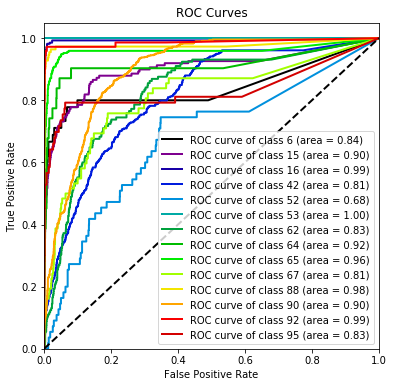

In [1041]:
# MWUA all classifiers weight update results 
YPredsAll1, YPreds_pAll1 = MWUA(clfs1, Xtest, Ytest)
print(classification_report(Ytest, YPredsAll1))
skplt.metrics.plot_roc(Ytest, YPreds_pAll1,plot_micro=False,plot_macro=False,figsize=(6,6))
plt.show()

### Period extraction and Colour Index + Extra features

#### period analysis

In [714]:
# period analysis of a known supernova type 1a object: 745
t, filts, mag, dmag = get_lightcurve(745)

mask = (filts == 2)

t_r, mag_r, dmag_r = t[mask], mag[mask], dmag[mask]

period = periodic.LombScargleFast(fit_period=True)
# max_per = (np.max(t_r) - np.min(t_r))/2

period.optimizer.period_range = (0.2, 800)

period.fit(t_r, mag_r, dmag_r);

Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.2 to 8e+02
 - Computing periods at 21338 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps


In [715]:
period.best_period

727.7120193472645

[(0, 1),
 Text(0, 0.5, 'Lomb Scargle Power'),
 (0.2, 800),
 Text(0.5, 0, 'period (days)')]

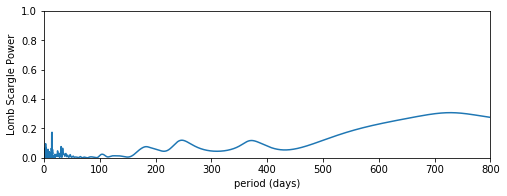

In [716]:
periods = np.linspace(0.2, 800, 10000)

import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    scores = period.score(periods)

# Plot the results
fig, ax = plt.subplots(figsize=(8, 3))
fig.subplots_adjust(bottom=0.2)
ax.plot(periods, scores)
ax.set(xlabel='period (days)', ylabel='Lomb Scargle Power',
       xlim=(0.2, 800), ylim=(0, 1))

This lombscargle scale shows us that Supernovae are not periodic as there is no clear indication(spike in frequency) suggesting periodicity

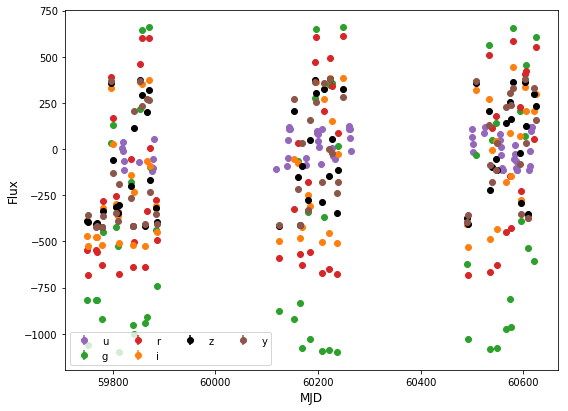

In [705]:
# known periodic object 615
curr_lcdata = lcdata[lcdata['object_id'] == 615]
curr_lc = LightCurve(curr_lcdata)
curr_lc.plot_multicolor_lc()

In [706]:
model2 = LombScargleMultiband(fit_period=True)

model2.optimizer.period_range = (0.2, 800)

model2.fit(curr_lc.DFlc['mjd'], curr_lc.DFlc['flux'], dy=curr_lc.DFlc['flux_err'], filts=curr_lc.DFlc['passband'])

period = model2.best_period

Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.2 to 8e+02
 - Computing periods at 21841 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps


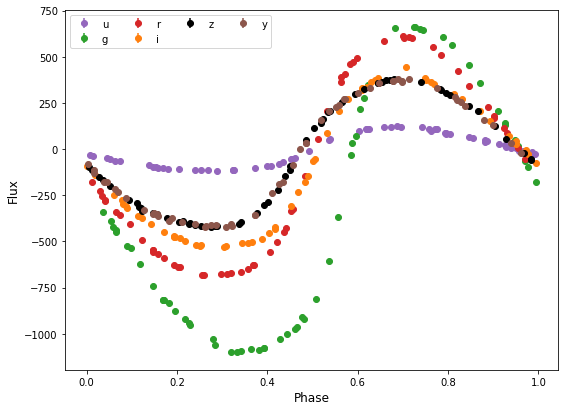

In [707]:
# starter kit
phase = (curr_lc.DFlc['mjd'] /period) % 1
curr_lc.plot_multicolor_lc(phase=phase)

[Text(0, 0.5, 'Lomb Scargle Power'), (0.2, 100), Text(0.5, 0, 'period (days)')]

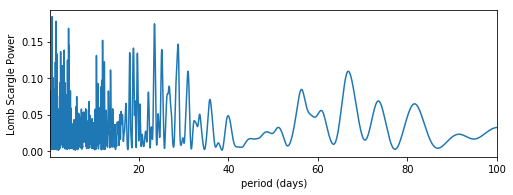

In [960]:
periods = np.linspace(0.2, 100, 10000)

import warnings
with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    scores = model2.score(periods)

# Plot the results
fig, ax = plt.subplots(figsize=(8, 3))
fig.subplots_adjust(bottom=0.2)
ax.plot(periods, scores)
ax.set(xlabel='period (days)', ylabel='Lomb Scargle Power',
       xlim=(0.2, 100))

This shows us three clear spikes above the noise, suggesting periodicity of 0.32

#### Period, col_ind, feature extraction

In [491]:
ex_df = allfeats_df.copy()
ex_df

,amplitude_u,amplitude_g,amplitude_r,amplitude_i,amplitude_z,amplitude_y,percent_beyond_1_std_u,percent_beyond_1_std_g,percent_beyond_1_std_r,percent_beyond_1_std_i,percent_beyond_1_std_z,percent_beyond_1_std_y,maximum_u,maximum_g,maximum_r,maximum_i,maximum_z,maximum_y,max_slope_u,max_slope_g,max_slope_r,max_slope_i,max_slope_z,max_slope_y,mean_u,mean_g,mean_r,mean_i,mean_z,mean_y,total_time_u,total_time_g,total_time_r,total_time_i,total_time_z,total_time_y,median_u,median_g,median_r,median_i,median_z,median_y,median_absolute_deviation_u,median_absolute_deviation_g,median_absolute_deviation_r,median_absolute_deviation_i,median_absolute_deviation_z,median_absolute_deviation_y,percent_close_to_median_u,percent_close_to_median_g,percent_close_to_median_r,percent_close_to_median_i,percent_close_to_median_z,percent_close_to_median_y,minimum_u,minimum_g,minimum_r,minimum_i,minimum_z,minimum_y,skew_u,skew_g,skew_r,skew_i,skew_z,skew_y,std_u,std_g,std_r,std_i,std_z,std_y,weighted_average_u,weighted_average_g,weighted_average_r,weighted_average_i,weighted_average_z,weighted_average_y,mwebv_meta,z_meta,zerr_meta,target
obj_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
615,121.048015,880.533203,646.921722,488.190826,402.069122,400.501617,0.476190,0.586207,0.568966,0.551724,0.517241,0.596491,125.182808,660.626343,611.984558,445.737061,381.953735,378.188141,184.863919,594.695677,423.361104,280.055192,205.475911,226.111645,-3.254554,-385.699911,-134.146566,-121.103501,-55.954592,-47.449847,797.8763,873.7530,873.7531,873.7530,873.7572,871.7697,-10.015225,-488.057969,-265.686004,-162.170944,-103.541366,-85.524307,79.958667,509.248755,368.128510,314.089447,276.594314,291.949630,0.158730,0.172414,0.172414,0.120690,0.155172,0.087719,-116.913223,-1100.440063,-681.858887,-530.644592,-422.184509,-422.815094,0.125827,0.404755,0.331063,0.285492,0.194883,0.121948,83.275842,596.576924,451.180827,332.520885,289.276965,292.182295,-17.061118,-212.397193,-102.220639,-101.206639,-54.744845,-59.688379,0.017,0.0000,0.0000,92
713,14.622504,10.422385,10.298480,11.862455,11.057368,14.491025,0.385714,0.392857,0.410714,0.410714,0.375000,0.392857,14.509829,9.129021,10.529041,11.330316,9.827934,14.770886,11.418733,1.738723,1.798635,2.730983,3.607656,6.128550,-2.720398,-1.019804,-0.794238,-0.986966,-0.900262,-1.794175,822.8792,842.8047,842.8047,842.8141,842.8193,842.8194,-3.096805,-0.561736,-0.117977,-0.073897,-0.792176,-2.463012,6.054598,4.696852,5.100354,5.484658,5.396183,5.702667,0.200000,0.214286,0.178571,0.214286,0.160714,0.232143,-14.735178,-11.715749,-10.067919,-12.394593,-12.286801,-14.211164,0.254446,-0.085494,-0.022066,-0.162664,-0.062403,0.212294,7.062516,5.661101,5.718981,6.392561,6.349526,7.030448,-3.500958,-1.322397,-1.030469,-1.382941,-1.407879,-1.876399,0.007,1.6267,0.2552,88
730,4.701063,4.543094,11.921774,19.503951,23.498145,33.234935,0.333333,0.442308,0.134615,0.115385,0.098039,0.215686,5.942166,5.693109,20.994711,33.572102,41.159981,47.310059,5.987811,2.436376,2.128031,3.727682,3.045581,5.935501,-0.048080,0.141057,2.400870,3.236164,4.308728,4.539396,829.7902,853.8084,853.8084,853.8084,853.8084,853.8084,0.024093,0.171336,0.491791,0.660403,1.004354,2.542647,1.205846,0.995237,1.042533,2.018922,2.596185,5.693106,0.347222,0.500000,0.769231,0.750000,0.745098,0.568627,-3.459960,-3.393080,-2.848838,-5.435799,-5.836310,-19.159811,0.349431,0.457635,2.315707,2.584661,2.462542,1.630520,1.816127,1.789767,5.505767,8.112835,10.604821,13.201397,-0.016423,-0.034170,2.059833,2.988513,4.486335,5.057690,0.021,0.2262,0.0157,42
745,10.944189,97.931352,111.477482,104.097369,99.563790,75.881339,0.180556,0.035714,0.071429,0.089286,0.107143,0.090909,18.014029,192.244293,220.795212,203.250702,183.633118,141.513290,13.567209,5.682263,4.867642,3.393333,3.227811,5.749368,1.797523,5.717394,9.711532,14.412924,13.134436,10.746138,801.9038,853.6685,853.6686,853.6685,853.6684,853.6683,1.056714,0.888115,0.424360,1.361369,1.270150,2.749555,1.72

In [378]:
# method to retrieve the feature values from the global dataframe for a single object
def get_lightcurve(id):
    lcdata_id = lcdata[lcdata['object_id'] == id]
    time = np.asarray(lcdata_id['mjd'].tolist())
    pb = np.asarray(lcdata_id['passband'].tolist())
    flux = np.asarray(lcdata_id['flux'].tolist())
    err = np.asarray(lcdata_id['flux_err'].tolist())
    return time, pb, flux, err

In [379]:
# calculating the period of an object
def calc_per(obj_id):
    time, pbs, flux, err = get_lightcurve(obj_id)
# to save time we check period in one band 
    mask = (pbs == 2)

    time_r, flux_r, err_r = time[mask], flux[mask], err[mask]

    period = periodic.LombScargleFast(fit_period=True)
    max_per = (np.max(time_r) - np.min(time_r))

    period.optimizer.period_range = (0.1, max_per)

    period.fit(time_r, flux_r, err_r);
    return period.best_period

In [380]:
def gr_colourind_gr(obj):
    obj_df = lcdata_df[lcdata_df['object_id'] == obj]
#     colour index of gr (1, 2)
    pbs = obj_df[obj_df['passband'] == 1]
    pbs2 = obj_df[obj_df['passband'] == 2]
    time_g = pbs[pbs['flux'] == pbs['flux'].max()]['mjd'].values[0]
    time_g_min = time_g - 7
    time_g_max = time_g + 7
    
#     retrieve the fisrt val from the resulting df 
    rows = pbs2[(pbs2['mjd'] >= time_g_min) & (pbs2['mjd'] <= time_g_max)]
    if rows.size == 0:
        return 0
    else:
        index = rows.index.values[0]
        return pbs['flux'].max()-rows.loc[index, 'flux']

In [381]:
def gr_colourind_ri(obj):
    obj_df = lcdata_df[lcdata_df['object_id'] == obj]
#     colour index of ri (2, 3)
    pbs = obj_df[obj_df['passband'] == 2]
    pbs2 = obj_df[obj_df['passband'] == 3]
    time_r = pbs[pbs['flux'] == pbs['flux'].max()]['mjd'].values[0]
    time_r_min = time_r - 7
    time_r_max = time_r + 7
    
#     retrieve the fisrt val from the resulting df 
    rows = pbs2[(pbs2['mjd'] >= time_r_min) & (pbs2['mjd'] <= time_r_max)]
    if rows.size == 0:
        return 0
    else:
        index = rows.index.values[0]
        return pbs['flux'].max()-rows.loc[index, 'flux']

In [459]:
def dur(id):
#     duration of lightcurve above a certain noise level
    lcdata_id = lcdata_df[lcdata_df['object_id'] == id].copy()
    lcdata_id = lcdata_id[lcdata_id['passband'] == 1]
    lcdata_id['scaled'] = 0
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(lcdata_id[['flux']].values)
    lcdata_id['scaled'] = x_scaled
    time_arr = lcdata_id[lcdata_id['scaled'] > 0.2]['mjd'].values
    duration = time_arr.max() - time_arr.min()
    return duration

In [485]:
def ex_gal(id):
    if meta_df2[meta_df2['object_id'] == id]['hostgal_specz'].values[0] != 0:
        return 1
    else:
        return 0

In [486]:
# get the period and colour index values from the lcdata and append the computed value to the timeseries table
def param_features(dataframe, lcdata):
    dataframe['period'] = 0
    dataframe['gr_ind'] = 0
    dataframe['ri_ind'] = 0
    dataframe['duration'] = 0
    dataframe['extra_gal'] = 0
    for row in dataframe.itertuples():
        ind = getattr(row, 'Index')
        dataframe.loc[ind, 'period'] = calc_per(ind) 
        dataframe.loc[ind, 'gr_ind'] = gr_colourind_gr(ind)
        dataframe.loc[ind, 'ri_ind'] = gr_colourind_ri(ind) 
        dataframe.loc[ind, 'duration'] = dur(ind) 
        dataframe.loc[ind, 'extra_gal'] = ex_gal(ind) 

In [492]:
param_features(ex_df, lcdata_df)

Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42085 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43684 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42687 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42137 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00736
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00628
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50056 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35199 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00769
 - Using 5 steps per peak; omega_step = 0.00154
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 40835 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00812
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38691 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00785
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40042 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0084
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37384 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50697 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50698 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00807
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 -

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38294 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0116
 - Using 5 steps per peak; omega_step = 0.00232
 - User-specified period range:  0.1 to 5.4e+02
 - Computing periods at 27029 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40136 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00777
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00839
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37439 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38794 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42488 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00833
 - Using 5 steps per peak; omega_step = 0.00167
 - User-specified period range:  0.1 to 7.

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40630 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0133
 - Using 5 steps per peak; omega_step = 0.00266
 - User-specified period range:  0.1 to 4.7e+02
 - Computing periods at 23633 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40280 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00818
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38397 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0118
 - Using 5 steps per peak; omega_step = 0.00237
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26532 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00837
 - Using 5 steps per peak; omega_step = 0.00167
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37546 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00894
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00814
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38595 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00818
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38392 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40337 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50695 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00859
 - Using 5 steps per peak; omega_step = 0.00172
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36548 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39983 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00766
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00821
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38239 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00738
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42538 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40284 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00851
 - Using 5 steps per peak; omega_step = 0.0017
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36894 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00863
 - Using 5 steps per peak; omega_step = 0.00173
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36398 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40290 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00745
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42140 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00818
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38396 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39083 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00793
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38444 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00754
 - Using 5 steps per peak; omega_step = 0.00151
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41683 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40592 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00794
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39576 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00836
 - Using 5 steps per peak; omega_step = 0.00167
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37593 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0126
 - Using 5 steps per peak; omega_step = 0.00252
 - User-specified period range:  0.1 to 5e+02
 - Computing periods at 24941 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00818
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38393 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40340 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00894
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00802
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39146 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42133 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43690 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00891
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7.1e+02
 - Computing periods at 35247 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38446 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00742
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00918
 - Using 5 steps per peak; omega_step = 0.00184
 - User-specified period range:  0.1 to 6.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41990 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00816
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38491 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.012
 - Using 5 steps per peak; omega_step = 0.0024
 - User-specified period range:  0.1 to 5.2e+02
 - Computing periods at 26180 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00766
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00727
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 43236 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00799
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39293 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00802
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39144 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43689 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38441 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00894
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35147 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0079
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39746 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00724
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43384 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00815
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38543 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00809
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00791
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39736 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35197 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41191 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40344 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40634 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36699 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00594
 - Using 5 steps per peak; omega_step = 0.00119
 - User-specified period range:  0.1 to 1.1

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00787
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39894 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00778
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40384 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00881
 - Using 5 steps per peak; omega_step = 0.00176
 - User-specified period range:  0.1 to 7.1e+02
 - Computing periods at 35649 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00846
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00601
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 52298 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00751
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41840 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00795
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39535 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00886
 - Using 5 steps per peak; omega_step = 0.00177
 - User-specified period range:  0.1 to 7.1e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00818
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38397 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40592 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00859
 - Using 5 steps per peak; omega_step = 0.00172
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36548 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00845
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40342 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00778
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40383 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00869
 - Using 5 steps per peak; omega_step = 0.00174
 - User-specified period range:  0.1 to 7.2e+02
 - Computing periods at 36145 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00845
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0092
 - Using 5 steps per peak; omega_step = 0.00184
 - User-specified period range:  0.1 to 6.8e+02
 - Computing periods at 34148 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00594
 - Using 5 steps per peak; omega_step = 0.00119
 - User-specified period range:  0.1 to 1.1e+03
 - Computing periods at 52851 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41082 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00734
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.006
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 52347 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37246 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00239
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26335 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0063
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e+03
 - 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00738
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42581 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00916
 - Using 5 steps per peak; omega_step = 0.00183
 - User-specified period range:  0.1 to 6.9e+02
 - Computing periods at 34300 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39887 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0076
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40283 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40536 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38794 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0079
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00768
 - Using 5 steps per peak; omega_step = 0.00154
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 40892 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00799
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39293 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0076
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41344 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39985 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40585 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39888 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0061
 - Using 5 steps per peak; omega_step = 0.00122
 - User-specified period range:  0.1 to 1e+03
 -

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00238
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26432 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00812
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38691 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0107
 - Using 5 steps per peak; omega_step = 0.00213
 - User-specified period range:  0.1 to 5.9e+02
 - Computing periods at 29430 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0076
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41346 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00894
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35149 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00798
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39388 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38296 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00816
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42489 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00789
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39836 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0079
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39787 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00808
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00815
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38537 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36694 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.006
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 52349 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02


Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00782
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40186 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38443 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43288 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00758
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0121
 - Using 5 steps per peak; omega_step = 0.00242
 - User-specified period range:  0.1 to 5.2e+02
 - Computing periods at 25980 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35199 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39985 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0113
 - Using 5 steps per peak; omega_step = 0.00225
 - User-specified period range:  0.1 to 5.6e+02
 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00755
 - Using 5 steps per peak; omega_step = 0.00151
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41633 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40630 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00615
 - Using 5 steps per peak; omega_step = 0.00123
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 51051 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00857
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00845
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37194 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38297 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39841 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00898
 - Using 5 steps per peak; omega_step = 0.0018
 - User-specified period range:  0.1 to 7e+02


Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0079
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39787 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40343 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00854
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36796 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.006
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03
 - 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00868
 - Using 5 steps per peak; omega_step = 0.00174
 - User-specified period range:  0.1 to 7.2e+02
 - Computing periods at 36193 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39885 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00761
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41280 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00785
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00822
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38193 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00847
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37093 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40237 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00826
 - Using 5 steps per peak; omega_step = 0.00165
 - User-specified period range:  0.1 to 7.6e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42839 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00789
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39836 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00784
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40087 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00708
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44339 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0113
 - Using 5 steps per peak; omega_step = 0.00226
 - User-specified period range:  0.1 to 5.6e+02
 - Computing periods at 27831 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40638 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00796
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00787
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39936 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00627
 - Using 5 steps per peak; omega_step = 0.00125
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50099 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43685 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.5e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40633 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00724
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43382 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00821
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00792
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39683 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41990 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43282 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43286 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40237 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38794 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40540 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00811
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38737 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40237 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00822
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00594
 - Using 5 steps per peak; omega_step = 0.00119
 - User-specified period range:  0.1 to 1.1e+03
 - Computing periods at 52851 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39985 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00819
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38344 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03


Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41189 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44337 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40279 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00816
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38493 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00837
 - Using 5 steps per peak; omega_step = 0.00167
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37540 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50648 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00714
 - Using 5 steps per peak; omega_step = 0.00143
 - User-specified period range:  0.1 to 8.8e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0118
 - Using 5 steps per peak; omega_step = 0.00237
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26532 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00821
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41082 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40583 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0063
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 49848 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00751
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41839 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0085
 - Using 5 steps per peak; omega_step = 0.0017
 - User-specified period range:  0.1 to 7.4e+02
 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42136 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00811
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38742 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50699 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40593 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38295 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0079
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39747 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39095 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41993 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0113
 - Using 5 steps per peak; omega_step = 0.00227
 - User-specified period range:  0.1 to 5.5e+02
 - Computing periods at 27733 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00782
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00239
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26335 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00239
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26331 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42839 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00814
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40535 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0079
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39787 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40237 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00724
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39839 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00814
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38583 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0084
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37384 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00772
 - Using 5 steps per peak; omega_step = 0.00154
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40683 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00618
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50799 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00814
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38595 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00628
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0076
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41332 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40237 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00915
 - Using 5 steps per peak; omega_step = 0.00183
 - User-specified period range:  0.1 to 6.9e+02
 - Computing periods at 34349 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43288 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43691 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40535 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00714
 - Using 5 steps per peak; omega_step = 0.00143
 - User-specified period range:  0.1 to 8.8e+02
 - Computing periods at 43985 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00792
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39683 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41082 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00805
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00802
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39145 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00814
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38591 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00792
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39679 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40632 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00792
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39685 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00814
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38594 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35199 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41992 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38295 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38295 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00624
 - Using 5 steps per peak; omega_step = 0.00125
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50303 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00778
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40383 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50696 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36695 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00857
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36646 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00808
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00847
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37095 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0074
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42437 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00754
 - Using 5 steps per peak; omega_step = 0.00151
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41686 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00802
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38441 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00761
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41288 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00847
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37093 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00759
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00785
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39993 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43291 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00792
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39680 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40593 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40237 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40136 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39090 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00777
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40431 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00767
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 40941 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0087
 - Using 5 steps per peak; omega_step = 0.00174
 - User-specified period range:  0.1 to 7.2

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00894
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35147 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00807
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38938 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00822
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38238 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43291 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00238
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26382 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00795
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39534 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00815
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42136 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40595 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38794 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38443 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00851
 - Using 5 steps per peak; omega_step = 0.0017
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36895 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.008
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39243 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0063
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e+03


Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.006
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 52346 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37244 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0077
 - Using 5 steps per peak; omega_step = 0.00154
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 40782 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00918
 - Using 5 steps per peak; omega_step = 0.00184
 - User-specified period range:  0.1 to 6.8e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38794 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.012
 - Using 5 steps per peak; omega_step = 0.00239
 - User-specified period range:  0.1 to 5.2e+02
 - Computing periods at 26235 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00753
 - Using 5 steps per peak; omega_step = 0.00151
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41733 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35199 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00685
 - Using 5 steps per peak; omega_step = 0.00137
 - User-specified period range:  0.1 to 9.2e+02
 - Computing periods at 45836 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00764
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41134 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03


Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39887 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00802
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39146 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37246 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0118
 - Using 5 steps per peak; omega_step = 0.00237
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26535 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40535 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43283 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00795
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39536 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40230 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00753
 - Using 5 steps per peak; omega_step = 0.00151
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41733 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00789
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39839 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00799
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39293 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43688 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43692 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36693 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40537 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42088 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00784
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40044 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00784
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40087 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00711
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.8e+02
 - Computing periods at 44183 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50696 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00784
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00714
 - Using 5 steps per peak; omega_step = 0.00143
 - User-specified period range:  0.1 to 8.8e+02
 - Computing periods at 43984 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00794
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39546 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00742
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42338 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00826
 - Using 5 steps per peak; omega_step = 0.00165
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38043 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44337 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00787
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39934 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00839
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0114
 - Using 5 steps per peak; omega_step = 0.00228
 - User-specified period range:  0.1 to 5.5e+02
 - Computing periods at 27530 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41984 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40588 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00784
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00853
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36846 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00711
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.8e+02
 - Computing periods at 44184 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00847
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37096 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00742
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00744
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42236 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00646
 - Using 5 steps per peak; omega_step = 0.00129
 - User-specified period range:  0.1 to 9.7e+02
 - Computing periods at 48608 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00882
 - Using 5 steps per peak; omega_step = 0.00176
 - User-specified period range:  0.1 to 7.1e+02
 - Computing periods at 35598 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0077
 - Using 5 steps per peak; omega_step = 0.00154
 - User-specified period range:  0.1 to 8.2e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41990 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00239
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26331 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00724
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43383 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00714
 - Using 5 steps per peak; omega_step = 0.00143
 - User-specified period range:  0.1 to 8.8e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00766
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41036 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00838
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37492 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39943 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40135 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00893
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35196 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00685
 - Using 5 steps per peak; omega_step = 0.00137
 - User-specified period range:  0.1 to 9.2e+02
 - Computing periods at 45836 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00808
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0087
 - Using 5 steps per peak; omega_step = 0.00174
 - User-specified period range:  0.1 to 7.2e+02
 - Computing periods at 36092 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00816
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38490 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40633 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00792
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40143 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00881
 - Using 5 steps per peak; omega_step = 0.00176
 - User-specified period range:  0.1 to 7.1e+02
 - Computing periods at 35648 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0084
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37396 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00792
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38441 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35197 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.006
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 52349 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00881
 - Using 5 steps per peak; omega_step = 0.00176
 - User-specified period range:  0.1 to 7.1e+02
 -

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38443 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43288 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00745
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42138 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40229 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43286 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42489 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40236 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00239
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26330 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00818
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0063
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 49853 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00792
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39646 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39982 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00636
 - Using 5 steps per peak; omega_step = 0.00127
 - User-specified period range:  0.1 to 9.9e+02
 - Computing periods at 49401 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38790 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37243 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40595 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00853
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36846 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00761
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00846
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37145 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00846
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37147 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0076
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41338 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00761
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00238
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26431 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00799
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39293 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00785
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38444 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00819
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38342 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00847
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37092 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00794
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42135 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00808
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38886 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00832
 - Using 5 steps per peak; omega_step = 0.00166
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37734 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00846
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36699 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00812
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38695 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00238
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26435 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00753
 - Using 5 steps per peak; omega_step = 0.00151
 - User-specified period range:  0.1 to 8.3e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40136 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41185 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40236 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00828
 - Using 5 steps per peak; omega_step = 0.00166
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 37945 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38445 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0088
 - Using 5 steps per peak; omega_step = 0.00176
 - User-specified period range:  0.1 to 7.1e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42836 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00742
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36695 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00826
 - Using 5 steps per peak; omega_step = 0.00165
 - User-specified period range:  0.1 to 7.

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0113
 - Using 5 steps per peak; omega_step = 0.00227
 - User-specified period range:  0.1 to 5.5e+02
 - Computing periods at 27733 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39095 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0113
 - Using 5 steps per peak; omega_step = 0.00226
 - User-specified period range:  0.1 to 5.6e+02
 - Computing periods at 27783 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00745
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00789
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39835 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39890 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0063
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 49853 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00766
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41030 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.006
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 52348 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00818
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38396 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00627
 - Using 5 steps per peak; omega_step = 0.00125
 - User-specified period range:  0.1 to 1e+03
 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00629
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 49957 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00591
 - Using 5 steps per peak; omega_step = 0.00118
 - User-specified period range:  0.1 to 1.1e+03
 - Computing periods at 53151 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00742
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00791
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39737 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37247 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0121
 - Using 5 steps per peak; omega_step = 0.00243
 - User-specified period range:  0.1 to 5.2e+02
 - Computing periods at 25885 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00812
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.7

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42842 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00881
 - Using 5 steps per peak; omega_step = 0.00176
 - User-specified period range:  0.1 to 7.1e+02
 - Computing periods at 35648 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00636
 - Using 5 steps per peak; omega_step = 0.00127
 - User-specified period range:  0.1 to 9.9e+02
 - Computing periods at 49400 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00822
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00591
 - Using 5 steps per peak; omega_step = 0.00118
 - User-specified period range:  0.1 to 1.1e+03
 - Computing periods at 53152 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0061
 - Using 5 steps per peak; omega_step = 0.00122
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 51504 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00724
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43382 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00762
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.2e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00818
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38392 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00849
 - Using 5 steps per peak; omega_step = 0.0017
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36995 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00606
 - Using 5 steps per peak; omega_step = 0.00121
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 51799 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40347 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00794
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39545 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00819
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38342 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00793
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00761
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41283 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40542 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35199 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42839 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42536 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41990 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00836
 - Using 5 steps per peak; omega_step = 0.00167
 - User-specified period range:  0.1 to 7.5e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00894
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35150 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00761
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41284 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00615
 - Using 5 steps per peak; omega_step = 0.00123
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 51050 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00771
 - Using 5 steps per peak; omega_step = 0.00154
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40736 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39095 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40349 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0113
 - Using 5 steps per peak; omega_step = 0.00227
 - User-specified period range:  0.1 to 5.5

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40344 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00719
 - Using 5 steps per peak; omega_step = 0.00144
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43686 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41991 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00238
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26382 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40540 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00798
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39342 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0107
 - Using 5 steps per peak; omega_step = 0.00213
 - User-specified period range:  0.1 to 5.9e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50696 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38297 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00791
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39735 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00778
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0113
 - Using 5 steps per peak; omega_step = 0.00225
 - User-specified period range:  0.1 to 5.6e+02
 - Computing periods at 27880 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00851
 - Using 5 steps per peak; omega_step = 0.0017
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36898 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0111
 - Using 5 steps per peak; omega_step = 0.00223
 - User-specified period range:  0.1 to 5.6e+02
 - Computing periods at 28180 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00859
 - Using 5 steps per peak; omega_step = 0.00172
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36548 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00821
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38246 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00734
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42787 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00815
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00836
 - Using 5 steps per peak; omega_step = 0.00167
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37593 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00821
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50699 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00737
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.5e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00623
 - Using 5 steps per peak; omega_step = 0.00125
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50449 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39885 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00839
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37439 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00855
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43288 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40345 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39977 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0082
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0061
 - Using 5 steps per peak; omega_step = 0.00122
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 51504 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0074
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42442 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0113
 - Using 5 steps per peak; omega_step = 0.00225
 - User-specified period range:  0.1 to 5.6e+02
 - Computing periods at 27880 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00771
 - Using 5 steps per peak; omega_step = 0.00154
 - User-specified period range:  0.1 to 8.1e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00785
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40035 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40284 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00627
 - Using 5 steps per peak; omega_step = 0.00125
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50099 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00762
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41244 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00756
 - Using 5 steps per peak; omega_step = 0.00151
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41534 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0107
 - Using 5 steps per peak; omega_step = 0.00213
 - User-specified period range:  0.1 to 5.9e+02
 - Computing periods at 29478 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40630 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40347 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0121
 - Using 5 steps per peak; omega_step = 0.00241
 - User-specified period range:  0.1 to 5.2e+02
 - Computing periods at 26029 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00814
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00742
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40583 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0086
 - Using 5 steps per peak; omega_step = 0.00172
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36547 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00702
 - Using 5 steps per peak; omega_step = 0.0014
 - User-specified period range:  0.1 to 8.9e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00886
 - Using 5 steps per peak; omega_step = 0.00177
 - User-specified period range:  0.1 to 7.1e+02
 - Computing periods at 35443 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00891
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7.1e+02
 - Computing periods at 35248 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00827
 - Using 5 steps per peak; omega_step = 0.00165
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 37995 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00803
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39098 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00739
 - Using 5 steps per peak; omega_step = 0.00148
 - User-specified period range:  0.1 to 8.5e+02
 - Computing periods at 42489 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35198 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.012
 - Using 5 steps per peak; omega_step = 0.0024
 - User-specified period range:  0.1 to 5.2e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00819
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38344 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00825
 - Using 5 steps per peak; omega_step = 0.00165
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38096 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0062
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50651 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00766
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43286 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.006
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 52348 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38447 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40286 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41041 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43291 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00636
 - Using 5 steps per peak; omega_step = 0.00127
 - User-specified period range:  0.1 to 9.9

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00753
 - Using 5 steps per peak; omega_step = 0.00151
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41733 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00853
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36846 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00855
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36745 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00724
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43382 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00837
 - Using 5 steps per peak; omega_step = 0.00167
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37540 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00615
 - Using 5 steps per peak; omega_step = 0.00123
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 51052 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00894
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41037 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0079
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39739 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00797
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39390 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00894
 - Using 5 steps per peak; omega_step = 0.00179
 - User-specified period range:  0.1 to 7

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00795
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39536 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00771
 - Using 5 steps per peak; omega_step = 0.00154
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40736 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42839 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0121
 - Using 5 steps per peak; omega_step = 0.00241
 - User-specified period range:  0.1 to 5.2e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40632 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00958
 - Using 5 steps per peak; omega_step = 0.00192
 - User-specified period range:  0.1 to 6.6e+02
 - Computing periods at 32801 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00803
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39098 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0084
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37395 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00762
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41240 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00594
 - Using 5 steps per peak; omega_step = 0.00119
 - User-specified period range:  0.1 to 1.1e+03
 - Computing periods at 52851 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.006
 - Using 5 steps per peak; omega_step = 0.0012
 - User-specified period range:  0.1 to 1e+03


Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40236 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42843 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39090 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00856
 - Using 5 steps per peak; omega_step = 0.00171
 - User-specified period range:  0.1 to 7.3e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39889 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0121
 - Using 5 steps per peak; omega_step = 0.00241
 - User-specified period range:  0.1 to 5.2e+02
 - Computing periods at 26034 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40131 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00849
 - Using 5 steps per peak; omega_step = 0.0017
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36995 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00764
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00797
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39430 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00809
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38843 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00791
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39732 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00785
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40034 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40136 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00821
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+02
 - Computing periods at 38245 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00239
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26335 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00751
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41839 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00761
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41284 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00847
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41185 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00765
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41084 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00793
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39593 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00812
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00781
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40238 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00864
 - Using 5 steps per peak; omega_step = 0.00173
 - User-specified period range:  0.1 to 7.3e+02
 - Computing periods at 36348 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40345 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00839
 - Using 5 steps per peak; omega_step = 0.00168
 - User-specified period range:  0.1 to 7.5e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00789
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39836 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00782
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40148 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00766
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02


Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00784
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40045 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40343 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39095 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0123
 - Using 5 steps per peak; omega_step = 0.00246
 - User-specified period range:  0.1 to 5.1e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00851
 - Using 5 steps per peak; omega_step = 0.0017
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36894 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00238
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26381 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00627
 - Using 5 steps per peak; omega_step = 0.00125
 - User-specified period range:  0.1 to 1e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00761
 - Using 5 steps per peak; omega_step = 0.00152
 - User-specified period range:  0.1 to 8.3e+02
 - Computing periods at 41282 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39987 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0078
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40280 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00821
 - Using 5 steps per peak; omega_step = 0.00164
 - User-specified period range:  0.1 to 7.6e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00748
 - Using 5 steps per peak; omega_step = 0.0015
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 41992 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00594
 - Using 5 steps per peak; omega_step = 0.00119
 - User-specified period range:  0.1 to 1.1e+03
 - Computing periods at 52851 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00709
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.9e+02
 - Computing periods at 44336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00764
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41128 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00774
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40595 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00846
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 37148 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00743
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.5

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00782
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40186 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e+02
 - Computing periods at 42841 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00591
 - Using 5 steps per peak; omega_step = 0.00118
 - User-specified period range:  0.1 to 1.1e+03
 - Computing periods at 53152 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0107
 - Using 5 steps per peak; omega_step = 0.00213
 - User-specified period range:  0.1 to 5.9e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00812
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38689 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00843
 - Using 5 steps per peak; omega_step = 0.00169
 - User-specified period range:  0.1 to 7.5e+02
 - Computing periods at 37247 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0107
 - Using 5 steps per peak; omega_step = 0.00213
 - User-specified period range:  0.1 to 5.9e+02
 - Computing periods at 29430 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0111
 - Using 5 steps per peak; omega_step = 0.00222
 - User-specified period range:  0.1 to 5.7e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35198 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00618
 - Using 5 steps per peak; omega_step = 0.00124
 - User-specified period range:  0.1 to 1e+03
 - Computing periods at 50799 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00766
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41028 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00788
 - Using 5 steps per peak; omega_step = 0.00158
 - User-specified period range:  0.1 to 8e+02


Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00808
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38888 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 38790 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00814
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38591 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0081
 - Using 5 steps per peak; omega_step = 0.00162
 - User-specified period range:  0.1 to 7.8e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00783
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40133 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40633 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43283 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00733
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35199 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00745
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e+02
 - Computing periods at 42138 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43289 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00745
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 8.4e

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00804
 - Using 5 steps per peak; omega_step = 0.00161
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39089 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00787
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 39927 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00802
 - Using 5 steps per peak; omega_step = 0.0016
 - User-specified period range:  0.1 to 7.8e+02
 - Computing periods at 39145 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00734
 - Using 5 steps per peak; omega_step = 0.00147
 - User-specified period range:  0.1 to 8.6

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0085
 - Using 5 steps per peak; omega_step = 0.0017
 - User-specified period range:  0.1 to 7.4e+02
 - Computing periods at 36947 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00763
 - Using 5 steps per peak; omega_step = 0.00153
 - User-specified period range:  0.1 to 8.2e+02
 - Computing periods at 41189 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00797
 - Using 5 steps per peak; omega_step = 0.00159
 - User-specified period range:  0.1 to 7.9e+02
 - Computing periods at 39430 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00817
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0119
 - Using 5 steps per peak; omega_step = 0.00238
 - User-specified period range:  0.1 to 5.3e+02
 - Computing periods at 26435 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.0107
 - Using 5 steps per peak; omega_step = 0.00213
 - User-specified period range:  0.1 to 5.9e+02
 - Computing periods at 29430 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43286 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00773
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00785
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 - Computing periods at 40036 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00775
 - Using 5 steps per peak; omega_step = 0.00155
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40534 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00892
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7e+02
 - Computing periods at 35197 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00786
 - Using 5 steps per peak; omega_step = 0.00157
 - User-specified period range:  0.1 to 8e+02
 -

Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43285 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00779
 - Using 5 steps per peak; omega_step = 0.00156
 - User-specified period range:  0.1 to 8.1e+02
 - Computing periods at 40336 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00889
 - Using 5 steps per peak; omega_step = 0.00178
 - User-specified period range:  0.1 to 7.1e+02
 - Computing periods at 35348 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 995 steps
Finding optimal frequency:
 - Estimated peak width = 0.00628
 - Using 5 steps per peak; omega_step = 0.00126
 - User-specified period range:  0.1 to 1e+0

Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00815
 - Using 5 steps per peak; omega_step = 0.00163
 - User-specified period range:  0.1 to 7.7e+02
 - Computing periods at 38543 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00726
 - Using 5 steps per peak; omega_step = 0.00145
 - User-specified period range:  0.1 to 8.7e+02
 - Computing periods at 43290 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00711
 - Using 5 steps per peak; omega_step = 0.00142
 - User-specified period range:  0.1 to 8.8e+02
 - Computing periods at 44183 steps
Zooming-in on 5 candidate peaks:
 - Computing periods at 1000 steps
Finding optimal frequency:
 - Estimated peak width = 0.00746
 - Using 5 steps per peak; omega_step = 0.00149
 - User-specified period range:  0.1 to 

In [493]:
ex_df

,amplitude_u,amplitude_g,amplitude_r,amplitude_i,amplitude_z,amplitude_y,percent_beyond_1_std_u,percent_beyond_1_std_g,percent_beyond_1_std_r,percent_beyond_1_std_i,percent_beyond_1_std_z,percent_beyond_1_std_y,maximum_u,maximum_g,maximum_r,maximum_i,maximum_z,maximum_y,max_slope_u,max_slope_g,max_slope_r,max_slope_i,max_slope_z,max_slope_y,mean_u,mean_g,mean_r,mean_i,mean_z,mean_y,total_time_u,total_time_g,total_time_r,total_time_i,total_time_z,total_time_y,median_u,median_g,median_r,median_i,median_z,median_y,median_absolute_deviation_u,median_absolute_deviation_g,median_absolute_deviation_r,median_absolute_deviation_i,median_absolute_deviation_z,median_absolute_deviation_y,percent_close_to_median_u,percent_close_to_median_g,percent_close_to_median_r,percent_close_to_median_i,percent_close_to_median_z,percent_close_to_median_y,minimum_u,minimum_g,minimum_r,minimum_i,minimum_z,minimum_y,skew_u,skew_g,skew_r,skew_i,skew_z,skew_y,std_u,std_g,std_r,std_i,std_z,std_y,weighted_average_u,weighted_average_g,weighted_average_r,weighted_average_i,weighted_average_z,weighted_average_y,mwebv_meta,z_meta,zerr_meta,target,period,gr_ind,ri_ind,duration,extra_gal
obj_id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
615,121.048015,880.533203,646.921722,488.190826,402.069122,400.501617,0.476190,0.586207,0.568966,0.551724,0.517241,0.596491,125.182808,660.626343,611.984558,445.737061,381.953735,378.188141,184.863919,594.695677,423.361104,280.055192,205.475911,226.111645,-3.254554,-385.699911,-134.146566,-121.103501,-55.954592,-47.449847,797.8763,873.7530,873.7531,873.7530,873.7572,871.7697,-10.015225,-488.057969,-265.686004,-162.170944,-103.541366,-85.524307,79.958667,509.248755,368.128510,314.089447,276.594314,291.949630,0.158730,0.172414,0.172414,0.120690,0.155172,0.087719,-116.913223,-1100.440063,-681.858887,-530.644592,-422.184509,-422.815094,0.125827,0.404755,0.331063,0.285492,0.194883,0.121948,83.275842,596.576924,451.180827,332.520885,289.276965,292.182295,-17.061118,-212.397193,-102.220639,-101.206639,-54.744845,-59.688379,0.017,0.0000,0.0000,92,0.324499,48.641785,225.672638,841.9862,0
713,14.622504,10.422385,10.298480,11.862455,11.057368,14.491025,0.385714,0.392857,0.410714,0.410714,0.375000,0.392857,14.509829,9.129021,10.529041,11.330316,9.827934,14.770886,11.418733,1.738723,1.798635,2.730983,3.607656,6.128550,-2.720398,-1.019804,-0.794238,-0.986966,-0.900262,-1.794175,822.8792,842.8047,842.8047,842.8141,842.8193,842.8194,-3.096805,-0.561736,-0.117977,-0.073897,-0.792176,-2.463012,6.054598,4.696852,5.100354,5.484658,5.396183,5.702667,0.200000,0.214286,0.178571,0.214286,0.160714,0.232143,-14.735178,-11.715749,-10.067919,-12.394593,-12.286801,-14.211164,0.254446,-0.085494,-0.022066,-0.162664,-0.062403,0.212294,7.062516,5.661101,5.718981,6.392561,6.349526,7.030448,-3.500958,-1.322397,-1.030469,-1.382941,-1.407879,-1.876399,0.007,1.6267,0.2552,88,0.996609,3.653785,4.253713,839.8037,1
730,4.701063,4.543094,11.921774,19.503951,23.498145,33.234935,0.333333,0.442308,0.134615,0.115385,0.098039,0.215686,5.942166,5.693109,20.994711,33.572102,41.159981,47.310059,5.987811,2.436376,2.128031,3.727682,3.045581,5.935501,-0.048080,0.141057,2.400870,3.236164,4.308728,4.539396,829.7902,853.8084,853.8084,853.8084,853.8084,853.8084,0.024093,0.171336,0.491791,0.660403,1.004354,2.542647,1.205846,0.995237,1.042533,2.018922,2.596185,5.693106,0.347222,0.500000,0.769231,0.750000,0.745098,0.568627,-3.459960,-3.393080,-2.848838,-5.435799,-5.836310,-19.159811,0.349431,0.457635,2.315707,2.584661,2.462542,1.630520,1.816127,1.789767,5.505767,8.112835,10.604821,13.201397,-0.016423,-0.034170,2.059833,2.988513,4.486335,5.057690,0.021,0.2262,0.0157,42,431.652376,5.324178,-10.528377,853.8084,1
745,10.944189,97.931352,111.477482,104.097369,99.563790,75.881339,0.180556,0.035714,0.071429,0.089286,0.107143,0.090909,18.014029,192.244293,220.795212,203.250702,183.633118,141.513290,13.567209,5.682263,4.867642,3.393333,3.227811,5.749368,1.7

### Normalised Compression Distance

In [ ]:
In order to identify what the representative set of feature values is for a supernovae1a, we try different methods
METHOD 1: retrieve a single example from the dataframe to be compressed and compared against other objects
    METHOD 2: Retriev mean values of all features and do the same
        METHOD 3: retrieve a dataframe with only sn1a objects to be compressed

In [389]:
# get df of SNe 
target = ex_df[ex_df['target'] == 90].copy()
target.shape

(2, 85)

In [390]:
def ncd_lzma_fin(target_df, cx, ybytes):

    cy = lzma.compress(ybytes)
    cxy = lzma.compress(target_df.to_records(index=False).tostring())
    if len(cy) > len(cx):
#         print("cy :" + str(len(cy)))
        n = (len(cxy) - len(cx)) / float(len(cy))
    else:
#         print("cx :" + str(len(cx)))
        n = (len(cxy) - len(cy)) / float(len(cx))
    return n

In [391]:
def compress_v2(targetframe, dataframe):
#   construct an ndarray that allows field access using attributes then to string
    cx = lzma.compress(targetframe.to_records(index=False).tostring())
#     for each row, we compare it with all other 
    dist_arr = []
    for row in dataframe.itertuples():
        ind = getattr(row, 'Index')
        curr_row = dataframe.loc[ind, :].values.tolist()
#         get pairs of rows where one row is SNe information
#     struct packs the list of floats into bytes 
        ybytes = struct.pack('%sf' % len(curr_row), *curr_row)
#     add the curr row to target df 
        temp_df = targetframe.copy()
        temp_df.loc[ind] = curr_row
        
        distance = ncd_lzma_fin(temp_df, cx, ybytes)
        dist_arr.append(distance)
        
    dataframe['nc_lzma'] = dist_arr
    

uncomment the compress_v2 method in order to run the compression technique and add the comressed values to the final dataframe
the compression method takes around 2-3 hours, 
therefore I have saved a dataframe of the final dataset with the compressed values stored in the last column

In [394]:
# compress_v2(target, ex_df)

t_feats_df_compress_fin.to_csv(path_or_buf='data/compressed_df.csv', index=False)

In [545]:
ex_df

,obj_id,amplitude_u,amplitude_g,amplitude_r,amplitude_i,amplitude_z,amplitude_y,percent_beyond_1_std_u,percent_beyond_1_std_g,percent_beyond_1_std_r,percent_beyond_1_std_i,percent_beyond_1_std_z,percent_beyond_1_std_y,maximum_u,maximum_g,maximum_r,maximum_i,maximum_z,maximum_y,max_slope_u,max_slope_g,max_slope_r,max_slope_i,max_slope_z,max_slope_y,mean_u,mean_g,mean_r,mean_i,mean_z,mean_y,total_time_u,total_time_g,total_time_r,total_time_i,total_time_z,total_time_y,median_u,median_g,median_r,median_i,median_z,median_y,median_absolute_deviation_u,median_absolute_deviation_g,median_absolute_deviation_r,median_absolute_deviation_i,median_absolute_deviation_z,median_absolute_deviation_y,percent_close_to_median_u,percent_close_to_median_g,percent_close_to_median_r,percent_close_to_median_i,percent_close_to_median_z,percent_close_to_median_y,minimum_u,minimum_g,minimum_r,minimum_i,minimum_z,minimum_y,skew_u,skew_g,skew_r,skew_i,skew_z,skew_y,std_u,std_g,std_r,std_i,std_z,std_y,weighted_average_u,weighted_average_g,weighted_average_r,weighted_average_i,weighted_average_z,weighted_average_y,mwebv_meta,z_meta,zerr_meta,target,period,gr_ind,ri_ind,duration,extra_gal,nc_lzma
0,615,121.048015,880.533203,646.921722,488.190826,402.069122,400.501617,0.476190,0.586207,0.568966,0.551724,0.517241,0.596491,125.182808,660.626343,611.984558,445.737061,381.953735,378.188141,184.863919,594.695677,423.361104,280.055192,205.475911,226.111645,-3.254554,-385.699911,-134.146566,-121.103501,-55.954592,-47.449847,797.8763,873.7530,873.7531,873.7530,873.7572,871.7697,-10.015225,-488.057969,-265.686004,-162.170944,-103.541366,-85.524307,79.958667,509.248755,368.128510,314.089447,276.594314,291.949630,0.158730,0.172414,0.172414,0.120690,0.155172,0.087719,-116.913223,-1100.440063,-681.858887,-530.644592,-422.184509,-422.815094,0.125827,0.404755,0.331063,0.285492,0.194883,0.121948,83.275842,596.576924,451.180827,332.520885,289.276965,292.182295,-17.061118,-212.397193,-102.220639,-101.206639,-54.744845,-59.688379,0.017,0.0000,0.0000,92,0.324499,48.641785,225.672638,841.9862,0,1.000023
1,713,14.622504,10.422385,10.298480,11.862455,11.057368,14.491025,0.385714,0.392857,0.410714,0.410714,0.375000,0.392857,14.509829,9.129021,10.529041,11.330316,9.827934,14.770886,11.418733,1.738723,1.798635,2.730983,3.607656,6.128550,-2.720398,-1.019804,-0.794238,-0.986966,-0.900262,-1.794175,822.8792,842.8047,842.8047,842.8141,842.8193,842.8194,-3.096805,-0.561736,-0.117977,-0.073897,-0.792176,-2.463012,6.054598,4.696852,5.100354,5.484658,5.396183,5.702667,0.200000,0.214286,0.178571,0.214286,0.160714,0.232143,-14.735178,-11.715749,-10.067919,-12.394593,-12.286801,-14.211164,0.254446,-0.085494,-0.022066,-0.162664,-0.062403,0.212294,7.062516,5.661101,5.718981,6.392561,6.349526,7.030448,-3.500958,-1.322397,-1.030469,-1.382941,-1.407879,-1.876399,0.007,1.6267,0.2552,88,0.996609,3.653785,4.253713,839.8037,1,1.000000
2,730,4.701063,4.543094,11.921774,19.503951,23.498145,33.234935,0.333333,0.442308,0.134615,0.115385,0.098039,0.215686,5.942166,5.693109,20.994711,33.572102,41.159981,47.310059,5.987811,2.436376,2.128031,3.727682,3.045581,5.935501,-0.048080,0.141057,2.400870,3.236164,4.308728,4.539396,829.7902,853.8084,853.8084,853.8084,853.8084,853.8084,0.024093,0.171336,0.491791,0.660403,1.004354,2.542647,1.205846,0.995237,1.042533,2.018922,2.596185,5.693106,0.347222,0.500000,0.769231,0.750000,0.745098,0.568627,-3.459960,-3.393080,-2.848838,-5.435799,-5.836310,-19.159811,0.349431,0.457635,2.315707,2.584661,2.462542,1.630520,1.816127,1.789767,5.505767,8.112835,10.604821,13.201397,-0.016423,-0.034170,2.059833,2.988513,4.486335,5.057690,0.021,0.2262,0.0157,42,431.652376,5.324178,-10.528377,853.8084,1,0.999989
3,745,10.944189,97.931352,111.477482,104.097369,99.563790,75.881339,0.180556,0.035714,0.071429,0.089286,0.107143,0.090909,18.014029,192.244293,220.795212,203.250702,183.633118,141.513290,13.567209,5.682263,4.867642,3.393333,3.227811,5.749368,1.797523,5.717394,9.711532,14.412924,13.134436,

In [516]:
ex_df.reset_index(level=0, inplace=True)

In [534]:
# we do not want to include object id and target label as features 
# since they would affect the classification accuracy negatively
ex_df2 = ex_df.copy().drop(['obj_id', 'target'], axis=1)

In [1042]:
ex_df2

,amplitude_u,amplitude_g,amplitude_r,amplitude_i,amplitude_z,amplitude_y,percent_beyond_1_std_u,percent_beyond_1_std_g,percent_beyond_1_std_r,percent_beyond_1_std_i,percent_beyond_1_std_z,percent_beyond_1_std_y,maximum_u,maximum_g,maximum_r,maximum_i,maximum_z,maximum_y,max_slope_u,max_slope_g,max_slope_r,max_slope_i,max_slope_z,max_slope_y,mean_u,mean_g,mean_r,mean_i,mean_z,mean_y,total_time_u,total_time_g,total_time_r,total_time_i,total_time_z,total_time_y,median_u,median_g,median_r,median_i,median_z,median_y,median_absolute_deviation_u,median_absolute_deviation_g,median_absolute_deviation_r,median_absolute_deviation_i,median_absolute_deviation_z,median_absolute_deviation_y,percent_close_to_median_u,percent_close_to_median_g,percent_close_to_median_r,percent_close_to_median_i,percent_close_to_median_z,percent_close_to_median_y,minimum_u,minimum_g,minimum_r,minimum_i,minimum_z,minimum_y,skew_u,skew_g,skew_r,skew_i,skew_z,skew_y,std_u,std_g,std_r,std_i,std_z,std_y,weighted_average_u,weighted_average_g,weighted_average_r,weighted_average_i,weighted_average_z,weighted_average_y,mwebv_meta,z_meta,zerr_meta,period,gr_ind,ri_ind,duration,extra_gal,nc_lzma
0,121.048015,880.533203,646.921722,488.190826,402.069122,400.501617,0.476190,0.586207,0.568966,0.551724,0.517241,0.596491,125.182808,660.626343,611.984558,445.737061,381.953735,378.188141,184.863919,594.695677,423.361104,280.055192,205.475911,226.111645,-3.254554,-385.699911,-134.146566,-121.103501,-55.954592,-47.449847,797.8763,873.7530,873.7531,873.7530,873.7572,871.7697,-10.015225,-488.057969,-265.686004,-162.170944,-103.541366,-85.524307,79.958667,509.248755,368.128510,314.089447,276.594314,291.949630,0.158730,0.172414,0.172414,0.120690,0.155172,0.087719,-116.913223,-1100.440063,-681.858887,-530.644592,-422.184509,-422.815094,0.125827,0.404755,0.331063,0.285492,0.194883,0.121948,83.275842,596.576924,451.180827,332.520885,289.276965,292.182295,-17.061118,-212.397193,-102.220639,-101.206639,-54.744845,-59.688379,0.017,0.0000,0.0000,0.324499,48.641785,225.672638,841.9862,0,1.000023
1,14.622504,10.422385,10.298480,11.862455,11.057368,14.491025,0.385714,0.392857,0.410714,0.410714,0.375000,0.392857,14.509829,9.129021,10.529041,11.330316,9.827934,14.770886,11.418733,1.738723,1.798635,2.730983,3.607656,6.128550,-2.720398,-1.019804,-0.794238,-0.986966,-0.900262,-1.794175,822.8792,842.8047,842.8047,842.8141,842.8193,842.8194,-3.096805,-0.561736,-0.117977,-0.073897,-0.792176,-2.463012,6.054598,4.696852,5.100354,5.484658,5.396183,5.702667,0.200000,0.214286,0.178571,0.214286,0.160714,0.232143,-14.735178,-11.715749,-10.067919,-12.394593,-12.286801,-14.211164,0.254446,-0.085494,-0.022066,-0.162664,-0.062403,0.212294,7.062516,5.661101,5.718981,6.392561,6.349526,7.030448,-3.500958,-1.322397,-1.030469,-1.382941,-1.407879,-1.876399,0.007,1.6267,0.2552,0.996609,3.653785,4.253713,839.8037,1,1.000000
2,4.701063,4.543094,11.921774,19.503951,23.498145,33.234935,0.333333,0.442308,0.134615,0.115385,0.098039,0.215686,5.942166,5.693109,20.994711,33.572102,41.159981,47.310059,5.987811,2.436376,2.128031,3.727682,3.045581,5.935501,-0.048080,0.141057,2.400870,3.236164,4.308728,4.539396,829.7902,853.8084,853.8084,853.8084,853.8084,853.8084,0.024093,0.171336,0.491791,0.660403,1.004354,2.542647,1.205846,0.995237,1.042533,2.018922,2.596185,5.693106,0.347222,0.500000,0.769231,0.750000,0.745098,0.568627,-3.459960,-3.393080,-2.848838,-5.435799,-5.836310,-19.159811,0.349431,0.457635,2.315707,2.584661,2.462542,1.630520,1.816127,1.789767,5.505767,8.112835,10.604821,13.201397,-0.016423,-0.034170,2.059833,2.988513,4.486335,5.057690,0.021,0.2262,0.0157,431.652376,5.324178,-10.528377,853.8084,1,0.999989
3,10.944189,97.931352,111.477482,104.097369,99.563790,75.881339,0.180556,0.035714,0.071429,0.089286,0.107143,0.090909,18.014029,192.244293,220.795212,203.250702,183.633118,141.513290,13.567209,5.682263,4.867642,3.393333,3.227811,5.749368,1.797523,5.717394,9.711532,14.412924,13.134436,10.746138,801.9038,853.6685,853.6686,85

### Train final

In [549]:
classifier_df_b2 = pd.DataFrame(columns=['model_name','accuracy','avg_precision','avg_recall','avg_f1-score','time_fit','time_predict','classifier_parameters'])
classifier_df_b2

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters


In [1112]:
# to choose best classifier
splitter = StratifiedShuffleSplit(n_splits=1, test_size=0.3, random_state=42)
splits = list(splitter.split(ex_df2, new_target_final))[0]
train_ind, test_ind = splits
train_ind = train_ind.tolist()
train_ind.sort()

Xtrain = np.array(ex_df2.loc[train_ind, :].values.tolist())
Ytrain = np.array(new_target[train_ind].tolist())

Xtest  = np.array(ex_df2.loc[test_ind, :].values.tolist())
Ytest  = np.array(new_target[test_ind].tolist())

Hyperparameter space search
Done. (20.97s)
Avg per sample: (20.97s)
Score: 0.9996359002366648
Parameters: {'min_samples_leaf': 3, 'n_estimators': 400}
Training...done. (6.82s)
Predicting...done. (0.72s)
Temporary score = 0.9994537507655842
Ovr_Score = 0.9994537507655842
Temporary score = 0.9994539496186
Ovr_Score = 1.499180825001392
Temporary score = 0.999635999608871
Ovr_Score = 1.749226412109567
Statistic Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1661
           1       1.00      1.00      1.00       694

   micro avg       1.00      1.00      1.00      2355
   macro avg       1.00      1.00      1.00      2355
weighted avg       1.00      1.00      1.00      2355



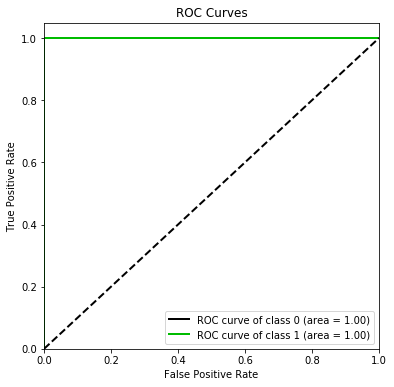

In [1100]:
clf_ex = RandomForestClassifier(n_estimators=400, criterion='entropy',\
                       oob_score=True, n_jobs=-1, random_state=42
                             , class_weight='balanced', max_features='sqrt')
# Defining the Parameter space
parameter_space = {'min_samples_leaf':[3], 
                   'n_estimators':[400]}
best_clf_ex = hyper_clf(clf_ex, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf_ex, Xtrain, Xtest, Ytrain, Ytest)

Training...done. (1.94s)
Predicting...done. (0.01s)
Temporary score = 1.0
Ovr_Score = 1.0
Temporary score = 1.0
Ovr_Score = 1.5
Temporary score = 1.0
Ovr_Score = 1.75
Statistic Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1661
           1       1.00      1.00      1.00       694

   micro avg       1.00      1.00      1.00      2355
   macro avg       1.00      1.00      1.00      2355
weighted avg       1.00      1.00      1.00      2355



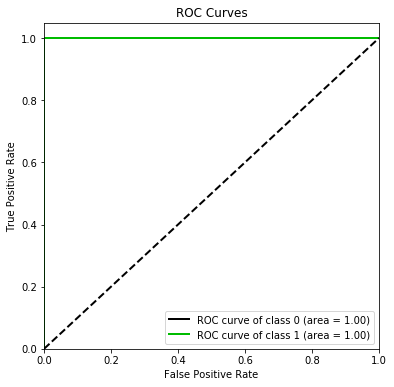

In [1081]:
#Classifiers 
clf_ex1 = GradientBoostingClassifier(n_estimators=300, learning_rate=1.0, max_depth=1, random_state=42)
# Defining the Parameter space
parameter_space = {'learning_rate':[0.1], 
                   'n_estimators':[300],
                  'max_depth':[1],
                  'min_samples_leaf':[2]}
best_clf_ex1 = hyper_clf(clf_ex1, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf_ex1, Xtrain, Xtest, Ytrain, Ytest)

Hyperparameter space search
Done. (11.93s)
Avg per sample: (11.93s)
Score: 0.7240123793919534
Parameters: {'metric': 'manhattan', 'n_neighbors': 8, 'p': 1, 'weights': 'distance'}
Training...done. (0.01s)
Predicting...done. (5.7s)
Temporary score = 0.7769894468802256
Ovr_Score = 0.7769894468802256
Temporary score = 0.7784456470805504
Ovr_Score = 1.1669403705206634
Temporary score = 0.77717269118323
Ovr_Score = 1.3606428764435616
Statistic Report:
              precision    recall  f1-score   support

           0       0.86      0.83      0.84      1661
           1       0.62      0.68      0.65       694

   micro avg       0.79      0.79      0.79      2355
   macro avg       0.74      0.75      0.75      2355
weighted avg       0.79      0.79      0.79      2355



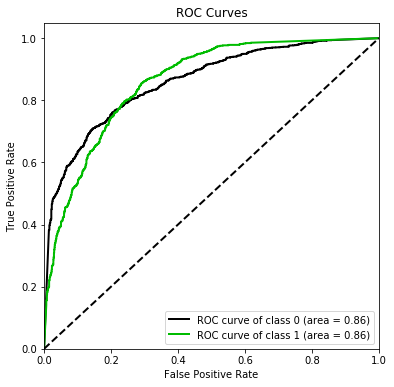

In [1080]:
# kNN
clf_ex2 =  KNeighborsClassifier(algorithm='auto')
parameter_space = {'n_neighbors':[8],
                   'weights':['distance'],
                   'p':[1], 
                   'metric':['manhattan']}
best_clf_ex2 = hyper_clf(clf_ex2, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf_ex2, Xtrain, Xtest, Ytrain, Ytest)

In [921]:
# Define the scaler 
scaler = StandardScaler().fit(Xtrain)

# Scale the train set
X_train_ex = scaler.transform(Xtrain)

# Scale the test set
X_test_ex = scaler.transform(Xtest)
# Initialize the constructor
clf_ex3 = Sequential()

# Add an input layer 
clf_ex3.add(Dense(30, activation='sigmoid', input_shape=(87,)))
clf_ex3.add(Dense(24, activation='sigmoid'))
# Add an output layer 
clf_ex3.add(Dense(2, activation='sigmoid'))
#  two key architecture decisions that you need to make to make your model: how many layers you’re going to use and how many “hidden units” you will chose for each layer.

clf_ex3.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
             metrics=['accuracy'])
time_start = time.time()
clf_ex3.fit(X_train_ex, Ytrain,epochs=20, batch_size=1, verbose=1)
time_fit = time.time() - time_start

Statistic Report:
              precision    recall  f1-score   support

           0       1.00      1.00      1.00      1661
           1       1.00      1.00      1.00       694

   micro avg       1.00      1.00      1.00      2355
   macro avg       1.00      1.00      1.00      2355
weighted avg       1.00      1.00      1.00      2355



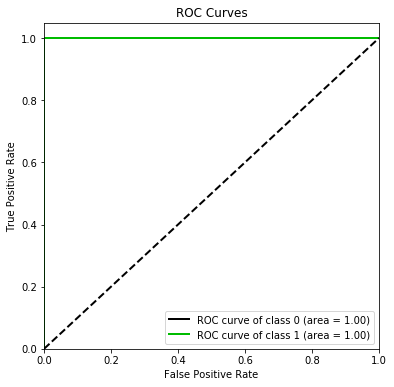

In [1105]:
time_start = time.time()
pred_p = clf_ex3.predict(X_test_ex)
time_predict = time.time() - time_start
# get array of class label where true = Sne
# pred = pred_p >=0.13 
# pred = pred.astype(int)
pred_p = pred_p.tolist()
pred = []
# to get prob values of each target
targets = [0,1]

for i in range(len(pred_p)):
    cell = pred_p[i]
    max_value = max(cell)
    max_index = cell.index(max_value)
    pred.append(max_index)
    pred_p[i] =[ cell[j] for j in targets]

score_nn(clf_ex3, Ytest, pred, pred_p)

In [1106]:
classifier_df_b2.sort_values(by='accuracy', ascending=False)

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
1,GradientBoostingClassifier,1.000000,1.000000,1.000000,1.000000,1.943723,0.007702,([DecisionTreeRegressor(criterion='friedman_ms...
3,Sequential,1.000000,1.000000,1.000000,1.000000,526.447944,0.285689,<keras.engine.sequential.Sequential object at ...
2,RandomForestClassifier,0.999151,0.999152,0.999151,0.999150,6.823992,0.718988,"(DecisionTreeClassifier(class_weight=None, cri..."
0,KNeighborsClassifier,0.785138,0.790932,0.785138,0.787538,0.013931,5.699345,"KNeighborsClassifier(algorithm='auto', leaf_si..."


In [ ]:
# full featureset - binary classification results in a Single graph
plot_roc([best_clf_b, best_clf_b1, best_clf_b2, clf_b3], Ytest, Xtest)

In [ ]:
# final featureset - binary classification results in a Single graph
plot_roc([best_clf_ex, best_clf_ex1, best_clf_ex2, clf_ex3], Ytest, Xtest)

### PCA test Final 

In [559]:
classifier_df_b_pca = pd.DataFrame(columns=['model_name','accuracy','avg_precision','avg_recall','avg_f1-score','time_fit','time_predict','classifier_parameters'])
classifier_df_b_pca

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters


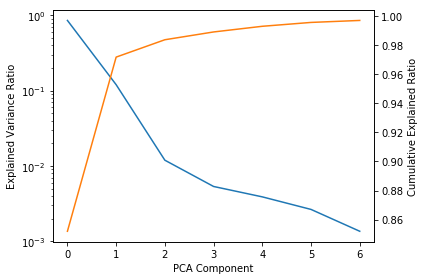

In [738]:
pca = PCA(n_components=7, whiten=True, svd_solver="full", random_state=42)
Xtrain_pca = pca.fit_transform(Xtrain)
Xtest_pca = pca.transform(Xtest)

# see where most of the information is being held
fig, ax = plt.subplots()
ax.plot(np.arange(7), pca.explained_variance_ratio_, color='C0')
ax2 = ax.twinx()
ax2.plot(np.arange(7), np.cumsum(pca.explained_variance_ratio_), color='C1')
ax.set_yscale('log')
ax.set_xlabel('PCA Component')
ax.set_ylabel('Explained Variance Ratio')
ax2.set_ylabel('Cumulative Explained Ratio')
fig.tight_layout()

Training...done. (4.21s)
Predicting...done. (0.51s)
Temporary score = 0.537055751359959
Ovr_Score = 0.537055751359959
Temporary score = 0.5623485233537515
Ovr_Score = 0.830876399033731
Temporary score = 0.5410704044759533
Ovr_Score = 0.9565086039928188
Temporary score = 0.5397611530957114
Ovr_Score = 1.0180154550921208
Statistic Report:
              precision    recall  f1-score   support

           0       0.85      0.86      0.86      1661
           1       0.66      0.65      0.65       694

   micro avg       0.80      0.80      0.80      2355
   macro avg       0.76      0.75      0.76      2355
weighted avg       0.80      0.80      0.80      2355



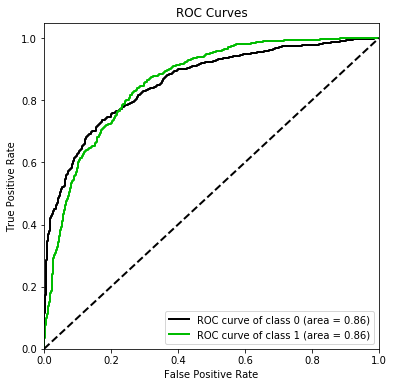

In [563]:
clf_b_pca1 = RandomForestClassifier(n_estimators=400, min_samples_leaf=3, criterion='entropy',\
                       oob_score=True, n_jobs=-1, random_state=42
                             , class_weight='balanced', max_features='sqrt')
score_pca(clf_b_pca1, Xtrain_pca, Xtest_pca, Ytrain, Ytest)

Training...done. (0.01s)
Predicting...done. (0.38s)
Temporary score = 0.5106414456807828
Ovr_Score = 0.5106414456807828
Temporary score = 0.5474233757845764
Ovr_Score = 0.8027440986249679
Temporary score = 0.5350564783683196
Ovr_Score = 0.9364285276808035
Temporary score = 0.520659883376405
Ovr_Score = 0.9888741472168068
Statistic Report:
              precision    recall  f1-score   support

           0       0.85      0.83      0.84      1661
           1       0.62      0.65      0.64       694

   micro avg       0.78      0.78      0.78      2355
   macro avg       0.74      0.74      0.74      2355
weighted avg       0.78      0.78      0.78      2355



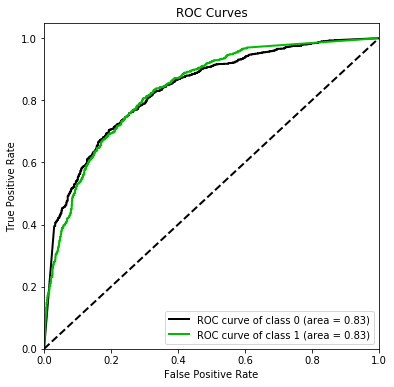

In [566]:
clf_b_pca2 =  KNeighborsClassifier(n_neighbors=8, weights='distance', p=1, metric='manhattan', algorithm='auto')
score_pca(clf_b_pca2, Xtrain_pca, Xtest_pca, Ytrain, Ytest)

In [571]:
# Define the scaler 
scaler = StandardScaler().fit(Xtrain_pca)

# Scale the train set
X_train_pca_ex = scaler.transform(Xtrain_pca)

# Scale the test set
X_test_pca_ex = scaler.transform(Xtest_pca)
# Initialize the constructor
clf_b_pca3 = Sequential()

# Add an input layer 
clf_b_pca3.add(Dense(7, activation='sigmoid', input_shape=(7,)))
clf_b_pca3.add(Dense(4, activation='sigmoid'))
# Add an output layer 
clf_b_pca3.add(Dense(2, activation='sigmoid'))
#  two key architecture decisions that you need to make to make your model: how many layers you’re going to use and how many “hidden units” you will chose for each layer.

clf_b_pca3.compile(loss='sparse_categorical_crossentropy',
              optimizer='adam',
             metrics=['accuracy'])
time_start = time.time()
clf_b_pca3.fit(X_train_pca_ex, Ytrain,epochs=20, batch_size=1, verbose=1)
time_fit = time.time() - time_start

Epoch 1/20
5493/5493 [==============================] - 28s 5ms/step - loss: 0.6058 - acc: 0.7053
Epoch 2/20
5493/5493 [==============================] - 25s 5ms/step - loss: 0.5941 - acc: 0.7053
Epoch 3/20
5493/5493 [==============================] - 25s 5ms/step - loss: 0.5806 - acc: 0.7053
Epoch 4/20
5493/5493 [==============================] - 27s 5ms/step - loss: 0.5665 - acc: 0.7045
Epoch 5/20
5493/5493 [==============================] - 27s 5ms/step - loss: 0.5559 - acc: 0.7034
Epoch 6/20
5493/5493 [==============================] - 25s 5ms/step - loss: 0.5458 - acc: 0.7031
Epoch 7/20
5493/5493 [==============================] - 25s 5ms/step - loss: 0.5383 - acc: 0.7014
Epoch 8/20
5493/5493 [==============================] - 30s 5ms/step - loss: 0.5326 - acc: 0.7038
Epoch 9/20
5493/5493 [==============================] - 24s 4ms/step - loss: 0.5292 - acc: 0.7067
Epoch 10/20
5493/5493 [==============================] - 25s 5ms/step - loss: 0.5255 - acc: 0.7131
Epoch 11/20
5493/54

Statistic Report:
              precision    recall  f1-score   support

           0       0.75      0.94      0.84      1661
           1       0.64      0.27      0.38       694

   micro avg       0.74      0.74      0.74      2355
   macro avg       0.70      0.60      0.61      2355
weighted avg       0.72      0.74      0.70      2355



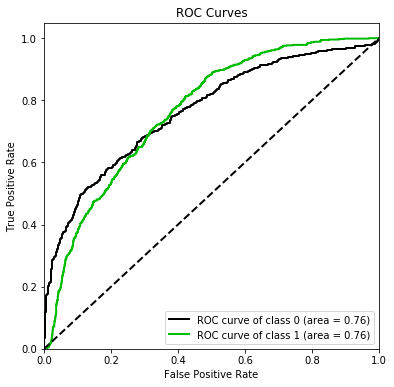

In [734]:
time_start = time.time()
pred_p = clf_b_pca3.predict(X_test_pca_ex)
time_predict = time.time() - time_start
# get array of class label where true = Sne
# pred = pred_p >=0.13 
# pred = pred.astype(int)
pred_p = pred_p.tolist()
pred = []
# to get prob values of each target
targets = [0,1]

for i in range(len(pred_p)):
    cell = pred_p[i]
    max_value = max(cell)
    max_index = cell.index(max_value)
    pred.append(max_index)
    pred_p[i] =[ cell[j] for j in targets]

score_nn(clf_b_pca3, Ytest, pred, pred_p)

In [736]:
classifier_df_b_pca.sort_values(by='accuracy', ascending=False)

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
0,RandomForestClassifier,0.798726,0.797424,0.798726,0.798035,4.208789,0.513412,"(DecisionTreeClassifier(class_weight=None, cri..."
1,KNeighborsClassifier,0.780042,0.783784,0.780042,0.781701,0.007189,0.377087,"KNeighborsClassifier(algorithm='auto', leaf_si..."
2,Sequential,0.740977,0.722166,0.740977,0.701846,526.168453,1.100631,<keras.engine.sequential.Sequential object at ...


### Combine Three Sne object class classifiers 

In [751]:
classifier_final = pd.DataFrame(columns=['model_name','accuracy','avg_precision','avg_recall','avg_f1-score','time_fit','time_predict','classifier_parameters'])
classifier_final

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters


In [ ]:
# - random forest(SneType1a)
best_clf_ex

Hyperparameter space search
Done. (35.19s)
Avg per sample: (35.19s)
Score: 0.8763881303477152
Parameters: {'min_samples_leaf': 3}
Training...done. (8.81s)
Predicting...done. (0.51s)
Temporary score = 0.8867652498900812
Ovr_Score = 0.8867652498900812
Temporary score = 0.8840313187135727
Ovr_Score = 1.3274139436586132
Temporary score = 0.8820303606221488
Ovr_Score = 1.5457373324514554
Statistic Report:
              precision    recall  f1-score   support

           0       0.91      0.96      0.93      1997
           1       0.69      0.44      0.54       358

   micro avg       0.88      0.88      0.88      2355
   macro avg       0.80      0.70      0.74      2355
weighted avg       0.87      0.88      0.87      2355



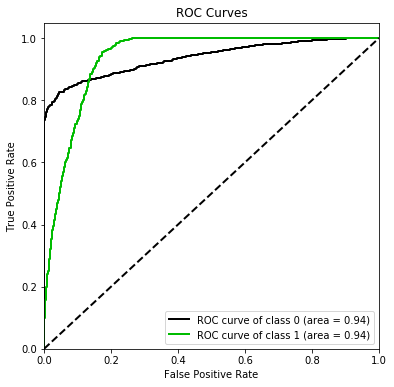

In [772]:
# SN2
clf_ex_2 = RandomForestClassifier(n_estimators=400, criterion='entropy',\
                       oob_score=True, n_jobs=-1, random_state=42
                             , class_weight='balanced', max_features='sqrt')
# Defining the Parameter space
parameter_space = {'min_samples_leaf':[3]}
best_clf_ex_2 = hyper_clf(clf_ex_2, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf_ex_2, Xtrain, Xtest, Ytrain, Ytest)

Hyperparameter space search
Done. (22.99s)
Avg per sample: (22.99s)
Score: 0.9401055889313672
Parameters: {'min_samples_leaf': 3}
Training...done. (6.83s)
Predicting...done. (0.41s)
Temporary score = 0.9428363371563808
Ovr_Score = 0.9428363371563808
Temporary score = 0.9415619879847078
Ovr_Score = 1.4129801565628983
Temporary score = 0.9415619879847078
Ovr_Score = 1.6480520662661569
Statistic Report:
              precision    recall  f1-score   support

           0       0.94      0.99      0.97      2210
           1       0.57      0.11      0.18       145

   micro avg       0.94      0.94      0.94      2355
   macro avg       0.76      0.55      0.58      2355
weighted avg       0.92      0.94      0.92      2355



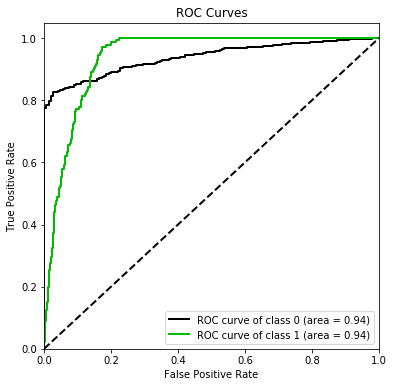

In [823]:
# SNIbc
clf_ex_3 = RandomForestClassifier(n_estimators=400, criterion='entropy',\
                       oob_score=True, n_jobs=-1, random_state=42
                             , class_weight='balanced', max_features='sqrt')
# Defining the Parameter space
parameter_space = {'min_samples_leaf':[3]}
best_clf_ex_3 = hyper_clf(clf_ex_3, Xtrain, Ytrain, parameter_space, n_folds=3)
score(best_clf_ex_3, Xtrain, Xtest, Ytrain, Ytest)

In [773]:
classifier_final

,model_name,accuracy,avg_precision,avg_recall,avg_f1-score,time_fit,time_predict,classifier_parameters
0,RandomForestClassifier,0.884926,0.873095,0.884926,0.874081,8.811832,0.509104,"(DecisionTreeClassifier(class_weight=None, cri..."


In [824]:
clfs_fin = [best_clf_ex, best_clf_ex_2, best_clf_ex_3]

In [831]:
all_pred, all_pred_proba = multi(clfs_fin, Xtest)

              precision    recall  f1-score   support

           0       0.49      1.00      0.66      1158
           1       0.00      0.00      0.00       694
           2       0.00      0.00      0.00       358
           3       0.00      0.00      0.00       145

   micro avg       0.49      0.49      0.49      2355
   macro avg       0.12      0.25      0.16      2355
weighted avg       0.24      0.49      0.32      2355



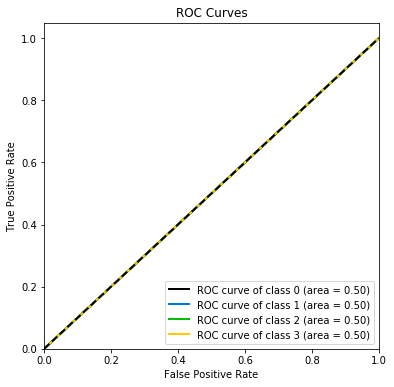

In [834]:
print(classification_report(Ytest, all_pred))
skplt.metrics.plot_roc(Ytest, all_pred_proba,plot_micro=False,plot_macro=False,figsize=(6,6))
plt.show()

### PCA AND DISTRIBUTION OF THE CLASSES

In [741]:
df_pca = pd.DataFrame(pca.transform(ex_df2.copy()), columns=['PCA%i' % i for i in range(7)], index=ex_df2.index)
df_pca['target'] = new_target.copy()

In [742]:
df_pca

,PCA0,PCA1,PCA2,PCA3,PCA4,PCA5,PCA6,target
0,-0.012359,-0.002728,0.049715,0.234931,0.220717,-0.184236,0.262939,0
1,-0.018349,-0.076666,-0.064162,-0.134141,-0.063748,0.092251,-0.140277,0
2,-0.018711,-0.073748,-0.064865,-0.135660,-0.067517,0.100014,-0.140682,0
3,-0.018317,-0.055099,-0.061816,-0.129792,-0.042854,0.040959,-0.151306,1
4,-0.018637,-0.062797,-0.065120,-0.135211,-0.066410,0.089081,-0.167254,1
5,-0.017030,-0.077073,-0.064360,-0.136043,-0.063559,0.098631,-0.140951,0
6,-0.012280,0.033934,-0.009903,-0.057145,0.156306,-0.355477,0.002293,1
7,-0.018721,-0.076074,-0.064836,-0.137165,-0.066615,0.100718,-0.137316,0
8,-0.018264,-0.053005,-0.058541,-0.130272,-0.035592,0.032894,-0.146042,1
9,-0.018632,-0.076300,-0.063785,-0.130494,-0.064249,0.091051,-0.143840,0


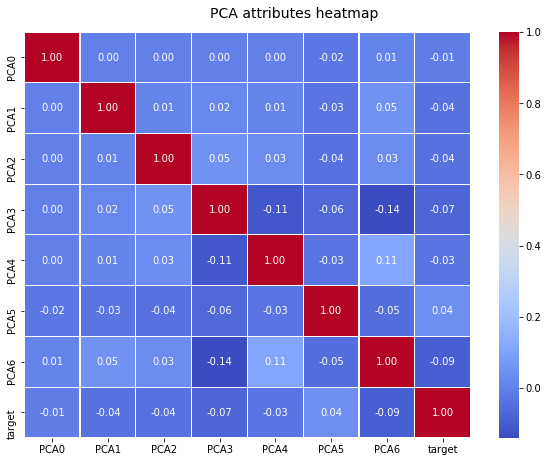

In [744]:
# pairwise correlation matrix 
f, ax = plt.subplots(figsize=(10, 7))
corr = df_pca.corr()
hm = sns.heatmap(round(corr,2), annot=True, ax=ax, cmap="coolwarm",fmt='.2f',
                 linewidths=.05)
f.subplots_adjust(top=0.93)
t= f.suptitle('PCA attributes heatmap', fontsize=14)

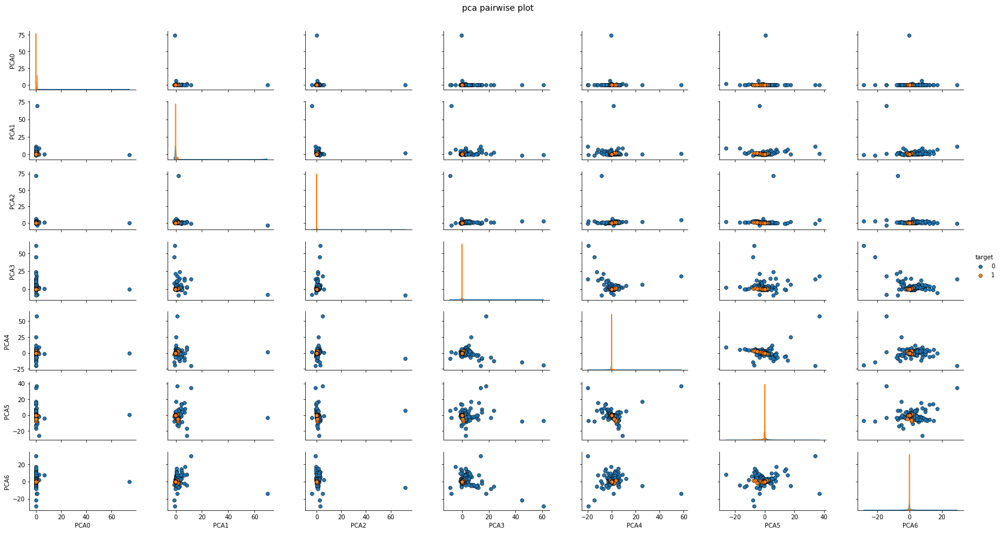

In [745]:
cols = ['PCA0', 'PCA1', 'PCA2', 'PCA3', 'PCA4', 'PCA5', 'PCA6', 'target']
pp = sns.pairplot(df_pca, x_vars = ['PCA0', 'PCA1', 'PCA2', 'PCA3', 'PCA4', 'PCA5', 'PCA6'], y_vars=['PCA0', 'PCA1', 'PCA2', 'PCA3', 'PCA4', 'PCA5', 'PCA6'], size=1.8, aspect=1.8,
                  plot_kws=dict(edgecolor="k", linewidth=0.5),
                  diag_kind="kde", diag_kws=dict(shade=True), hue = 'target')

fig = pp.fig 
fig.subplots_adjust(top=0.93, wspace=0.3)

t = fig.suptitle('pca pairwise plot', fontsize=14)

In [ ]:
# adding extra features and compression 
for i in range(len(t_feats)):
    t_feats['new_column'][i] = t_feats['amplitude_u'][i]
    
t_feats

End of implementation